<div class="alert alert-block alert-info" style="background-color: white; text-align: center;">
  <h1> BUSINESS CASE 2: Sales Forecast - Siemens </h1>
  <h2> Group E _ PART 1</h2>
    
  <p>  </p>
    
  <p> Business Cases for Data Science </p>
  <p> Masters in Data Science Spealization in Business Analytics - 2023/2024 </p>
    
  <p>  </p>
    
  <p><strong style="font-weight: bold;"> Group Members: </strong></p>
  <p> - Duarte Mendes 20230494 <p>
  <p> - Dzmitry Nisht 20230776 <p>
  <p> - Inês Silva 20201580 <p>
  <p> - José Marcal 20201581 <p>
  <p> - Ricardo Sousa 20201611 <p>
    
</div>

**Table of Contents** <br>
* [1. Notebook Setup: Packages and Module Loading](#1)
* [2. Data Understanding](#2)
    * [2.1. Organizing the Datasets](#2_1)
    * [2.2. Summary Satistics](#2_2)
    * [2.3. Visualizing Data](#2_3)
* [3. Data Preprocessing](#3)
    * [3.1. Changing Data Types](#3_1)
    * [3.2. Missing Values](#3_2)
    * [3.3. Feature Creation](#3_3)
    * [3.4. Removing Perfect Collinearity](#3_4)
    * [3.5. Outliers](#3_5)
    * [3.6. Feature Selection](#3_6)
* [4. Exploring the Datasets](#4)
* [5. Export Datasets](#5)

<hr>

<a class="anchor" id="1">

# 1. Notebook Setup: Packages and Module Loading

</a>

In [1]:
# Python version 3.11.4

# Preparing and working w/ dataframe
import pandas as pd #1.5.3
import numpy as np #1.26.4
import csv #1.0
import re #2.2.1
from datetime import datetime #(based on python sys)
import calendar #(based on python sys)

# Visualization
import matplotlib.pyplot as plt #3.7.1
import matplotlib.dates as mdates #3.7.1
import seaborn as sns #0.12.2
from colorama import Style #0.4.6

# Trends & Seasonlatity Analysis
from statsmodels.graphics.tsaplots import plot_acf #0.14.0
from statsmodels.tsa.stattools import adfuller #0.14.0
from statsmodels.tsa.seasonal import seasonal_decompose #0.14.0

# Preprocessing
from scipy.stats import shapiro #1.10.1
from xgboost import XGBRegressor #2.0.3

In [2]:
# Show all columns // from: https://builtin.com/data-science/pandas-show-all-columns
pd.set_option('display.max_columns', None)

In [3]:
# Remove warnings // from: https://stackoverflow.com/questions/14463277/how-to-disable-python-warnings
import warnings #based on python sys
warnings.filterwarnings("ignore")

In [4]:
with open('Case2_Sales data.csv', 'r') as file:
    
    csv_reader = csv.reader(file, delimiter=';')
    
    header = next(csv_reader)
    
    rows = [row for row in csv_reader]
    
file.close()

sales_data = pd.DataFrame(rows, columns=header)      

In [5]:
market_data = pd.read_excel("Case2_Market data.xlsx", header=None)

In [6]:
with open('Case2_Test Set Template.csv', 'r') as file:
    
    csv_reader_test = csv.reader(file, delimiter=';')
    
    header_test = next(csv_reader_test)
    
    rows_test = [row for row in csv_reader_test]
    
file.close()

test_set = pd.DataFrame(rows_test, columns=header_test)      

<hr>

<a class="anchor" id="2">

# 2. Data Understanding

</a>

<hr>

<a class="anchor" id="2_1">

## 2.1. Organizing the Datasets

</a>

#### - Sales dataset

In [7]:
# Rename columns
sales_data.rename({'ï»¿DATE':'Full_Date', 'Mapped_GCK':'GCK', 'Sales_EUR':'Sales €'}, axis=1, inplace=True)

# Remove '#' from product group code
#sales_data["GCK"] = sales_data["GCK"].str.replace(r'#(\d+)', r'\1', regex=True)

# Format data
sales_data['Full_Date'] = pd.to_datetime(sales_data['Full_Date'], format='%d.%m.%Y').dt.strftime('%d-%m-%Y')

# Format sales
sales_data["Sales €"] = sales_data["Sales €"].str.replace(",", ".").astype(float)

In [8]:
sales_data

,Full_Date,GCK,Sales €
0,01-10-2018,#1,0.00
1,02-10-2018,#1,0.00
2,03-10-2018,#1,0.00
3,04-10-2018,#1,0.00
4,05-10-2018,#1,0.00
...,...,...,...
9797,23-08-2019,#12,0.00
9798,23-08-2019,#36,1015.00
9799,12-08-2019,#12,0.00
9800,28-08-2019,#8,43763.91


#### - Market dataset

In [9]:
market_data.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47
0,NaN,China,China,France,France,Germany,Germany,Italy,Italy,Japan,Japan,Switzerland,Switzerland,United Kingdom,United Kingdom,United States,United States,Europe,Europe,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Producer Prices,Producer Prices,Producer Prices,Producer Prices,Producer Prices,Producer Prices,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index,production index
1,Index 2010=100 (if not otherwise noted),Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,Production Index Machinery & Electricals,Shipments Index Machinery & Electricals,World: Price of Base Metals,World: Price of Energy,World: Price of Metals & Minerals,World: Price of Natural gas index,"World: Price of Crude oil, average",World: Price of Copper,United States: EUR in LCU,United States: Electrical equipment,United Kingdom: Electrical equipment,Italy: Electrical equipment,France: Electrical equipment,Germany: Electrical equipment,China: Electrical equipment,United States: Machinery and equipment n.e.c.,World: Machinery and equipment n.e.c.,Switzerland: Machinery and equipment n.e.c.,United Kingdom: Machinery and equipment n.e.c.,Italy: Machinery and equipment n.e.c.,Japan: Machinery and equipment n.e.c.,France: Machinery and equipment n.e.c.,Germany: Machinery and equipment n.e.c.,United States: Electrical equipment,World: Electrical equipment,Switzerland: Electrical equipment,United Kingdom: Electrical equipment,Italy: Electrical equipment,Japan: Electrical equipment,France: Electrical equipment,Germany: Electrical equipment
2,date,MAB_ELE_PRO156,MAB_ELE_SHP156,MAB_ELE_PRO250,MAB_ELE_SHP250,MAB_ELE_PRO276,MAB_ELE_SHP276,MAB_ELE_PRO380,MAB_ELE_SHP380,MAB_ELE_PRO392,MAB_ELE_SHP392,MAB_ELE_PRO756,MAB_ELE_SHP756,MAB_ELE_PRO826,MAB_ELE_SHP826,MAB_ELE_PRO840,MAB_ELE_SHP840,MAB_ELE_PRO1100,MAB_ELE_SHP1100,RohiBASEMET1000_org,RohiENERGY1000_org,RohiMETMIN1000_org,RohiNATGAS1000_org,RohCRUDE_PETRO1000_org,RohCOPPER1000_org,WKLWEUR840_org,PRI27840_org,PRI27826_org,PRI27380_org,PRI27250_org,PRI27276_org,PRI27156_org,PRO28840_org,PRO281000_org,PRO28756_org,PRO28826_org,PRO28380_org,PRO28392_org,PRO28250_org,PRO28276_org,PRO27840_org,PRO271000_org,PRO27756_org,PRO27826_org,PRO27380_org,PRO27392_org,PRO27250_org,PRO27276_org
3,2004m2,16.940704,16.940704,112.091273,83.458866,82.623037,79.452532,124.289603,86.560493,109.33401,110.495272,91.221862,89.987275,111.353812,73.601265,107.6014,79.24023,97.122911,80.09853,54.039811,44.123338,48.747945,87.076974,39.639458,36.623832,1.2646,78.969864,80.757423,93.020027,NaN,93.230453,NaN,102.491722,97.597374,97.1,106.191977,116.790276,110.890034,118.274109,80.82901,117.723991,NaN,81.1,120.706516,141.510864,106.161262,102.077057,85.9132
4,2004m3,23.711852,23.711852,136.327976,106.168192,100.556582,97.012918,143.411662,106.344544,140.884616,144.686166,85.866287,79.883583,127.558608,84.047595,110.187364,98.619024,113.783904,96.015929,54.666162,47.588957,49.256157,87.192705,42.592034,39.931055,1.2262,79.673569,80.962135,93.540268,NaN,93.335678,NaN,105.62748,113.224892,91.195116,121.625075,139.288391,141.176853,148.121841,102.130104,1

* The first and second row have information of the header of the column, so joining those strings will result in a good name for the column
* Regarding the third row, no usefull information can be taken from that

In [10]:
# Load your data into a DataFrame

# Combine the headers from the first row with the names in the second row
new_headers = []
for header, name in zip(market_data.iloc[0], market_data.iloc[1]):
    if isinstance(header, str) and isinstance(name, str):
        new_headers.append(f'{header}_{name}')
    else:
        new_headers.append(name if isinstance(name, str) else '')

# Assign the new headers to the DataFrame
market_data.columns = new_headers

# Drop the first two rows as they are now redundant
market_data = market_data.drop([0, 1])

# Now df has the updated headers
market_data.rename( {'Index 2010=100 (if not otherwise noted)':'Month Year',
                     'China_Production Index Machinery & Electricals':'China Production Index M&E',
                     'China_Shipments Index Machinery & Electricals':'China Shipments Index M&E',
                     'France_Production Index Machinery & Electricals':'France Production Index M&E',
                     'France_Shipments Index Machinery & Electricals':'France Shipments Index M&E',
                     'Germany_Production Index Machinery & Electricals':'Germany Production Index M&E',
                     'Germany_Shipments Index Machinery & Electricals':'Germany Shipments Index M&E',
                     'Italy_Production Index Machinery & Electricals':'Italy Production Index M&E',
                     'Italy_Shipments Index Machinery & Electricals':'Italy Shipments Index M&E',
                     'Japan_Production Index Machinery & Electricals':'Japan Production Index M&E',
                     'Japan_Shipments Index Machinery & Electricals':'Japan Shipments Index M&E',
                     'Switzerland_Production Index Machinery & Electricals':'Switzerland Production Index M&E',
                     'Switzerland_Shipments Index Machinery & Electricals':'Switzerland Shipments Index M&E',
                     'United Kingdom_Production Index Machinery & Electricals':'UK Production Index M&E',
                     'United Kingdom_Shipments Index Machinery & Electricals':'UK Shipments Index M&E',
                     'United States_Production Index Machinery & Electricals':'US Production Index M&E',
                     'United States_Shipments Index Machinery & Electricals':'US Shipments Index M&E',
                     'Europe_Production Index Machinery & Electricals':'Europe Production Index M&E',
                     'Europe_Shipments Index Machinery & Electricals':'Europe Shipments Index M&E',
                     'World: Price of Base Metals':'Price of Base Metals',
                     'World: Price of Energy':'Price of Energy',
                     'World: Price of Metals  & Minerals':'Price of Metals & Minerals',
                     'World: Price of Natural gas index':'Price of Natural gas index',
                     'World: Price of Crude oil, average':'Price of Crude oil (AVG)',
                     'World: Price of Copper':'Price of Copper',
                     'Producer Prices_United States: Electrical equipment':'US Producer Prices Electrical eq.',
                     'Producer Prices_United Kingdom: Electrical equipment':'UK Producer Prices Electrical eq.',
                     'Producer Prices_Italy: Electrical equipment':'Italy Producer Prices Electrical eq.',
                     'Producer Prices_France: Electrical equipment':'France Producer Prices Electrical eq.',
                     'Producer Prices_Germany: Electrical equipment':'Germany Producer Prices Electrical eq.',
                     'Producer Prices_China: Electrical equipment':'China Producer Prices Electrical eq.',
                     'production index_United States: Machinery and equipment n.e.c.':'US Production Index Machinery eq.',
                     'production index_World: Machinery and equipment n.e.c.':'Global Production Index Machinery eq.',
                     'production index_Switzerland: Machinery and equipment n.e.c.':'Switzerland Production Index Machinery eq.',
                     'production index_United Kingdom: Machinery and equipment n.e.c.':'UK Production Index Machinery eq.',
                     'production index_Italy: Machinery and equipment n.e.c.':'Italy Production Index Machinery eq.',
                     'production index_Japan: Machinery and equipment n.e.c.':'Japan Production Index Machinery eq.',
                     'production index_France: Machinery and equipment n.e.c.':'France Production Index Machinery eq.',
                     'production index_Germany: Machinery and equipment n.e.c.':'Germany Production Index Machinery eq.',
                     'production index_United States: Electrical equipment':'US Production Index Electrical eq.',
                     'production index_World: Electrical equipment':'Global Production Index Electrical eq.',
                     'production index_Switzerland: Electrical equipment':'Switzerland Production Index Electrical eq.',
                     'production index_United Kingdom: Electrical equipment':'UK Production Index Electrical eq.',
                     'production index_Italy: Electrical equipment':'Italy Production Index Electrical eq.',
                     'production index_Japan: Electrical equipment':'Japan Production Index Electrical eq.',
                     'production index_France: Electrical equipment':'France Production Index Electrical eq.',
                     'production index_Germany: Electrical equipment':'Germany Production Index Electrical eq.',
                    }, axis=1, inplace=True )

market_data = market_data.drop(market_data.index[0]).reset_index(drop=True)

* We believed it would be easier to understand the columns with clearer names

In [11]:
# Splitting the column into year and month
market_data[['year', 'month']] = market_data['Month Year'].str.split('m', expand=True)

# Converting year and month to datetime
market_data['Month Year'] = pd.to_datetime(market_data['year'] + ' ' + market_data['month'], format='%Y-%m')

# Formatting datetime to Month Year
market_data['Month Year'] = market_data['Month Year'].dt.strftime('%b %Y')

# Dropping intermediate columns if needed
market_data.drop(columns=['year', 'month'], inplace=True)

In [12]:
# Define the list of columns to convert to float

# Convert columns to float
market_data.iloc[:, 1:] = market_data.iloc[:, 1:].astype(float)

# Output the result
market_data.head()


,Month Year,China Production Index M&E,China Shipments Index M&E,France Production Index M&E,France Shipments Index M&E,Germany Production Index M&E,Germany Shipments Index M&E,Italy Production Index M&E,Italy Shipments Index M&E,Japan Production Index M&E,Japan Shipments Index M&E,Switzerland Production Index M&E,Switzerland Shipments Index M&E,UK Production Index M&E,UK Shipments Index M&E,US Production Index M&E,US Shipments Index M&E,Europe Production Index M&E,Europe Shipments Index M&E,Price of Base Metals,Price of Energy,Price of Metals & Minerals,Price of Natural gas index,Price of Crude oil (AVG),Price of Copper,United States: EUR in LCU,US Producer Prices Electrical eq.,UK Producer Prices Electrical eq.,Italy Producer Prices Electrical eq.,France Producer Prices Electrical eq.,Germany Producer Prices Electrical eq.,China Producer Prices Electrical eq.,US Production Index Machinery eq.,Global Production Index Machinery eq.,Switzerland Production Index Machinery eq.,UK Production Index Machinery eq.,Italy Production Index Machinery eq.,Japan Production Index Machinery eq.,France Production Index Machinery eq.,Germany Production Index Machinery eq.,US Production Index Electrical eq.,Global Production Index Electrical eq.,Switzerland Production Index Electrical eq.,UK Production Index Electrical eq.,Italy Production Index Electrical eq.,Japan Production Index Electrical eq.,France Production Index Electrical eq.,Germany Production Index Electrical eq.
0,Feb 2004,16.940704,16.940704,112.091273,83.458866,82.623037,79.452532,124.289603,86.560493,109.334010,110.495272,91.221862,89.987275,111.353812,73.601265,107.601400,79.240230,97.122911,80.098530,54.039811,44.123338,48.747945,87.076974,39.639458,36.623832,1.2646,78.969864,80.757423,93.020027,NaN,93.230453,NaN,102.491722,97.597374,97.100000,106.191977,116.790276,110.890034,118.274109,80.829010,117.723991,NaN,81.100000,120.706516,141.510864,106.161262,102.077057,85.913200
1,Mar 2004,23.711852,23.711852,136.327976,106.168192,100.556582,97.012918,143.411662,106.344544,140.884616,144.686166,85.866287,79.883583,127.558608,84.047595,110.187364,98.619024,113.783904,96.015929,54.666162,47.588957,49.256157,87.192705,42.592034,39.931055,1.2262,79.673569,80.962135,93.540268,NaN,93.335678,NaN,105.627480,113.224892,91.195116,121.625075,139.288391,141.176853,148.121841,102.130104,119.220779,NaN,76.690307,138.309550,152.880234,140.288741,117.225685,97.670815
2,Apr 2004,24.435235,24.435235,117.791806,92.007646,89.653203,84.932358,129.083828,95.579673,105.853579,102.655769,85.622508,79.740802,108.732297,73.026027,108.166564,89.774031,101.715199,85.167236,54.872715,47.779013,49.423751,91.379923,42.650637,39.134854,1.1985,80.337639,80.757423,93.852425,NaN,93.440903,NaN,103.484955,100.169090,93.793535,104.965505,125.289566,105.648765,125.482231,90.961426,117.441124,NaN,71.552403,115.557330,137.796875,106.271197,105.335777,87.253983
3,May 2004,23.708115,23.708115,109.002541,85.696486,86.880571,82.372794,135.590391,100.087039,101.864777,100.305285,85.378729,79.598021,110.645200,74.591883,108.425887,87.463813,101.275727,84.485767,51.230356,53.590898,46.468392,99.044520,47.517121,36.278433,1.2007,80.798828,80.757423,93.852425,NaN,93.546127,NaN,103.643944,99.581436,96.391954,105.885359,131.988998,101.990361,116.649750,88.082901,117.899216,NaN,66.414500,119.269534,143.860535,101.608710,96.616508,84.675552
4,Jun 2004,27.009138,27.009138,133.785737,106.641482,99.010814,95.108740,136.424935,110.889719,120.332920,119.616380,85.134950,79.455239,122.020960,82.343346,110.569933,97.364496,112.057197,96.963294,52.876331,50.799575,47.803913,98.636267,44.967605,35.657380,1.2138,80.913490,80.552711,93.956467,NaN,93.440903,NaN,106.062668,109.277710,98.990373,118.252278,132.988922,122.136575,143.248734,100.978699,119.499107,NaN,61.276596,128.849416,144.315308,116.655248,118.458710,95.401802


<hr>

<a class="anchor" id="2_2">

## 2.2. Summary Statistics

</a>

### - Sales Dataset

In [13]:
sales_data.head(5)

,Full_Date,GCK,Sales €
0,01-10-2018,#1,0.0
1,02-10-2018,#1,0.0
2,03-10-2018,#1,0.0
3,04-10-2018,#1,0.0
4,05-10-2018,#1,0.0


In [14]:
sales_data.tail(10)

,Full_Date,GCK,Sales €
9792,24-08-2019,#14,0.00
9793,21-08-2019,#20,0.00
9794,28-08-2019,#12,0.00
9795,23-08-2019,#13,3000.00
9796,28-08-2019,#14,1602.00
9797,23-08-2019,#12,0.00
9798,23-08-2019,#36,1015.00
9799,12-08-2019,#12,0.00
9800,28-08-2019,#8,43763.91
9801,27-08-2019,#8,0.00


* data ranging from 1-10-2018 to 27-08-2019

In [15]:
sales_data.isna().sum() / len(sales_data) * 100

Full_Date    0.0
GCK          0.0
Sales €      0.0
dtype: float64

In [16]:
sales_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9802 entries, 0 to 9801
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Full_Date  9802 non-null   object 
 1   GCK        9802 non-null   object 
 2   Sales €    9802 non-null   float64
dtypes: float64(1), object(2)
memory usage: 229.9+ KB


In [17]:
sales_data.describe(include='all')

,Full_Date,GCK,Sales €
count,9802,9802,9.802000e+03
unique,1216,14,NaN
top,16-04-2021,#1,NaN
freq,14,1179,NaN
mean,NaN,NaN,2.727857e+05
std,NaN,NaN,2.230789e+06
min,NaN,NaN,-5.063812e+05
25%,NaN,NaN,0.000000e+00
50%,NaN,NaN,0.000000e+00
75%,NaN,NaN,0.000000e+00


* Some negative values due to returns

In [18]:
sales_data["GCK"].unique()

array(['#1', '#11', '#6', '#8', '#12', '#16', '#4', '#5', '#3', '#9',
       '#14', '#13', '#20', '#36'], dtype=object)

* We have 14 different products

### - Market Dataset

In [19]:
market_data.head()

,Month Year,China Production Index M&E,China Shipments Index M&E,France Production Index M&E,France Shipments Index M&E,Germany Production Index M&E,Germany Shipments Index M&E,Italy Production Index M&E,Italy Shipments Index M&E,Japan Production Index M&E,Japan Shipments Index M&E,Switzerland Production Index M&E,Switzerland Shipments Index M&E,UK Production Index M&E,UK Shipments Index M&E,US Production Index M&E,US Shipments Index M&E,Europe Production Index M&E,Europe Shipments Index M&E,Price of Base Metals,Price of Energy,Price of Metals & Minerals,Price of Natural gas index,Price of Crude oil (AVG),Price of Copper,United States: EUR in LCU,US Producer Prices Electrical eq.,UK Producer Prices Electrical eq.,Italy Producer Prices Electrical eq.,France Producer Prices Electrical eq.,Germany Producer Prices Electrical eq.,China Producer Prices Electrical eq.,US Production Index Machinery eq.,Global Production Index Machinery eq.,Switzerland Production Index Machinery eq.,UK Production Index Machinery eq.,Italy Production Index Machinery eq.,Japan Production Index Machinery eq.,France Production Index Machinery eq.,Germany Production Index Machinery eq.,US Production Index Electrical eq.,Global Production Index Electrical eq.,Switzerland Production Index Electrical eq.,UK Production Index Electrical eq.,Italy Production Index Electrical eq.,Japan Production Index Electrical eq.,France Production Index Electrical eq.,Germany Production Index Electrical eq.
0,Feb 2004,16.940704,16.940704,112.091273,83.458866,82.623037,79.452532,124.289603,86.560493,109.334010,110.495272,91.221862,89.987275,111.353812,73.601265,107.601400,79.240230,97.122911,80.098530,54.039811,44.123338,48.747945,87.076974,39.639458,36.623832,1.2646,78.969864,80.757423,93.020027,NaN,93.230453,NaN,102.491722,97.597374,97.100000,106.191977,116.790276,110.890034,118.274109,80.829010,117.723991,NaN,81.100000,120.706516,141.510864,106.161262,102.077057,85.913200
1,Mar 2004,23.711852,23.711852,136.327976,106.168192,100.556582,97.012918,143.411662,106.344544,140.884616,144.686166,85.866287,79.883583,127.558608,84.047595,110.187364,98.619024,113.783904,96.015929,54.666162,47.588957,49.256157,87.192705,42.592034,39.931055,1.2262,79.673569,80.962135,93.540268,NaN,93.335678,NaN,105.627480,113.224892,91.195116,121.625075,139.288391,141.176853,148.121841,102.130104,119.220779,NaN,76.690307,138.309550,152.880234,140.288741,117.225685,97.670815
2,Apr 2004,24.435235,24.435235,117.791806,92.007646,89.653203,84.932358,129.083828,95.579673,105.853579,102.655769,85.622508,79.740802,108.732297,73.026027,108.166564,89.774031,101.715199,85.167236,54.872715,47.779013,49.423751,91.379923,42.650637,39.134854,1.1985,80.337639,80.757423,93.852425,NaN,93.440903,NaN,103.484955,100.169090,93.793535,104.965505,125.289566,105.648765,125.482231,90.961426,117.441124,NaN,71.552403,115.557330,137.796875,106.271197,105.335777,87.253983
3,May 2004,23.708115,23.708115,109.002541,85.696486,86.880571,82.372794,135.590391,100.087039,101.864777,100.305285,85.378729,79.598021,110.645200,74.591883,108.425887,87.463813,101.275727,84.485767,51.230356,53.590898,46.468392,99.044520,47.517121,36.278433,1.2007,80.798828,80.757423,93.852425,NaN,93.546127,NaN,103.643944,99.581436,96.391954,105.885359,131.988998,101.990361,116.649750,88.082901,117.899216,NaN,66.414500,119.269534,143.860535,101.608710,96.616508,84.675552
4,Jun 2004,27.009138,27.009138,133.785737,106.641482,99.010814,95.108740,136.424935,110.889719,120.332920,119.616380,85.134950,79.455239,122.020960,82.343346,110.569933,97.364496,112.057197,96.963294,52.876331,50.799575,47.803913,98.636267,44.967605,35.657380,1.2138,80.913490,80.552711,93.956467,NaN,93.440903,NaN,106.062668,109.277710,98.990373,118.252278,132.988922,122.136575,143.248734,100.978699,119.499107,NaN,61.276596,128.849416,144.315308,116.655248,118.458710,95.401802


In [20]:
market_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 48 columns):
 #   Column                                       Non-Null Count  Dtype  
---  ------                                       --------------  -----  
 0   Month Year                                   219 non-null    object 
 1   China Production Index M&E                   219 non-null    float64
 2   China Shipments Index M&E                    219 non-null    float64
 3   France Production Index M&E                  219 non-null    float64
 4   France Shipments Index M&E                   219 non-null    float64
 5   Germany Production Index M&E                 219 non-null    float64
 6   Germany Shipments Index M&E                  219 non-null    float64
 7   Italy Production Index M&E                   219 non-null    float64
 8   Italy Shipments Index M&E                    219 non-null    float64
 9   Japan Production Index M&E                   219 non-null    float64
 10  Ja

In [21]:
market_data.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Month Year,219,219,Feb 2004,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
China Production Index M&E,219.0,NaN,NaN,NaN,138.303637,78.883209,16.940704,68.47774,133.50769,198.473934,329.413367
China Shipments Index M&E,219.0,NaN,NaN,NaN,138.303637,78.883209,16.940704,68.47774,133.50769,198.473934,329.413367
France Production Index M&E,219.0,NaN,NaN,NaN,104.431918,18.918529,50.75668,93.613505,102.736556,114.090851,152.743402
France Shipments Index M&E,219.0,NaN,NaN,NaN,105.316814,12.762209,64.420676,97.452819,106.012166,115.030479,136.85872
Germany Production Index M&E,219.0,NaN,NaN,NaN,107.499126,11.861942,74.332913,100.560897,108.99229,115.735786,130.869962
Germany Shipments Index M&E,219.0,NaN,NaN,NaN,114.898377,17.091571,71.787161,103.149778,117.428836,127.11222,151.297092
Italy Production Index M&E,219.0,NaN,NaN,NaN,105.228363,23.509638,34.213427,94.335162,105.088474,117.031701,153.940791
Italy Shipments Index M&E,219.0,NaN,NaN,NaN,105.735378,19.948183,45.19171,95.985839,107.695805,119.83636,153.645142
Japan Production Index M&E,219.0,NaN,NaN,NaN,111.948146,15.489336,67.53194,103.740049,111.683015,121.402653,153.898678


<hr>

<a class="anchor" id="2_3">

## 2.3. Visualizing Data

</a>

In [22]:
sales_viz = sales_data.copy()

**COLORS**

In [23]:
# Define a list of colors for each product
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', 
          '#7f7f7f', '#bcbd22', '#17becf', '#aec7e8', '#ffbb78', '#98df8a', '#ff9896']

# Define color map for each product
color_map = {
    1: '#1f77b4',  # Blue
    11: '#ff7f0e',  # Orange
    12: '#2ca02c',  # Green
    13: '#d62728',  # Red
    14: '#9467bd',  # Purple
    16: '#8c564b',  # Brown
    20: '#e377c2',  # Pink
    3: '#7f7f7f',  # Gray
    36: '#bcbd22',  # Olive
    4: '#17becf',  # Cyan
    5: '#aec7e8',  # Light Blue
    6: '#ffbb78',  # Light Orange
    8: '#98df8a',  # Light Green
    9: '#ff9896'   # light Pink
}

### - Sales Dataset

**TOTAL SALES**

In [24]:
round(sum(sales_viz["Sales €"]),2)

2673845300.67

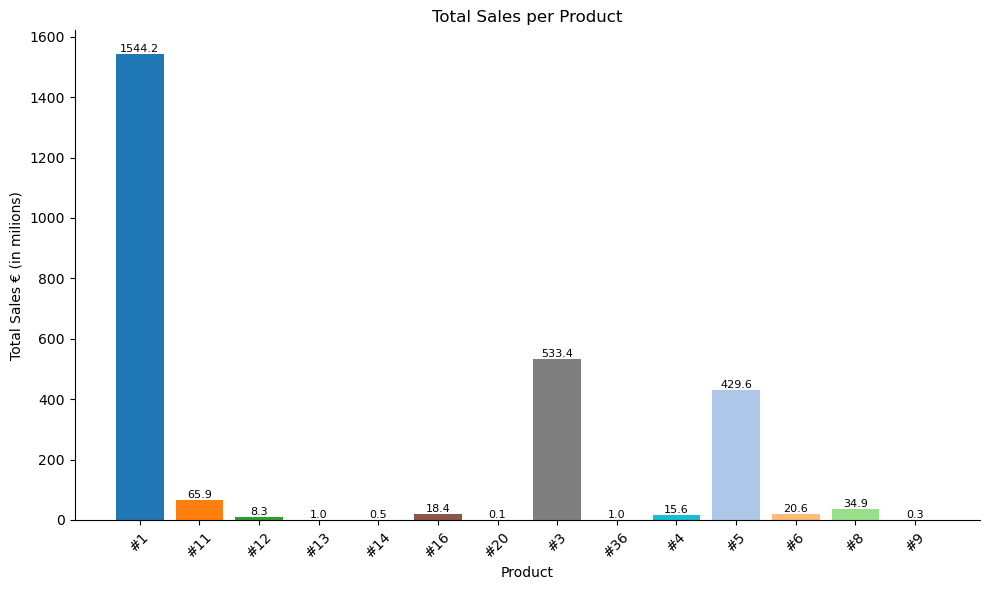

In [25]:
# Group by 'GCK' (product) and sum the sales
total_sales_per_product = sales_viz.groupby('GCK').sum()['Sales €']

# Plot
plt.figure(figsize=(10, 6))
bars = plt.bar(total_sales_per_product.index, total_sales_per_product/1000000, color=colors[:len(total_sales_per_product)])

# add value labels
for bar in bars:
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height, f'{height:.1f}', ha='center', va='bottom', fontsize=8)


# Details
plt.title('Total Sales per Product')
plt.xlabel('Product')
plt.xticks(rotation=45)
plt.ylabel('Total Sales € (in milions)')
plt.grid(axis='y', alpha=0.3)
    
# Decoration
plt.grid(False)
plt.tight_layout()
sns.despine()
plt.show()


**SALES PER MONTH**

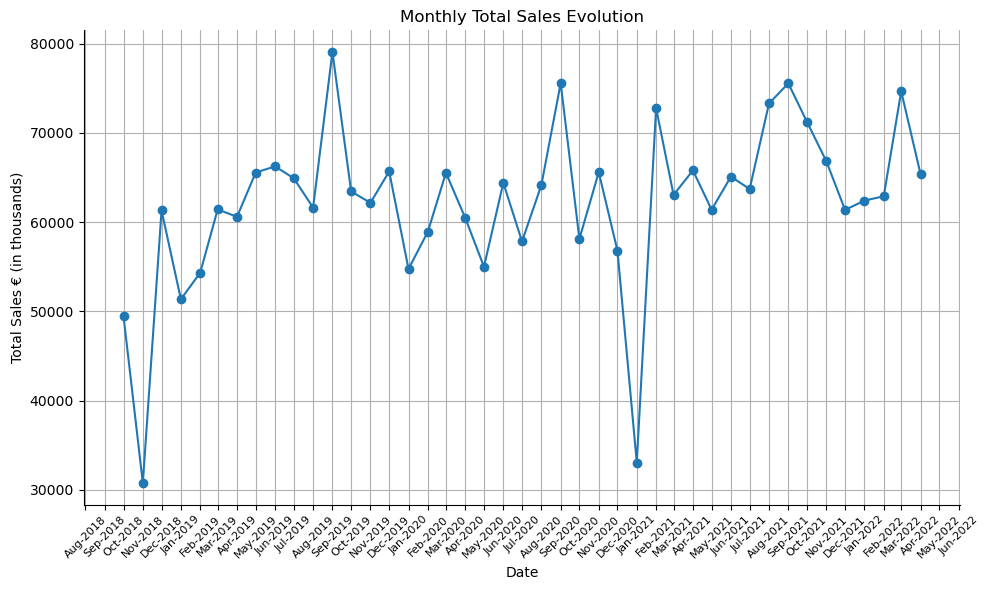

In [26]:
# Convert 'Full_Date' column to datetime
sales_viz['Full_Date'] = pd.to_datetime(sales_viz['Full_Date'], format='%d-%m-%Y')

# Group by both 'Full_Date' (month) and 'GCK' (product), and sum the sales
monthly_total_sales = sales_viz.groupby(sales_viz['Full_Date'].dt.to_period('M')).sum()

# Plot the total monthly sales data
plt.figure(figsize=(10, 6))
plt.plot(monthly_total_sales.index.to_timestamp(), monthly_total_sales["Sales €"]/1000, marker='o', linestyle='-')

# Details
plt.title('Monthly Total Sales Evolution')
plt.xlabel('Date')
plt.ylabel('Total Sales € (in thousands)')

# Label settings
plt.xticks(rotation=45)
plt.tick_params(axis='x', which='major', labelsize=8)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b-%Y'))
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=1))

# Decoration
plt.grid(True)
plt.tight_layout()
sns.despine()
plt.show()


In [27]:
def plot_monthly_product_sales(sales_viz, product_number, color_map):
    # Filter data for the specified product number
    product_sales = sales_viz[sales_viz['GCK'] == f'#{product_number}']

    # Group by 'Full_Date' (month) and sum the sales
    monthly_product_sales = product_sales.groupby(product_sales['Full_Date'].dt.to_period('M')).sum()

    # Plot
    plt.figure(figsize=(10, 6))
    plt.plot(monthly_product_sales.index.to_timestamp(), monthly_product_sales["Sales €"]/1000, marker='o', linestyle='-', color=color_map.get(product_number, 'blue'))  # Use color from color_map, defaulting to 'blue' if not found
    
    # Details
    plt.title(f'Monthly Total Sales Evolution for Product #{product_number}')
    plt.xlabel('Date')
    plt.ylabel('Total Sales € (in thousands)')
    
    # Label settings
    plt.xticks(rotation=45)
    plt.tick_params(axis='x', which='major', labelsize=8)
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b-%Y'))
    plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=1))
    
    # Decorations
    plt.grid(alpha=0.3) 
    plt.tight_layout()
    sns.despine()
    plt.show()

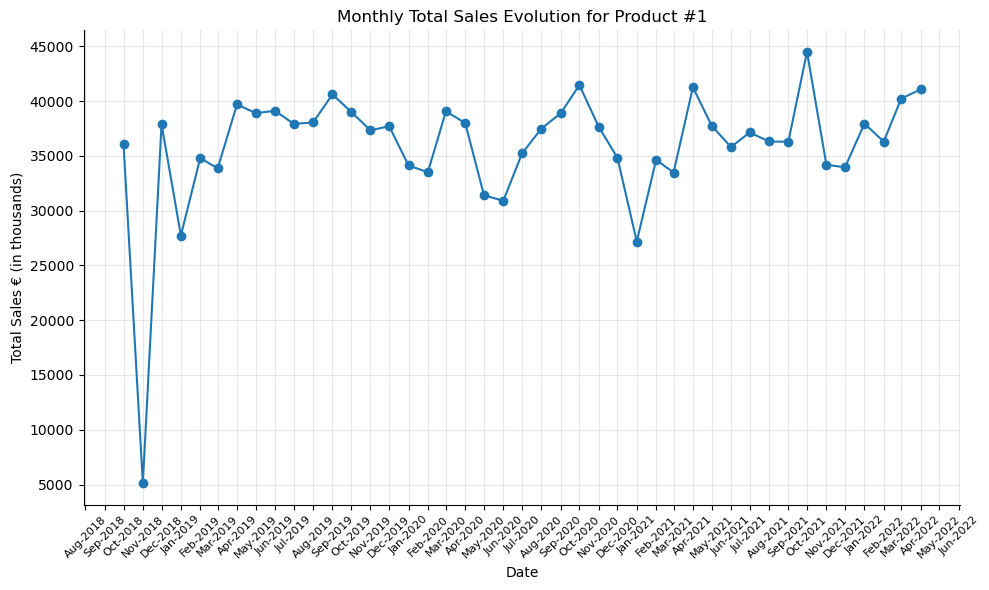

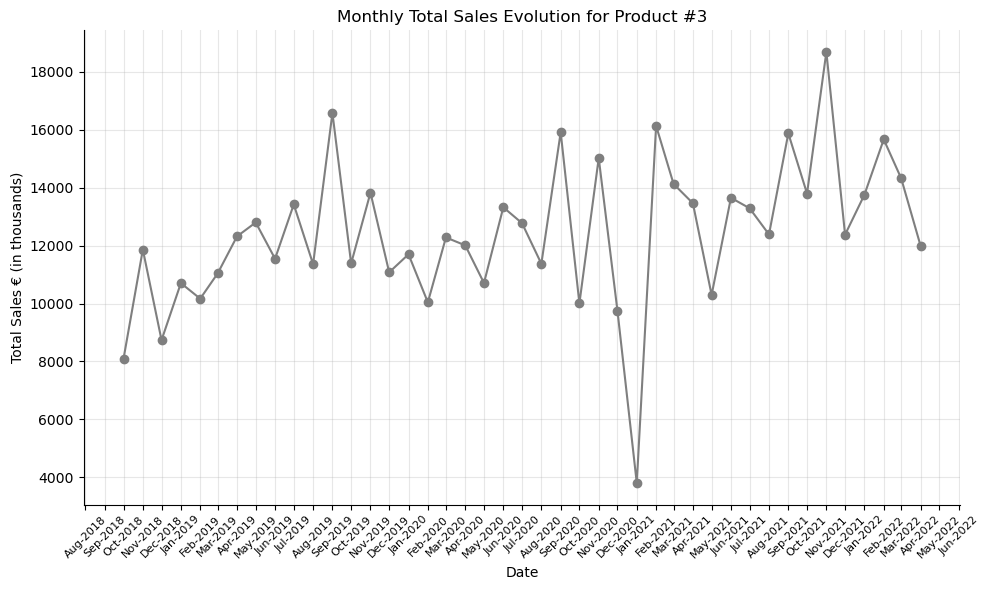

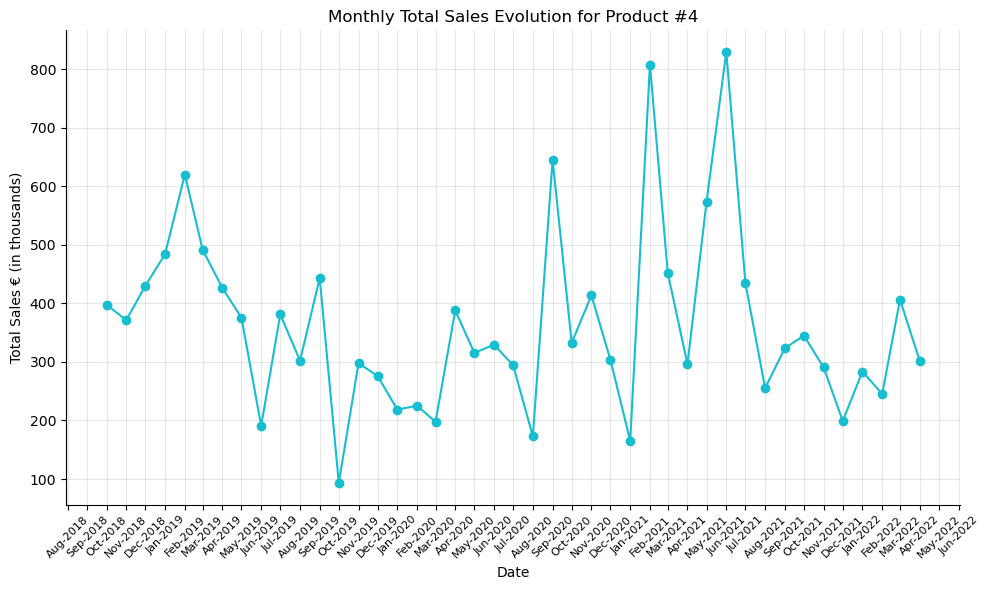

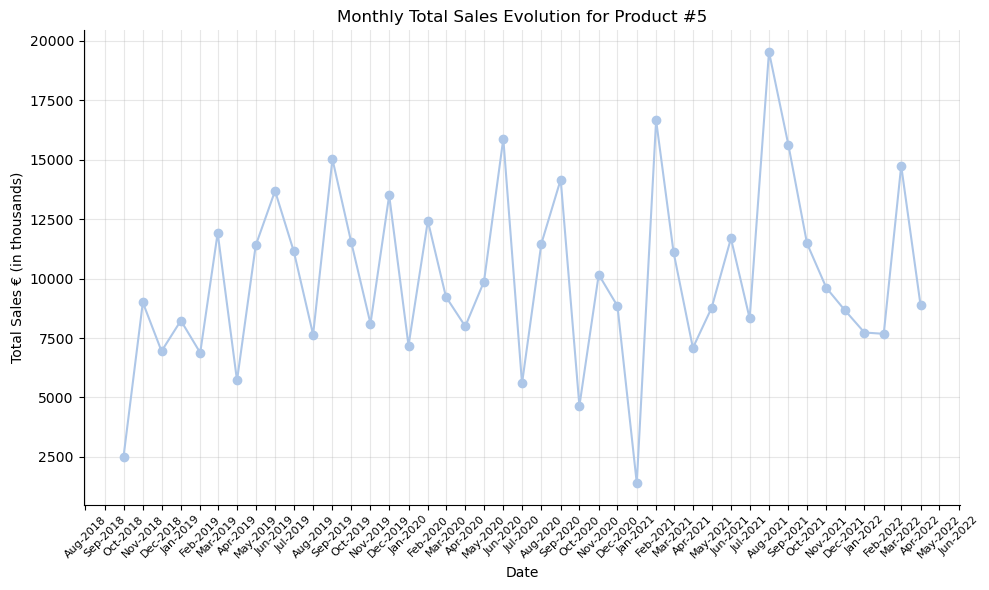

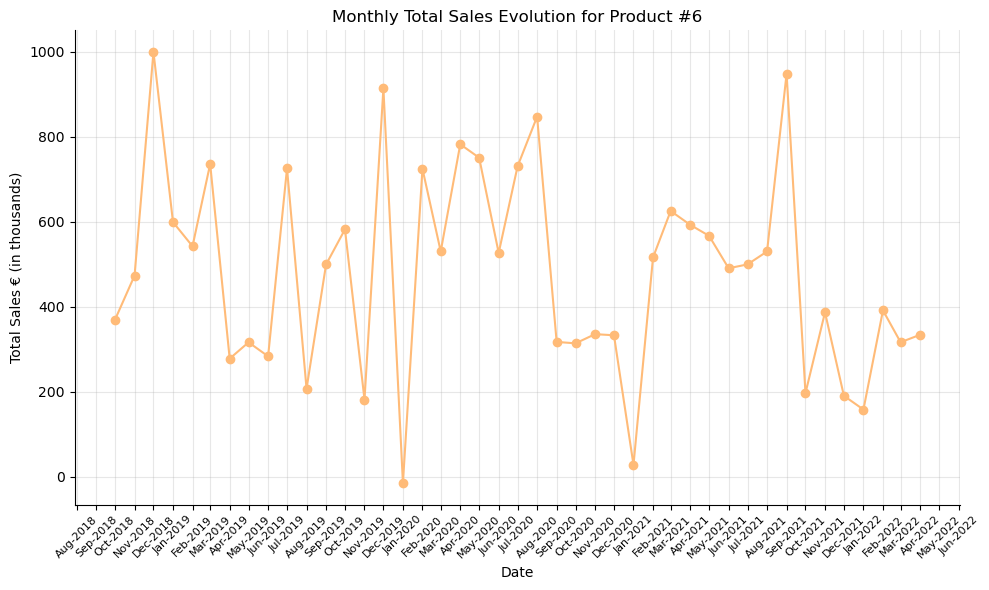

...

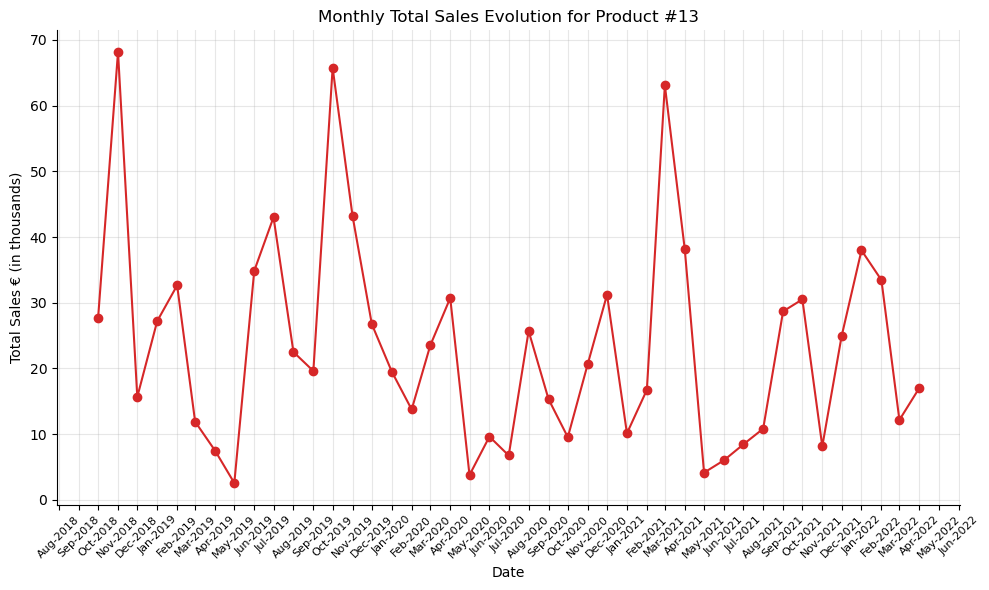

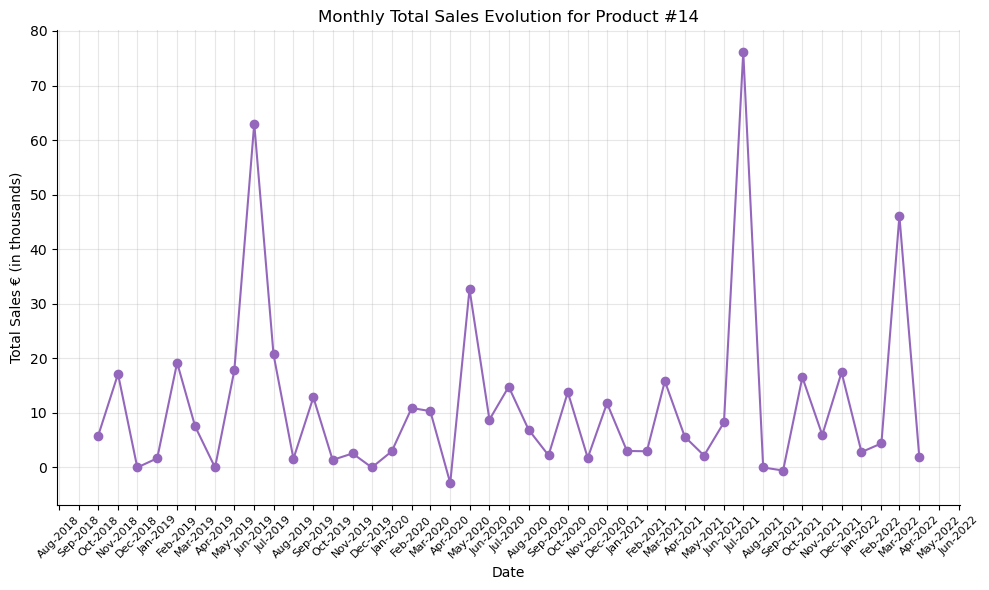

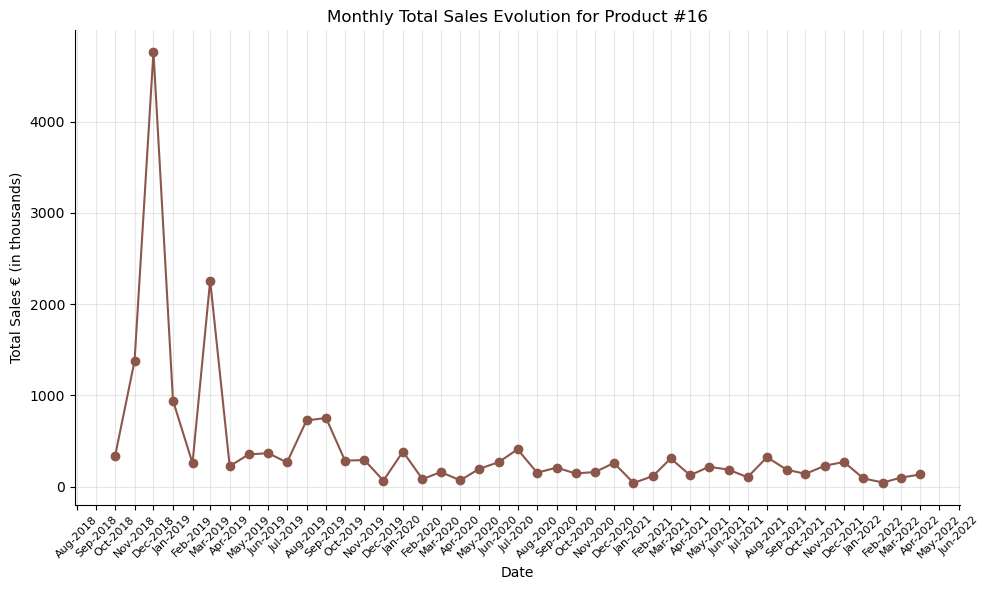

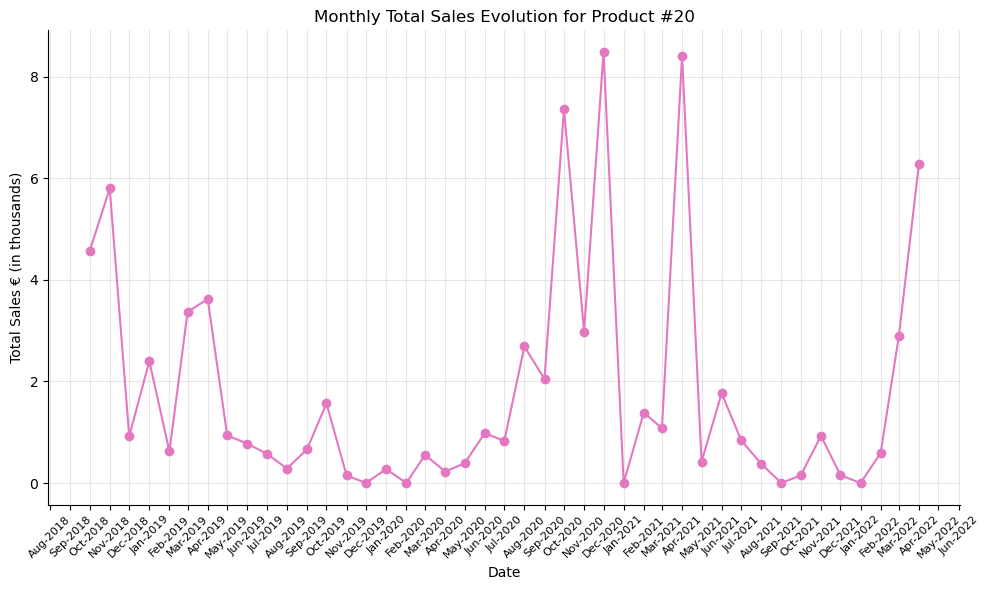

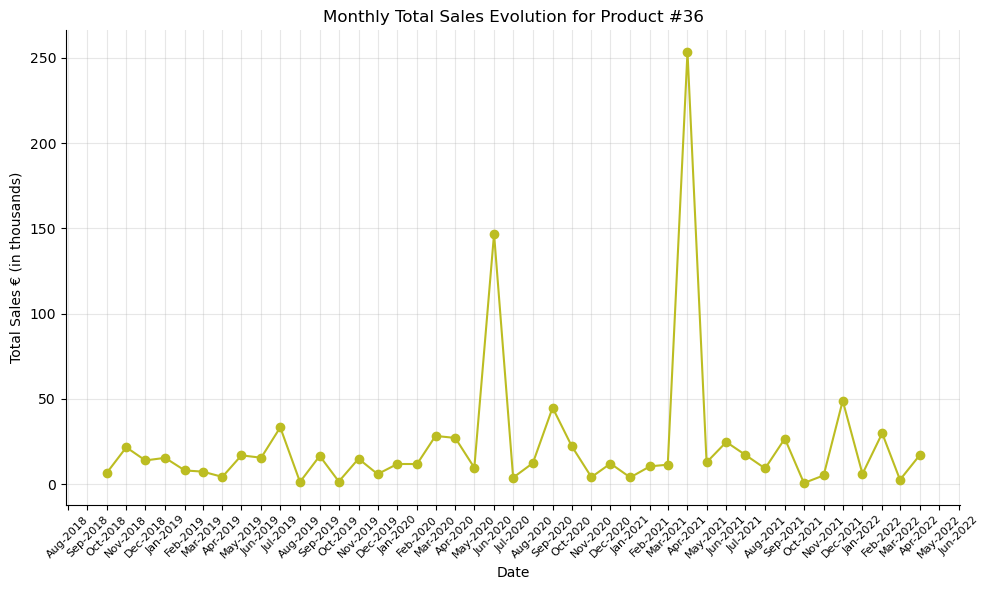

In [28]:
# Plot of graphs
for product_number in [1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 20, 36]:
    plot_monthly_product_sales(sales_viz, product_number, color_map)

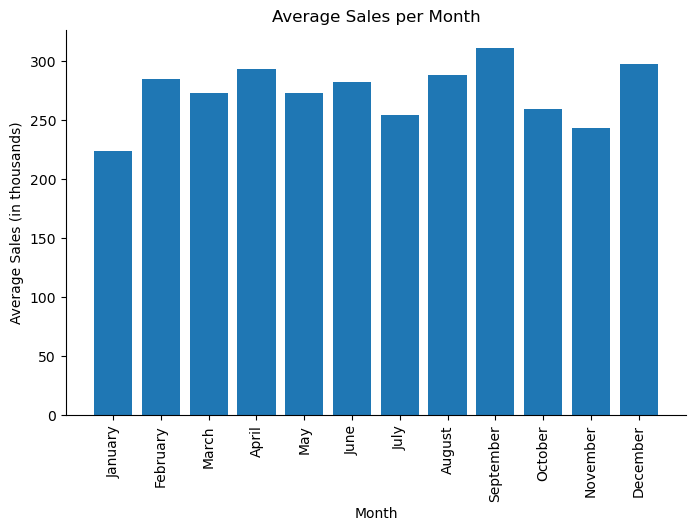

In [29]:
# Extracting the month from 'Full_Date'
sales_viz['DateM'] = sales_viz['Full_Date'].dt.strftime('%B')

# Aggregating the sales by month
sales_month_agg = sales_viz.groupby('DateM').mean()

# Sorting 'sales_month_agg' by month name
sales_month_agg = sales_month_agg.reindex(calendar.month_name[1:])

# Plot
fig, ax = plt.subplots(figsize=(8, 5))
ax.bar(sales_month_agg.index, sales_month_agg['Sales €']/1000)

# Setting labels and title
ax.set_title('Average Sales per Month')
ax.set_xlabel('Month')
ax.set_xticks(range(len(sales_month_agg.index)))
ax.set_xticklabels(sales_month_agg.index, rotation=90)
ax.set_ylabel('Average Sales (in thousands)')

# Decoration
ax.grid(False)
sns.despine()
plt.show()

In [30]:
def monthly_average_product(data, product, colors):
    # Filter data
    product_sales = data[data['GCK'] == f'#{product}']
    
    ## Extracting the month from 'Full_Date'
    product_sales['DateM'] = product_sales['Full_Date'].dt.strftime('%B')

    # Aggregating the sales by month
    sales_month_agg = product_sales.groupby('DateM').mean()

    # Sorting 'sales_month_agg' by month name
    sales_month_agg = sales_month_agg.reindex(calendar.month_name[1:])

    # Plot
    fig, ax = plt.subplots(figsize=(8, 5))
    ax.bar(sales_month_agg.index, sales_month_agg['Sales €'] / 1000, color=color_map.get(product_number, 'blue'))

    # Setting labels and title
    ax.set_title(f'Monthly Total Sales Evolution for Product #{product_number}')
    ax.set_xlabel('Month')
    ax.set_xticks(range(len(sales_month_agg.index)))
    ax.set_xticklabels(sales_month_agg.index, rotation=90)
    ax.set_ylabel('Average Sales (in thousands)')

    # Decoration
    ax.grid(False)
    sns.despine()
    plt.show()

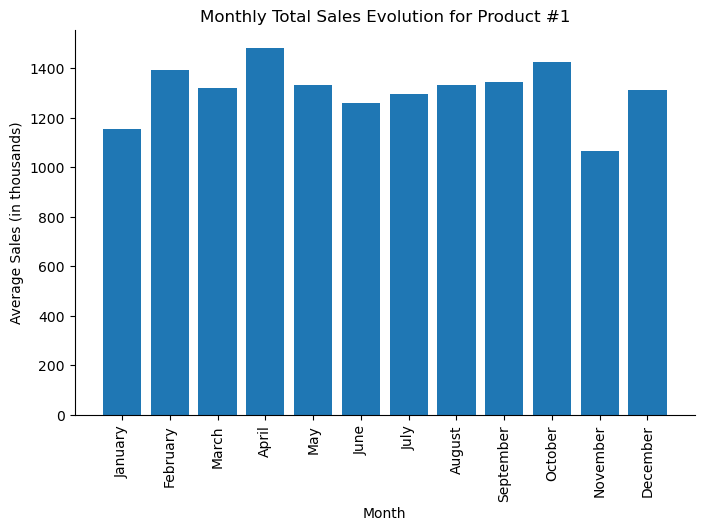

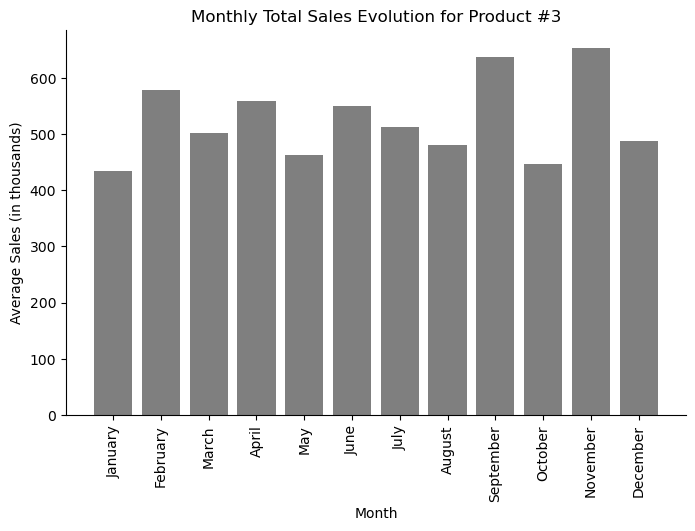

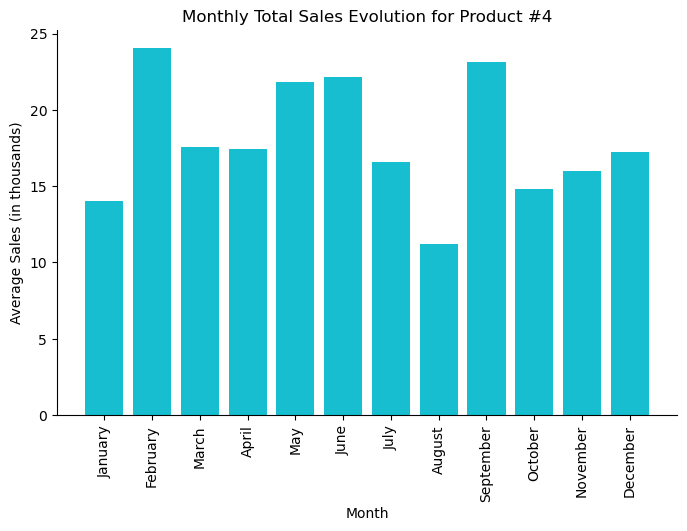

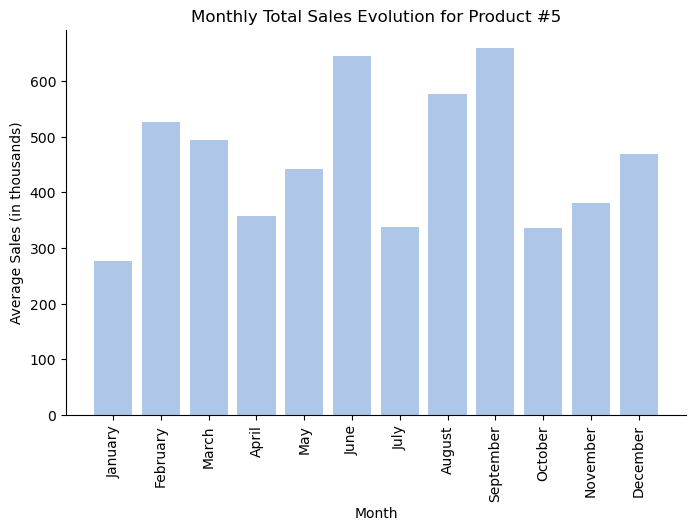

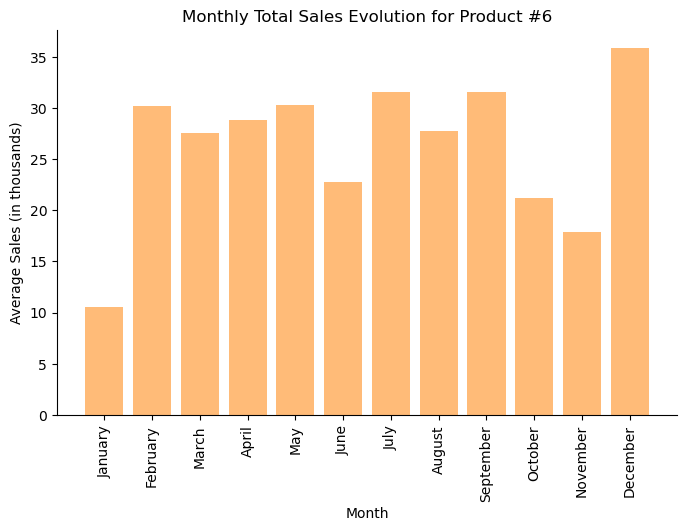

...

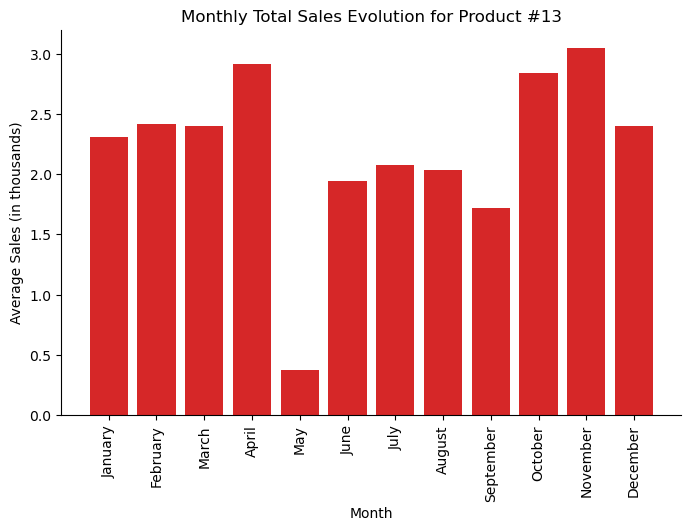

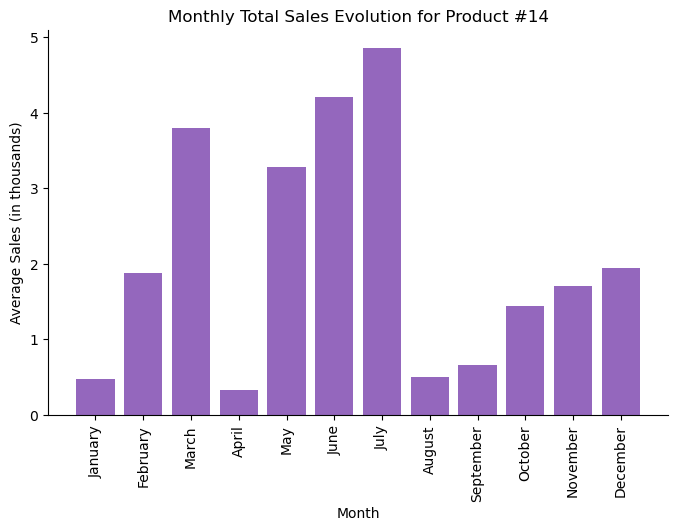

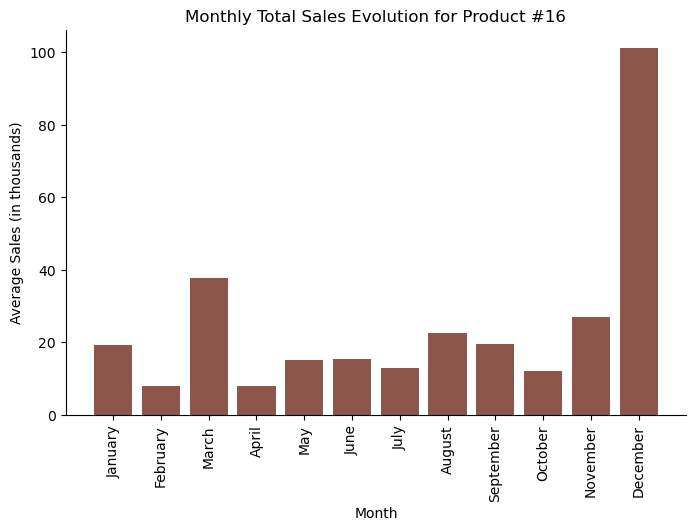

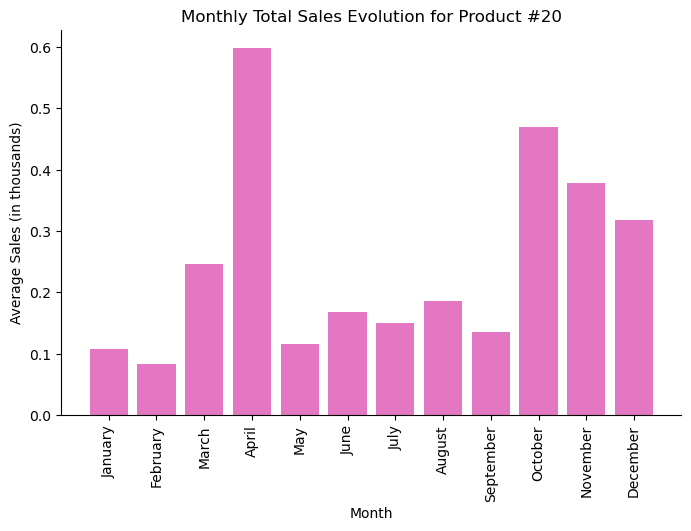

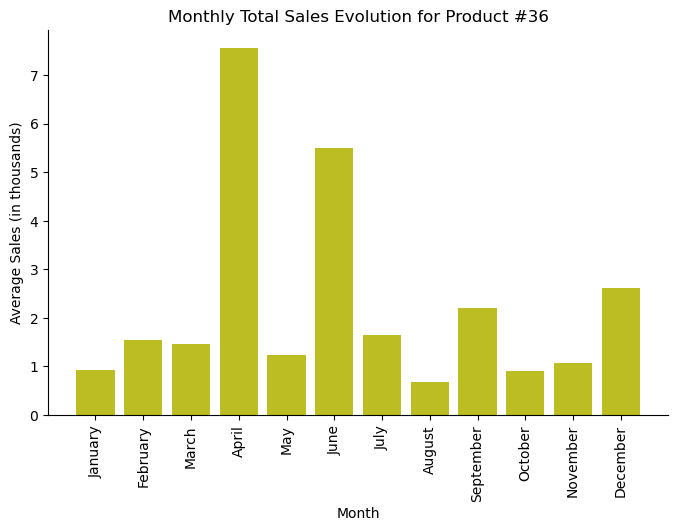

In [31]:
# Plot of graphs
for product_number in [1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 20, 36]:
    monthly_average_product(sales_viz, product_number, color_map)

**SALES PER WEEKDAY**

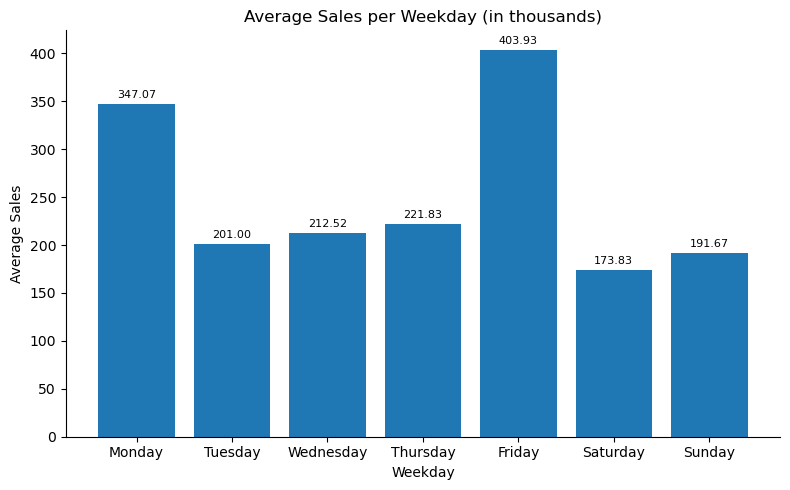

In [32]:
# Grouping by weekday and calculating the mean sales
sales_weekday_agg = sales_viz.groupby(sales_viz['Full_Date'].dt.strftime('%A')).mean()

# Reordering 'sales_weekday_agg' by weekday
days_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
sales_weekday_agg = sales_weekday_agg.reindex(days_order)

# Plotting
fig, ax = plt.subplots(figsize=(8, 5))
bars = ax.bar(sales_weekday_agg.index, sales_weekday_agg['Sales €'] / 1000)

# Adding labels with values on top of each bar
for bar in bars:
    height = bar.get_height()
    ax.annotate(f'{height:.2f}', xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3), textcoords='offset points', ha='center', va='bottom', size=8)

# Setting labels and title
ax.set_xlabel('Weekday')
ax.set_ylabel('Average Sales')
ax.set_title('Average Sales per Weekday (in thousands)')

sns.despine()
plt.tight_layout()
plt.show()

In [33]:
def weekday_average_product(data, product, colors):
    # Filter data
    product_sales = data[data['GCK'] == f'#{product}']
    
    # Grouping by weekday and calculating the mean sales
    sales_weekday_agg = product_sales.groupby(product_sales['Full_Date'].dt.strftime('%A')).mean()

    sales_weekday_agg = sales_weekday_agg.reindex(days_order)
    
    # Plotting
    fig, ax = plt.subplots(figsize=(8, 5))
    bars = ax.bar(sales_weekday_agg.index, sales_weekday_agg['Sales €'] / 1000, color=color_map.get(product_number, 'blue'))

    # Adding labels with values on top of each bar
    for bar in bars:
        height = bar.get_height()
        ax.annotate(f'{height:.2f}', xy=(bar.get_x() + bar.get_width() / 2, height),
                    xytext=(0, 3), textcoords='offset points', ha='center', va='bottom', size=8)

    # Setting labels and title
    ax.set_xlabel('Weekday')
    ax.set_ylabel('Average Sales')
    ax.set_title(f'Average Total Sales Evolution for Product #{product_number} per Weekday')

    sns.despine()
    plt.tight_layout()
    plt.show()

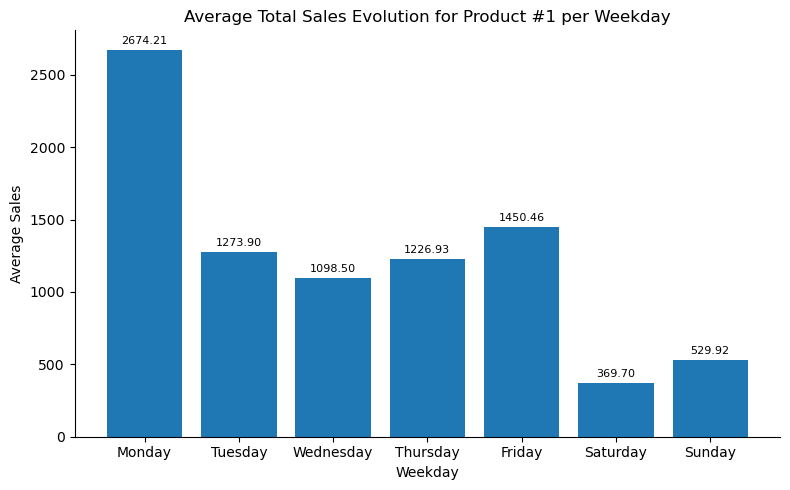

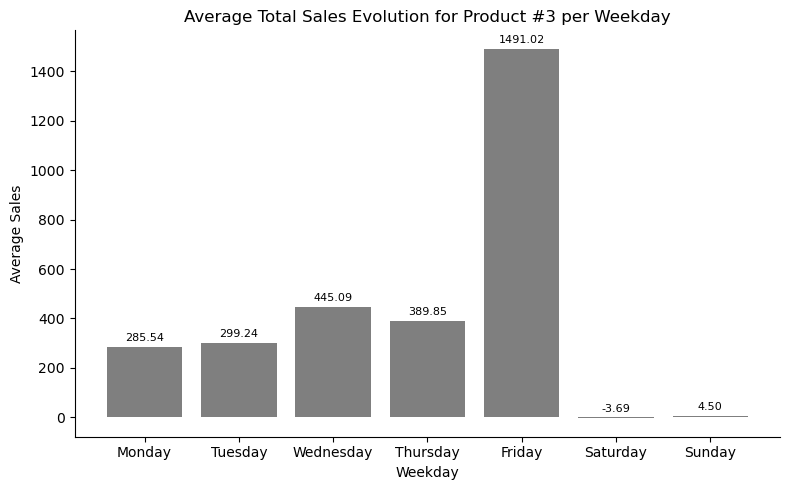

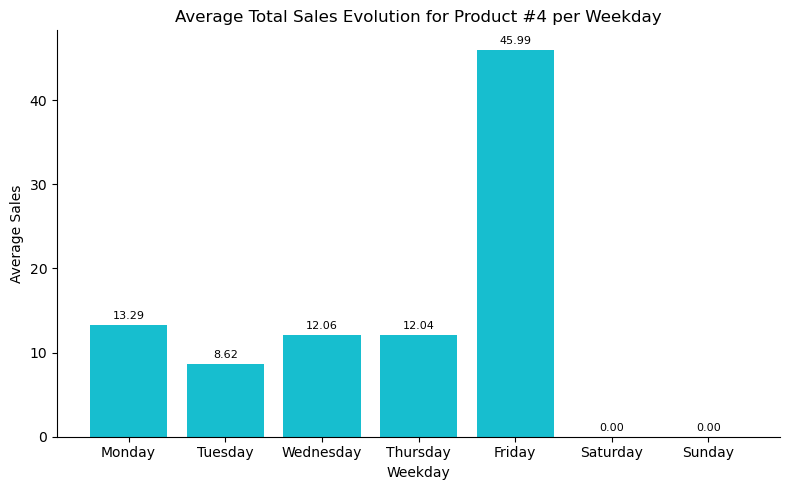

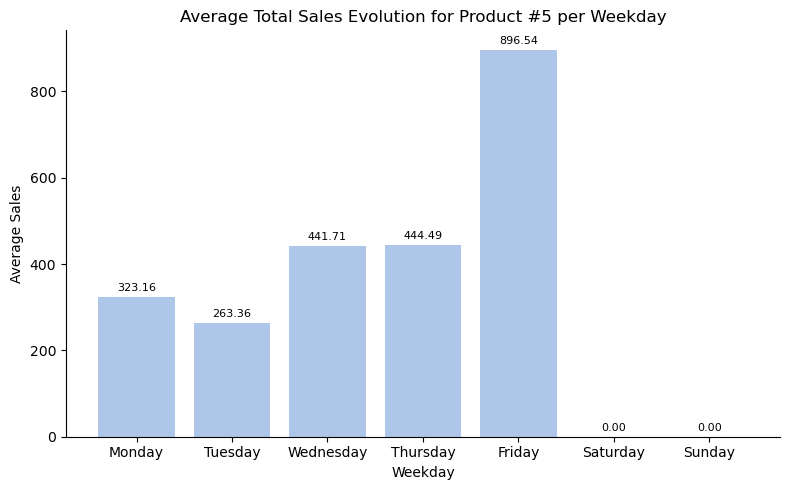

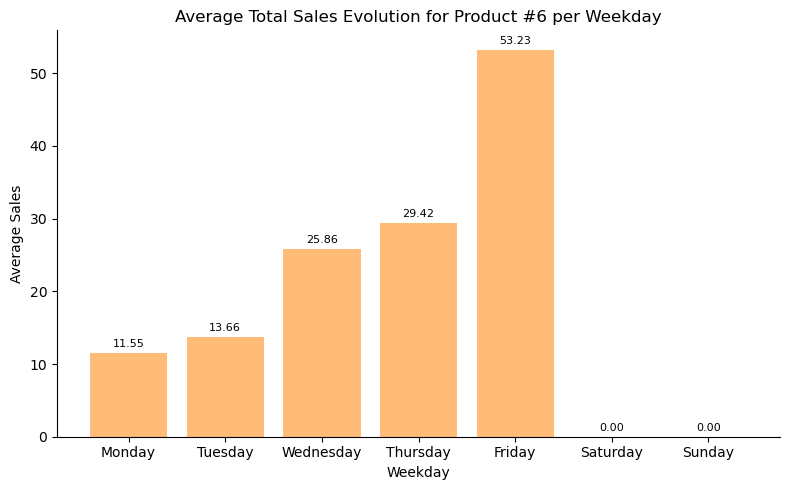

...

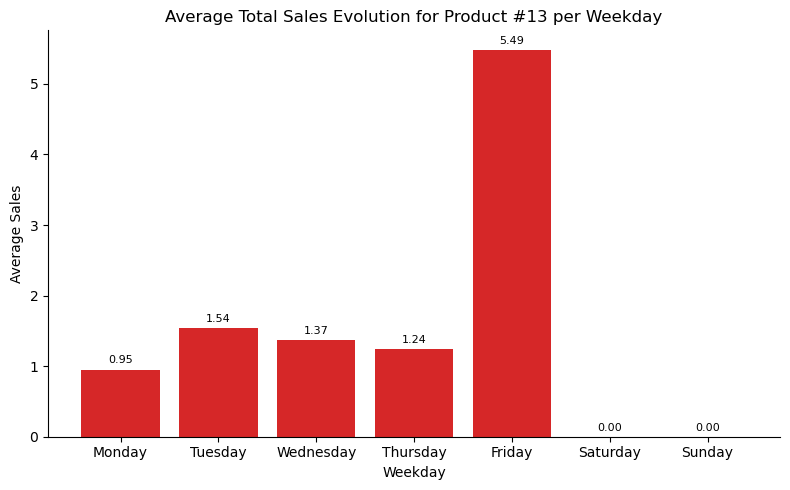

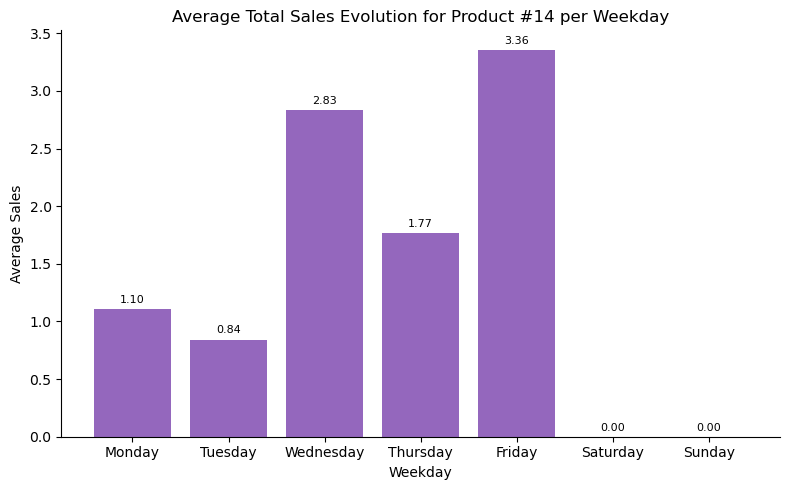

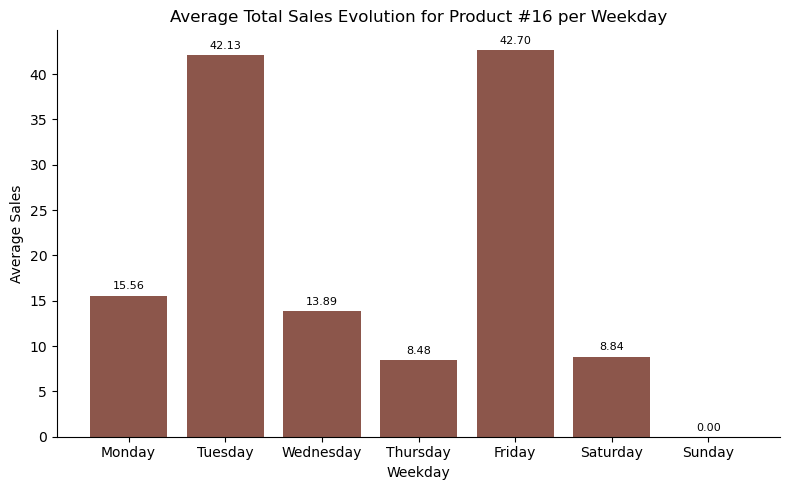

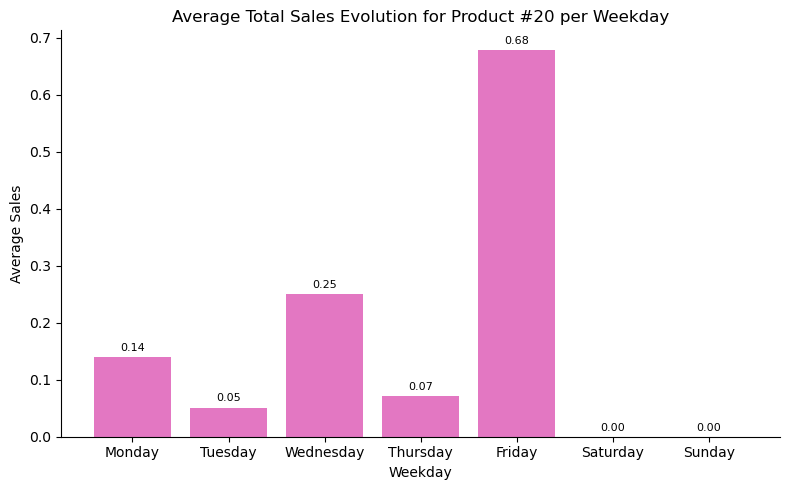

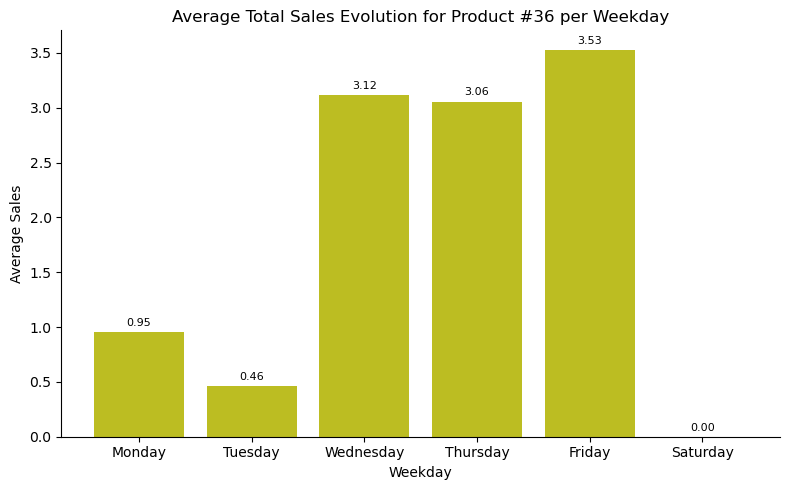

In [34]:
# Plot of graphs
for product_number in [1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 20, 36]:
    weekday_average_product(sales_viz, product_number, color_map)

**SALES PER DAY**

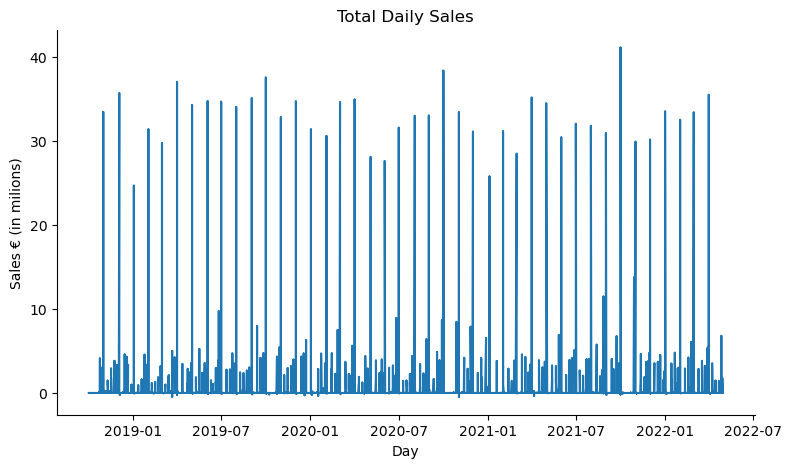

In [35]:
# Sort by date, and format Year-Month
sales_viz = sales_viz.sort_values(by='Full_Date')
years_viz = mdates.DateFormatter('%Y-%m')

# Plot
fig, ax = plt.subplots(figsize=(9,5))
ax.plot(sales_viz["Full_Date"], sales_viz["Sales €"]/1000000)
ax.grid(False)

# Setting labels and title
ax.xaxis.set_major_formatter(years_viz)
ax.set_xlabel('Day')
ax.set_ylabel('Sales € (in milions)')
ax.set_title('Total Daily Sales')

# Decoration
sns.despine()
plt.show()

In [36]:
def daily_sales_product(data, product, colors):
    # Filter data
    product_sales = data[data['GCK'] == f'#{product}']
    
    # Sort by date, and format Year-Month
    product_sales = product_sales.sort_values(by='Full_Date')
    years_viz = mdates.DateFormatter('%Y-%m')

    # Plot
    fig, ax = plt.subplots(figsize=(9,5))
    ax.plot(product_sales["Full_Date"], product_sales["Sales €"]/1000000, color=color_map.get(product_number, 'blue'))
    ax.grid(False)

    # Setting labels and title
    ax.xaxis.set_major_formatter(years_viz)
    ax.set_xlabel('Day')
    ax.set_ylabel('Sales € (in milions)')
    ax.set_title(f'Total Daily Sales per Product #{product_number}')

    # Decoration
    sns.despine()
    plt.show()

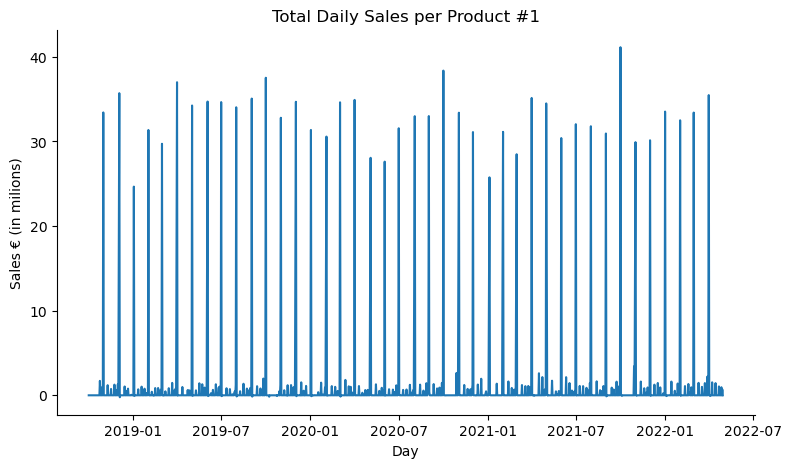

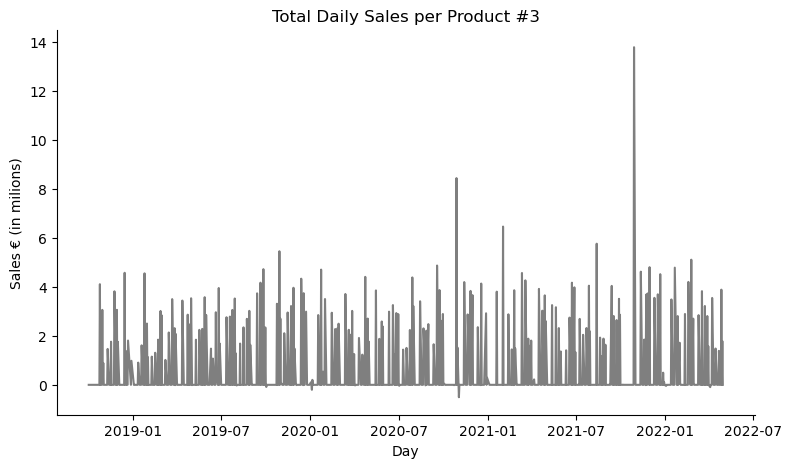

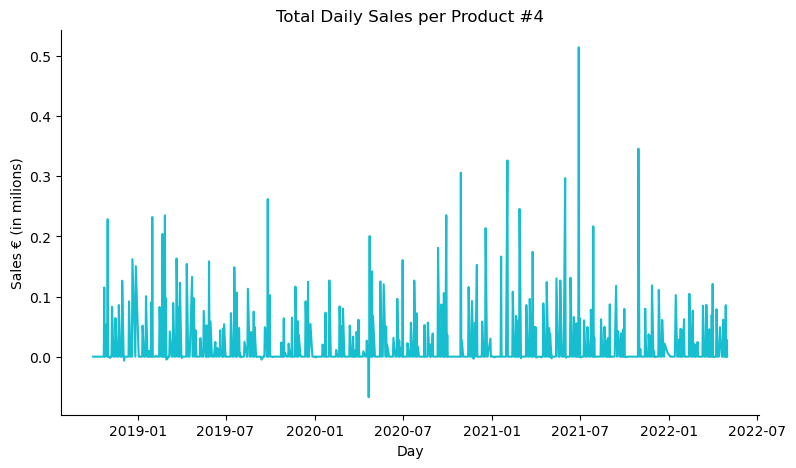

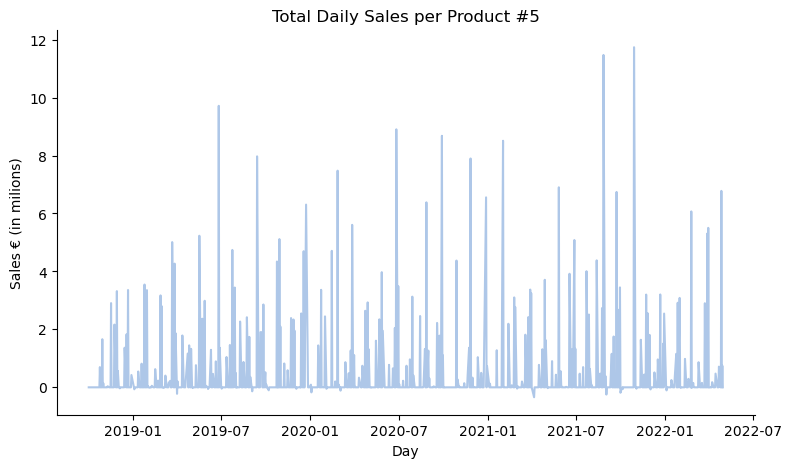

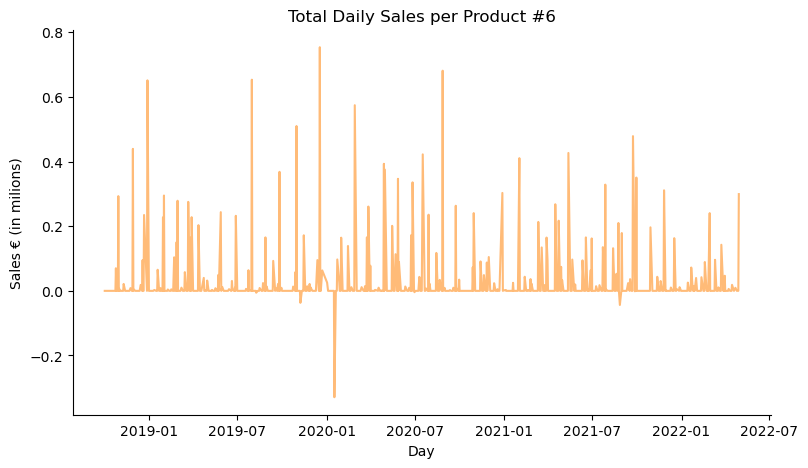

...

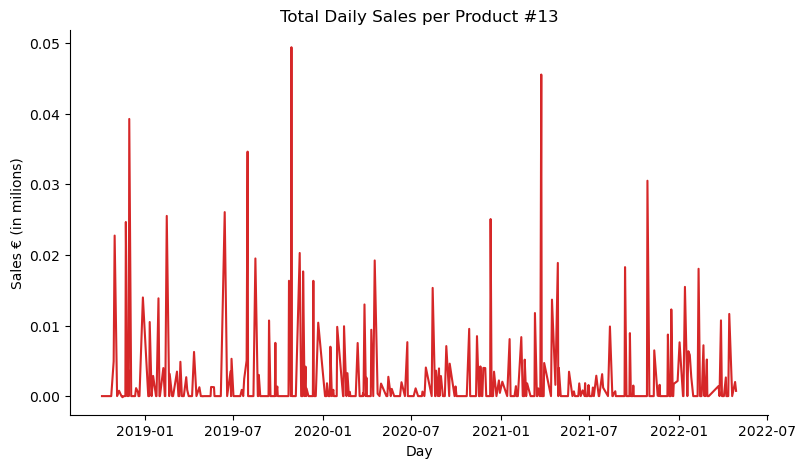

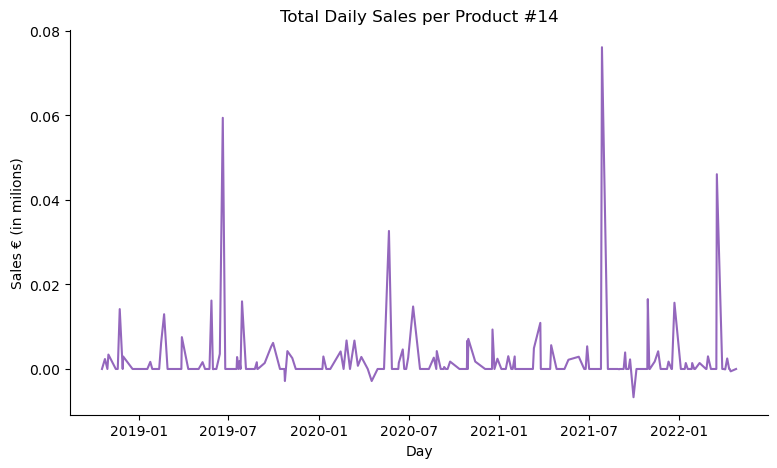

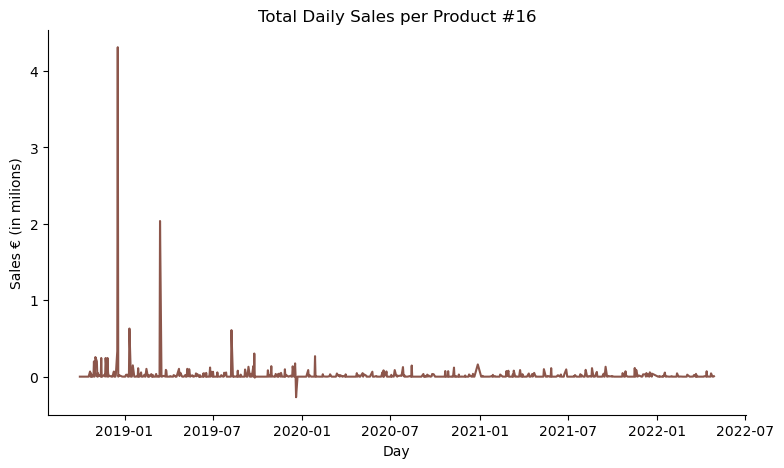

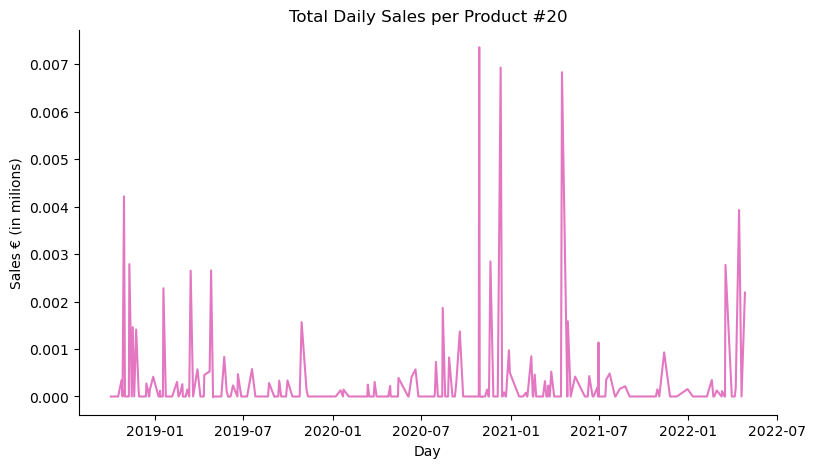

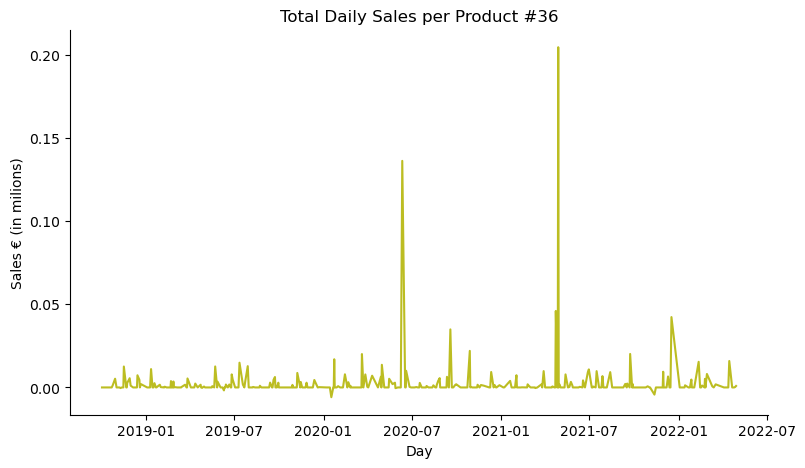

In [37]:
# Plot of graphs
for product_number in [1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 20, 36]:
    daily_sales_product(sales_viz, product_number, color_map)

**SALES TREND & SEASONALITY**

In [38]:
def analyze_product_time_series(data, product, color_map):
    # Filter data for the specified product
    product_data = data[data['GCK'] == f'#{product}']
    
    # Aggregate sales data by month and product
    monthly_sales = product_data.groupby([pd.Grouper(key='Full_Date', freq='M'), 'GCK']).sum().reset_index()

    # Convert 'Full_Date' to month-year format
    monthly_sales['Month_Year'] = monthly_sales['Full_Date'].dt.strftime('%b-%Y')
    
    # Print title
    print(f"\n{'='*50}\nAnalysis for Product #{product}\n{'='*50}\n")
    print("=" * 50)
    
    # Plot autocorrelation
    print("\033[1mAutocorrelation Plot:\033[0m")
    plot_acf(monthly_sales['Sales €'], lags=24, color=color_map.get(product, 'blue'))
    plt.title(f'Autocorrelation for #{product}')
    plt.show()
    print("-" * 50)
    
    # Perform Augmented Dickey-Fuller test
    print("\033[1mAugmented Dickey-Fuller Test:\033[0m")
    adf_result = adfuller(monthly_sales['Sales €'])
    print('\033[1mADF Statistic:\033[0m',adf_result[0])
    print('\033[1mp-value:\033[0m', adf_result[1])
    print("-" * 50)
    
    # Check for stationarity
    if adf_result[1] > 0.05:
        print('\033[1mTime series is non-stationary.\033[0m')
        
        # Perform seasonal decomposition
        print("\033[1mSeasonal Decomposition:\033[0m")
        decomposition = seasonal_decompose(monthly_sales['Sales €']/1000, model='additive', period=12)
        
        # Plot decomposed components with color mapping
        fig, axes = plt.subplots(4, 1, figsize=(10, 8))
        for i, (component, label) in enumerate(zip([decomposition.observed, decomposition.trend, decomposition.seasonal, decomposition.resid], ['Observed', 'Trend', 'Seasonal', 'Residual'])):
            component.plot(ax=axes[i], color=color_map.get(product, 'blue'))
            axes[i].set_title(label)
        plt.tight_layout()
        plt.show()
        print("=" * 50)
        
    else:
        print('Time series is stationary.')
        print("=" * 50)


Analysis for Product #1

Autocorrelation Plot:


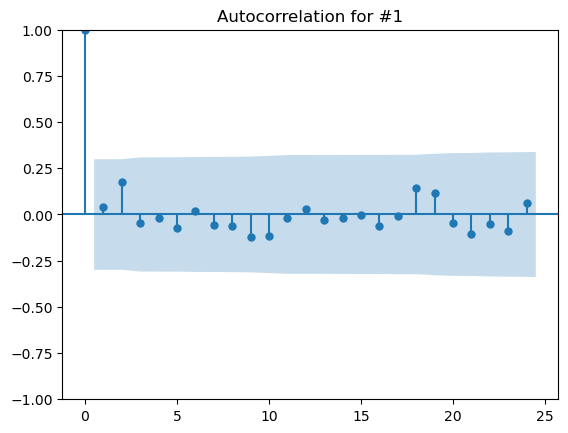

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -6.0024426178931
p-value: 1.645123541205879e-07
--------------------------------------------------
Time series is stationary.

Analysis for Product #3

Autocorrelation Plot:


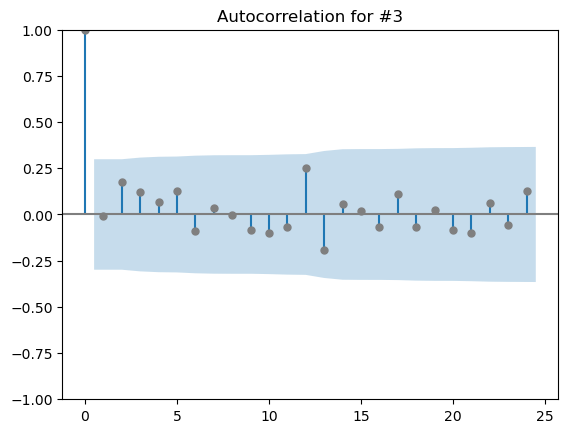

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -6.59029097412069
p-value: 7.142767612142176e-09
--------------------------------------------------
Time series is stationary.

Analysis for Product #4

Autocorrelation Plot:


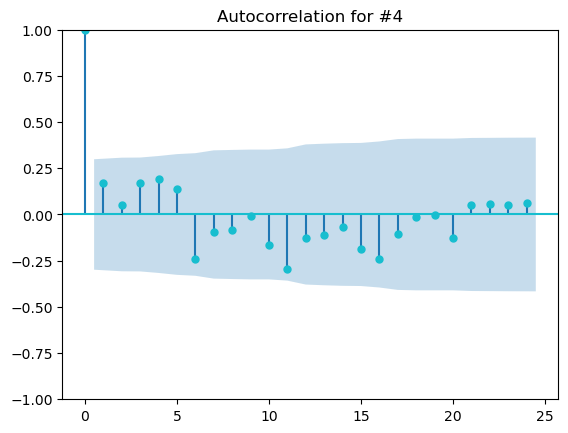

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -5.319293109866351
p-value: 4.9936428626477225e-06
--------------------------------------------------
Time series is stationary.

Analysis for Product #5

Autocorrelation Plot:


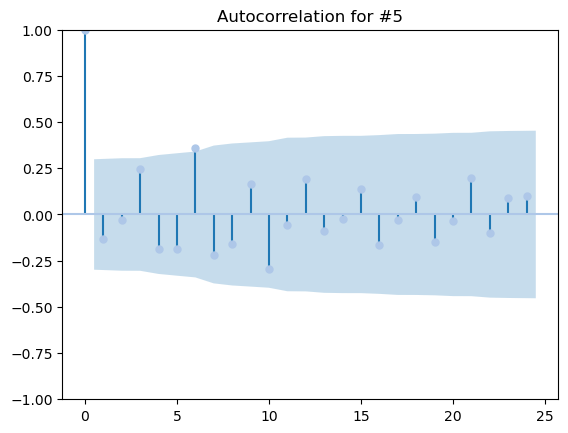

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -7.636227667202235
p-value: 1.9491752970288628e-11
--------------------------------------------------
Time series is stationary.

Analysis for Product #6

Autocorrelation Plot:


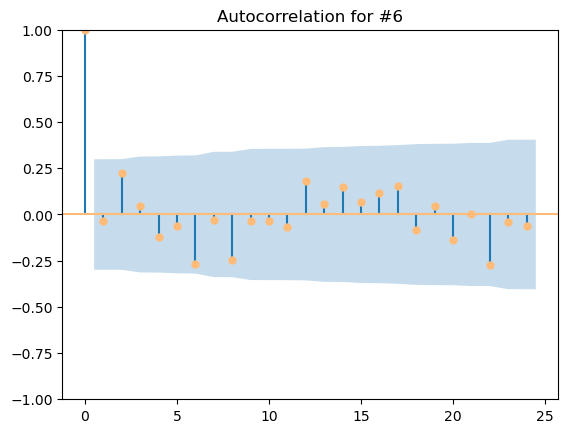

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -3.4777620176183284
p-value: 0.008576920724789426
--------------------------------------------------
Time series is stationary.

Analysis for Product #8

Autocorrelation Plot:


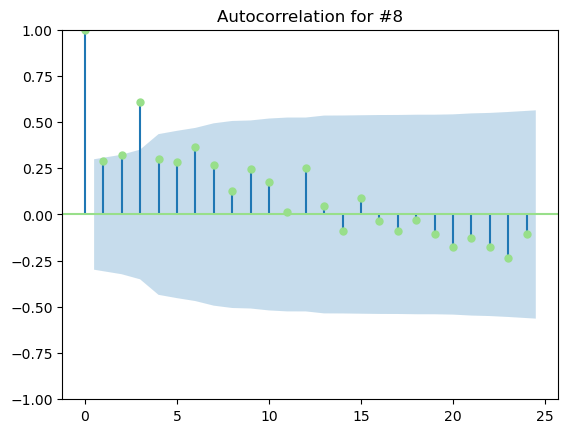

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: 2.3408589157276944
p-value: 0.9989797012737535
--------------------------------------------------
Time series is non-stationary.
Seasonal Decomposition:


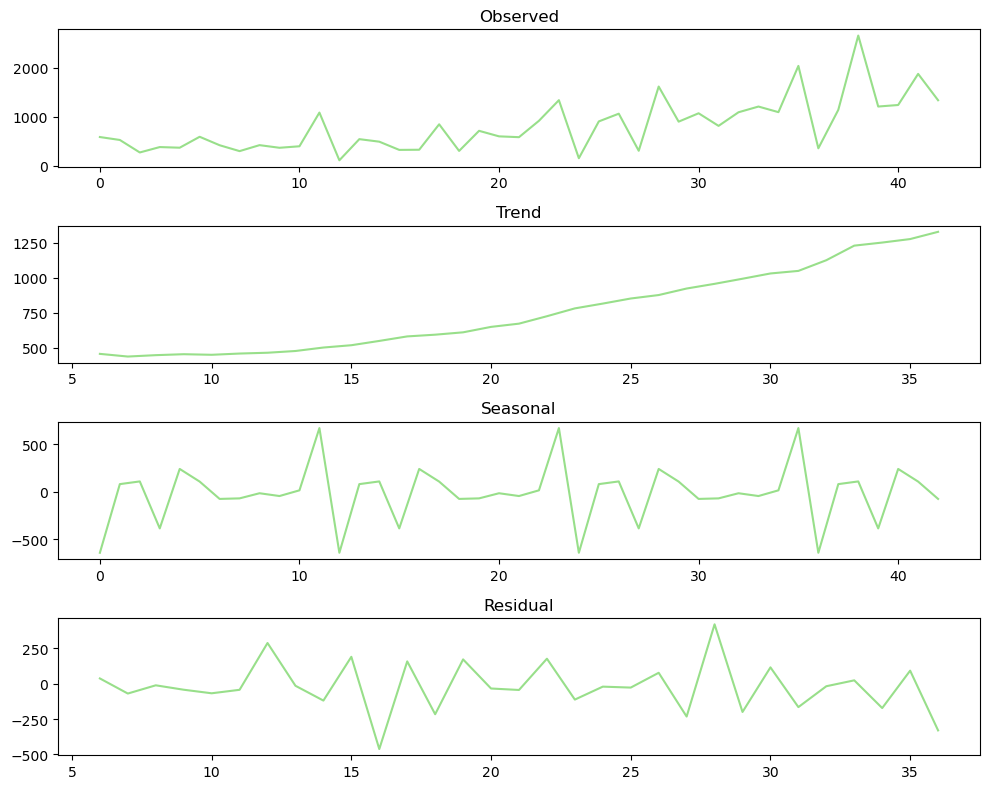


Analysis for Product #9

Autocorrelation Plot:


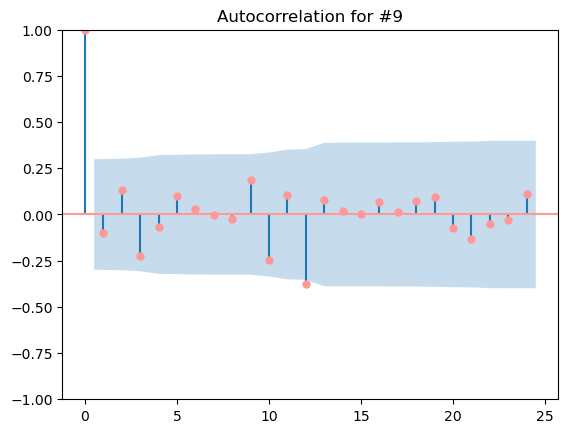

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -7.013494191594952
p-value: 6.825987672313023e-10
--------------------------------------------------
Time series is stationary.

Analysis for Product #11

Autocorrelation Plot:


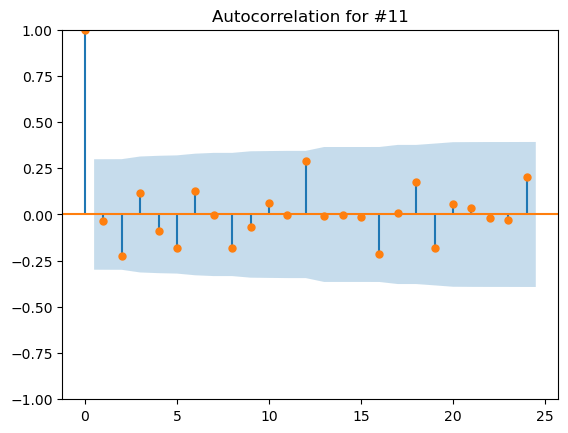

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -5.577923425619495
p-value: 1.4181546486613814e-06
--------------------------------------------------
Time series is stationary.

Analysis for Product #12

Autocorrelation Plot:


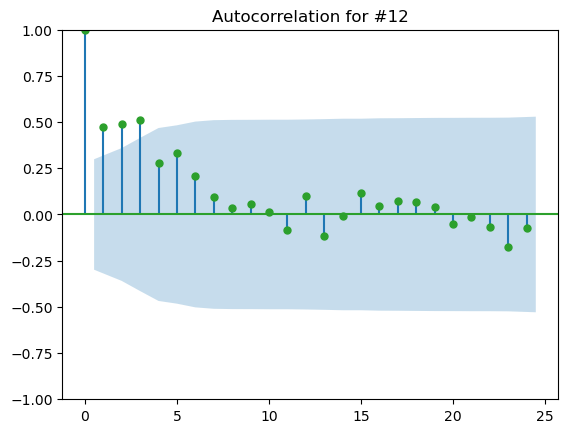

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -3.8693374327052448
p-value: 0.0022724606900160643
--------------------------------------------------
Time series is stationary.

Analysis for Product #13

Autocorrelation Plot:


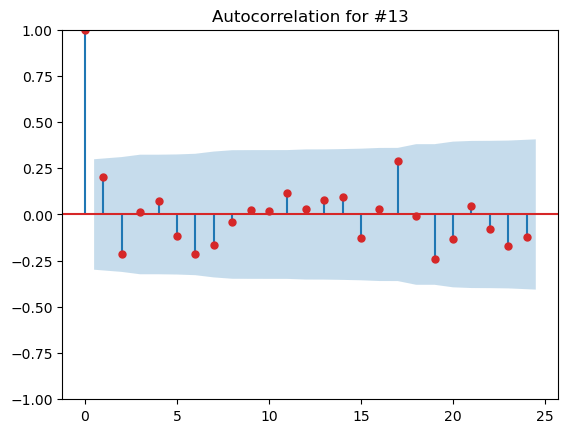

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -3.254199412406007
p-value: 0.017054083406873196
--------------------------------------------------
Time series is stationary.

Analysis for Product #14

Autocorrelation Plot:


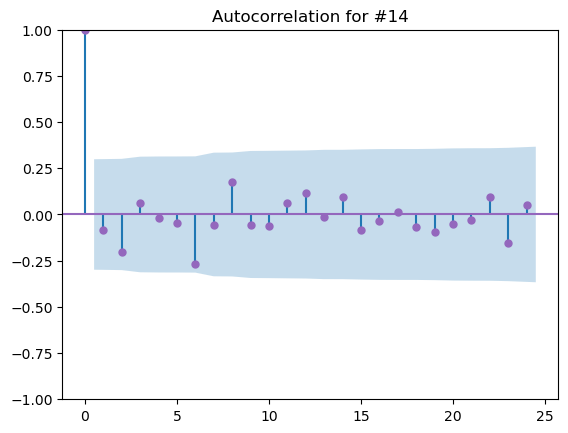

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -6.871822045698356
p-value: 1.508839841879323e-09
--------------------------------------------------
Time series is stationary.

Analysis for Product #16

Autocorrelation Plot:


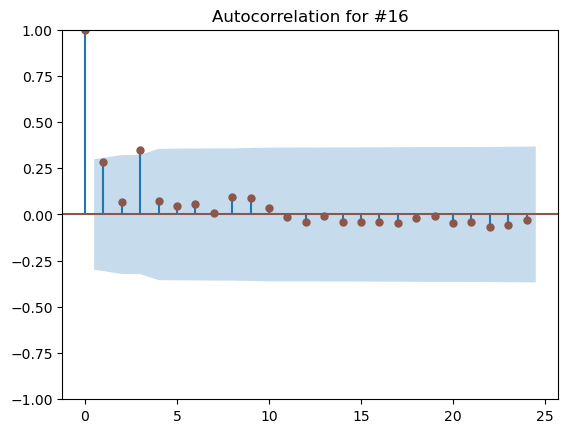

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -6.367203675739944
p-value: 2.3935850598794433e-08
--------------------------------------------------
Time series is stationary.

Analysis for Product #20

Autocorrelation Plot:


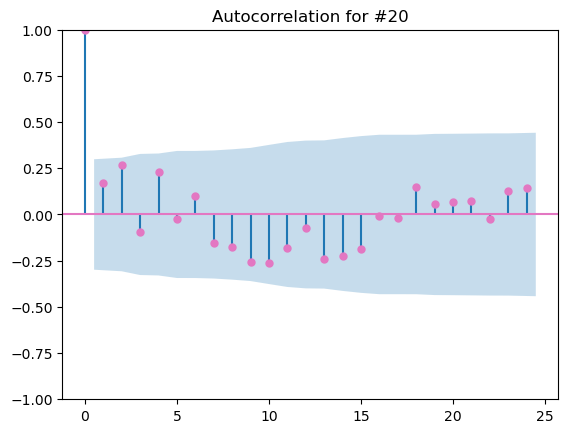

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -3.1251793714809954
p-value: 0.024745053808141813
--------------------------------------------------
Time series is stationary.

Analysis for Product #36

Autocorrelation Plot:


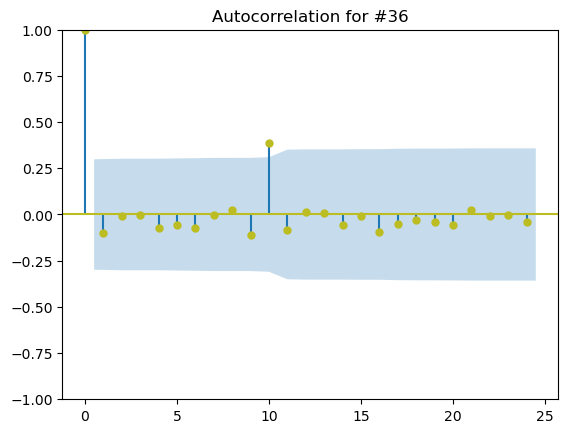

--------------------------------------------------
Augmented Dickey-Fuller Test:
ADF Statistic: -7.0000269031722695
p-value: 7.362685844354468e-10
--------------------------------------------------
Time series is stationary.


In [39]:
# Plot of graphs
for product_number in [1, 3, 4, 5, 6, 8, 9, 11, 12, 13, 14, 16, 20, 36]:
    analyze_product_time_series(sales_viz, product_number, color_map)

### - Market Dataset

In [40]:
# Copy the DataFrame market_data to market_viz
market_viz = market_data.copy()

# Set "Month Year" column as index
market_viz.set_index("Month Year", inplace=True)

# Convert index to datetime
market_viz.index = pd.to_datetime(market_viz.index, format='%b %Y')

# Sort the DataFrame by index in chronological order
market_viz.sort_index(inplace=True)

# Display
market_viz.head()

,China Production Index M&E,China Shipments Index M&E,France Production Index M&E,France Shipments Index M&E,Germany Production Index M&E,Germany Shipments Index M&E,Italy Production Index M&E,Italy Shipments Index M&E,Japan Production Index M&E,Japan Shipments Index M&E,Switzerland Production Index M&E,Switzerland Shipments Index M&E,UK Production Index M&E,UK Shipments Index M&E,US Production Index M&E,US Shipments Index M&E,Europe Production Index M&E,Europe Shipments Index M&E,Price of Base Metals,Price of Energy,Price of Metals & Minerals,Price of Natural gas index,Price of Crude oil (AVG),Price of Copper,United States: EUR in LCU,US Producer Prices Electrical eq.,UK Producer Prices Electrical eq.,Italy Producer Prices Electrical eq.,France Producer Prices Electrical eq.,Germany Producer Prices Electrical eq.,China Producer Prices Electrical eq.,US Production Index Machinery eq.,Global Production Index Machinery eq.,Switzerland Production Index Machinery eq.,UK Production Index Machinery eq.,Italy Production Index Machinery eq.,Japan Production Index Machinery eq.,France Production Index Machinery eq.,Germany Production Index Machinery eq.,US Production Index Electrical eq.,Global Production Index Electrical eq.,Switzerland Production Index Electrical eq.,UK Production Index Electrical eq.,Italy Production Index Electrical eq.,Japan Production Index Electrical eq.,France Production Index Electrical eq.,Germany Production Index Electrical eq.
Month Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2004-02-01,16.940704,16.940704,112.091273,83.458866,82.623037,79.452532,124.289603,86.560493,109.334010,110.495272,91.221862,89.987275,111.353812,73.601265,107.601400,79.240230,97.122911,80.098530,54.039811,44.123338,48.747945,87.076974,39.639458,36.623832,1.2646,78.969864,80.757423,93.020027,NaN,93.230453,NaN,102.491722,97.597374,97.100000,106.191977,116.790276,110.890034,118.274109,80.829010,117.723991,NaN,81.100000,120.706516,141.510864,106.161262,102.077057,85.913200
2004-03-01,23.711852,23.711852,136.327976,106.168192,100.556582,97.012918,143.411662,106.344544,140.884616,144.686166,85.866287,79.883583,127.558608,84.047595,110.187364,98.619024,113.783904,96.015929,54.666162,47.588957,49.256157,87.192705,42.592034,39.931055,1.2262,79.673569,80.962135,93.540268,NaN,93.335678,NaN,105.627480,113.224892,91.195116,121.625075,139.288391,141.176853,148.121841,102.130104,119.220779,NaN,76.690307,138.309550,152.880234,140.288741,117.225685,97.670815
2004-04-01,24.435235,24.435235,117.791806,92.007646,89.653203,84.932358,129.083828,95.579673,105.853579,102.655769,85.622508,79.740802,108.732297,73.026027,108.166564,89.774031,101.715199,85.167236,54.872715,47.779013,49.423751,91.379923,42.650637,39.134854,1.1985,80.337639,80.757423,93.852425,NaN,93.440903,NaN,103.484955,100.169090,93.793535,104.965505,125.289566,105.648765,125.482231,90.961426,117.441124,NaN,71.552403,115.557330,137.796875,106.271197,105.335777,87.253983
2004-05-01,23.708115,23.708115,109.002541,85.696486,86.880571,82.372794,135.590391,100.087039,101.864777,100.305285,85.378729,79.598021,110.645200,74.591883,108.425887,87.463813,101.275727,84.485767,51.230356,53.590898,46.468392,99.044520,47.517121,36.278433,1.2007,80.798828,80.757423,93.852425,NaN,93.546127,NaN,103.643944,99.581436,96.391954,105.885359,131.988998,101.990361,116.649750,88.082901,117.899216,NaN,66.414500,119.269534,143.860535,101.608710,96.616508,84.675552
2004-06-01,27.009138,27.009138,133.785737,106.641482,99.010814,95.108740,136.424935,110.889719,120.332920,119.616380,85.134950,79.455239,122.020960,82.343346,110.569933,97.364496,112.057197,96.963294,52.876331,50.799575,47.803913,98.636267,44.967605,35.657380,1.2138,80.913490,80.552711,93.956467,NaN,93.440903,NaN,106.062668,109.277710,98.990373,118.252278,132.988922,122.136575,143.248734,100.978699,119.499107,NaN,61.276596,128.849416,144.315308,116.655248,118.458710,95.401802


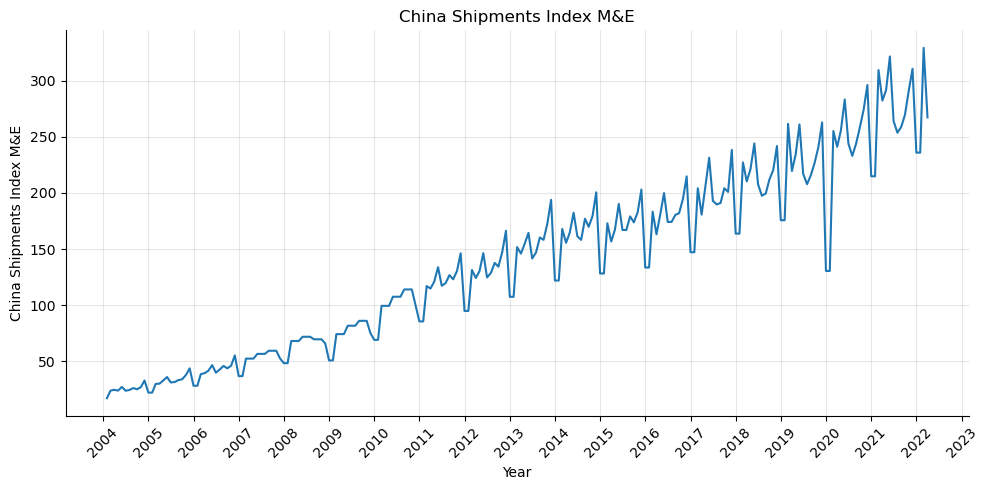

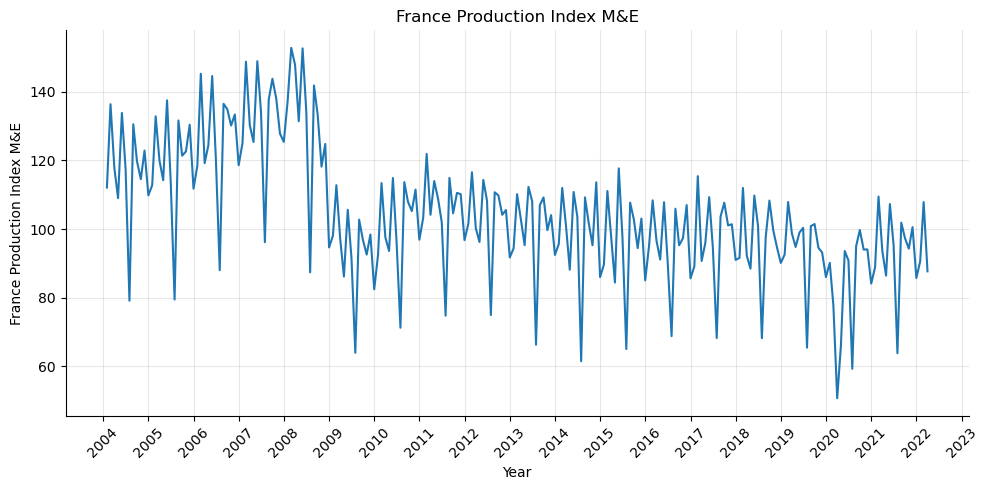

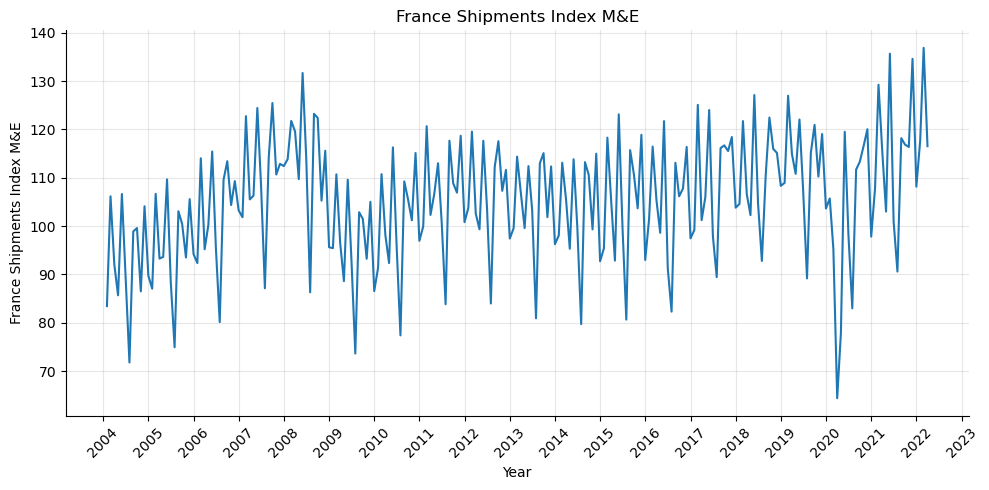

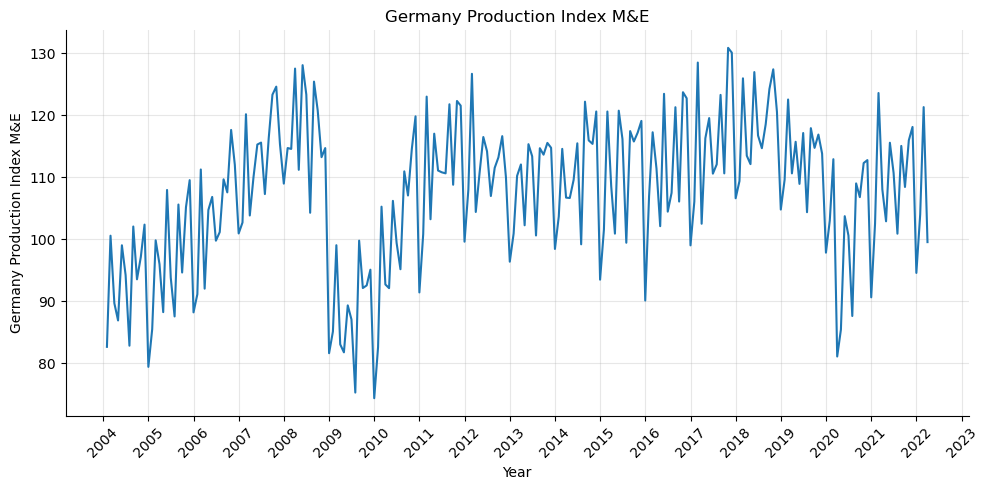

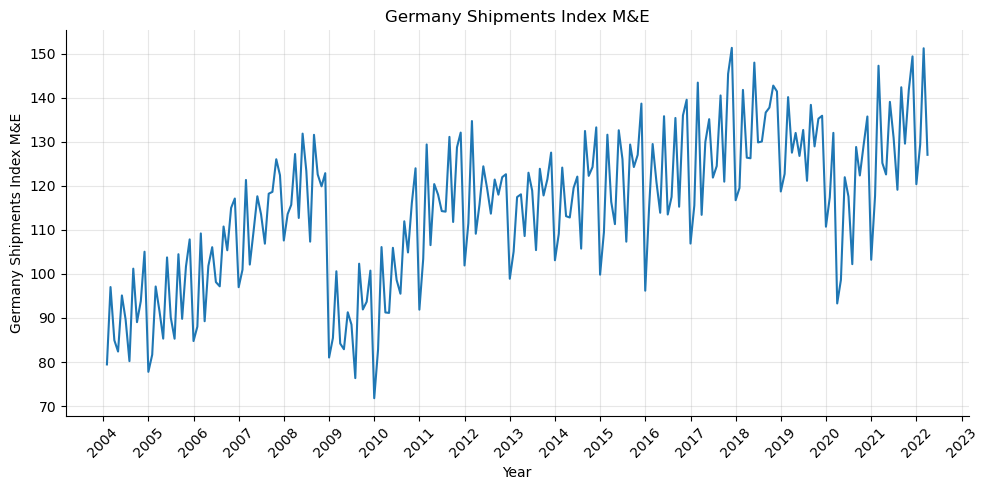

...

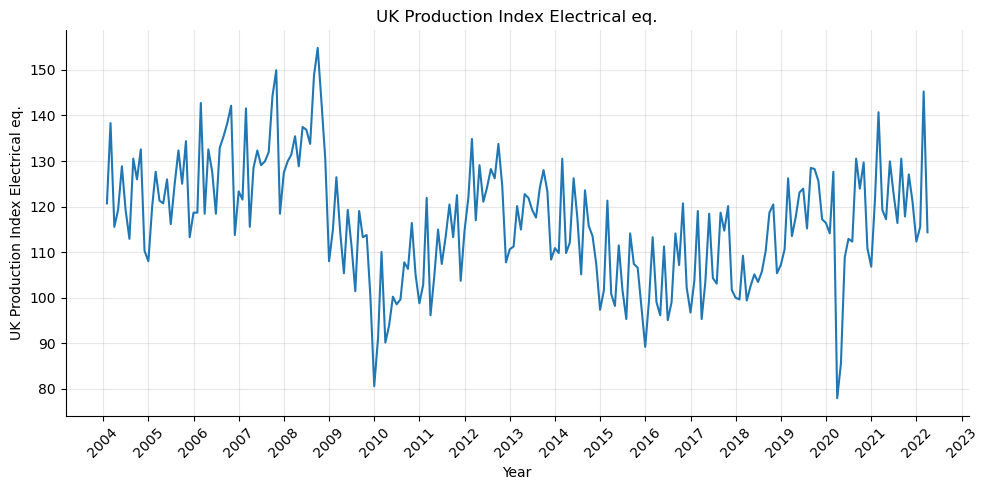

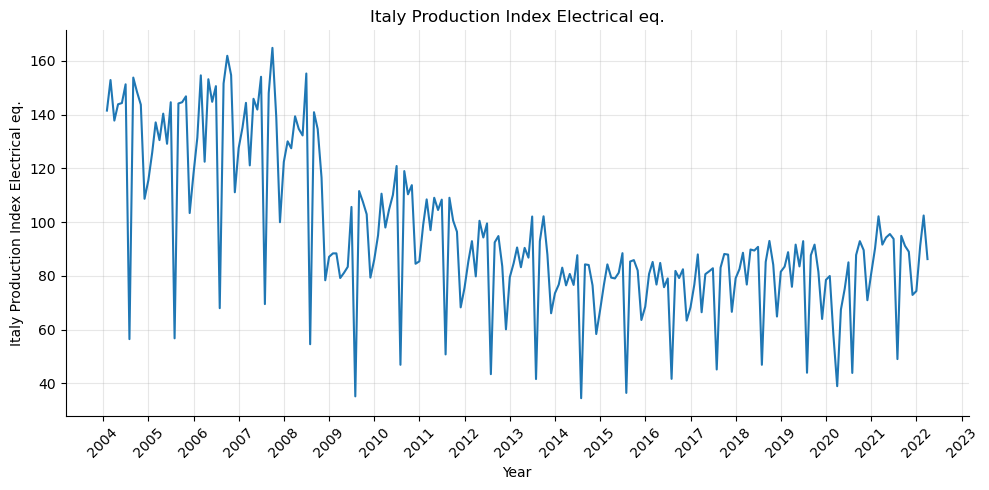

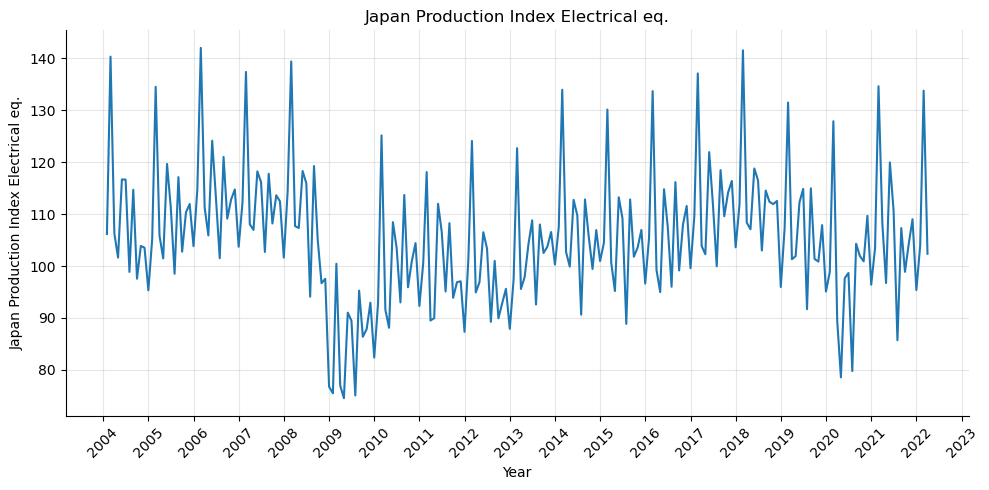

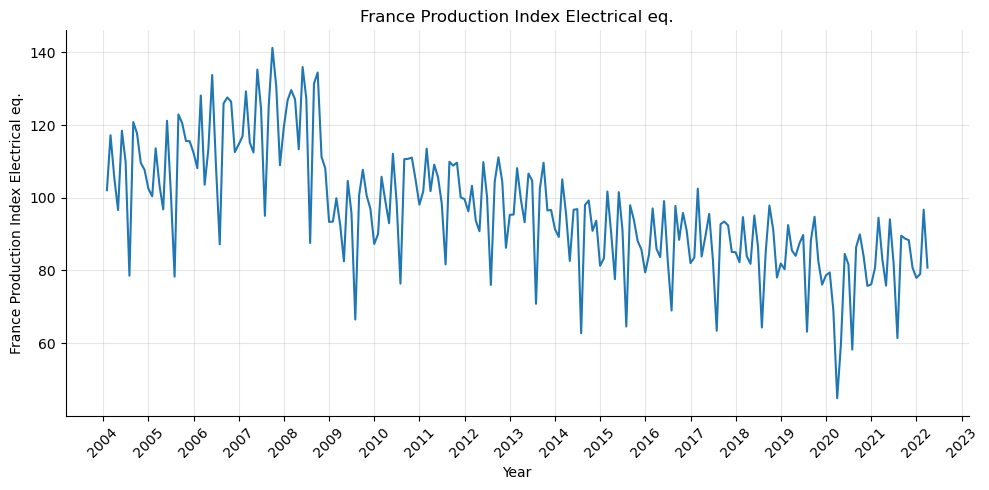

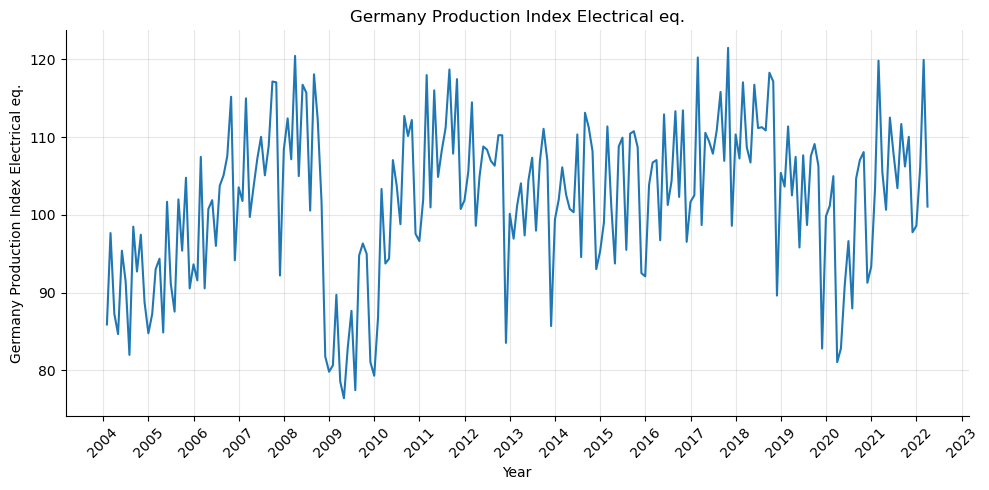

In [41]:
# Loop through all columns
for col in market_viz.columns[1:]:
    
    # Plot
    fig, ax = plt.subplots(figsize=(10, 5))
    ax.plot(market_viz.index, market_viz[col])
    
    # Set axis labels and title
    ax.set_xlabel('Year')
    ax.set_ylabel(col)
    ax.set_title(col)
    
    # Set x-axis date to display YEAR
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y')) 
    
    # Set x-ticks to display EVERY year
    years = mdates.YearLocator()
    ax.xaxis.set_major_locator(years)
    
    # Rotate x-axis
    plt.xticks(rotation=45)

    # Decorations
    plt.grid(alpha=0.3) 
    plt.tight_layout()
    sns.despine()
    plt.show()

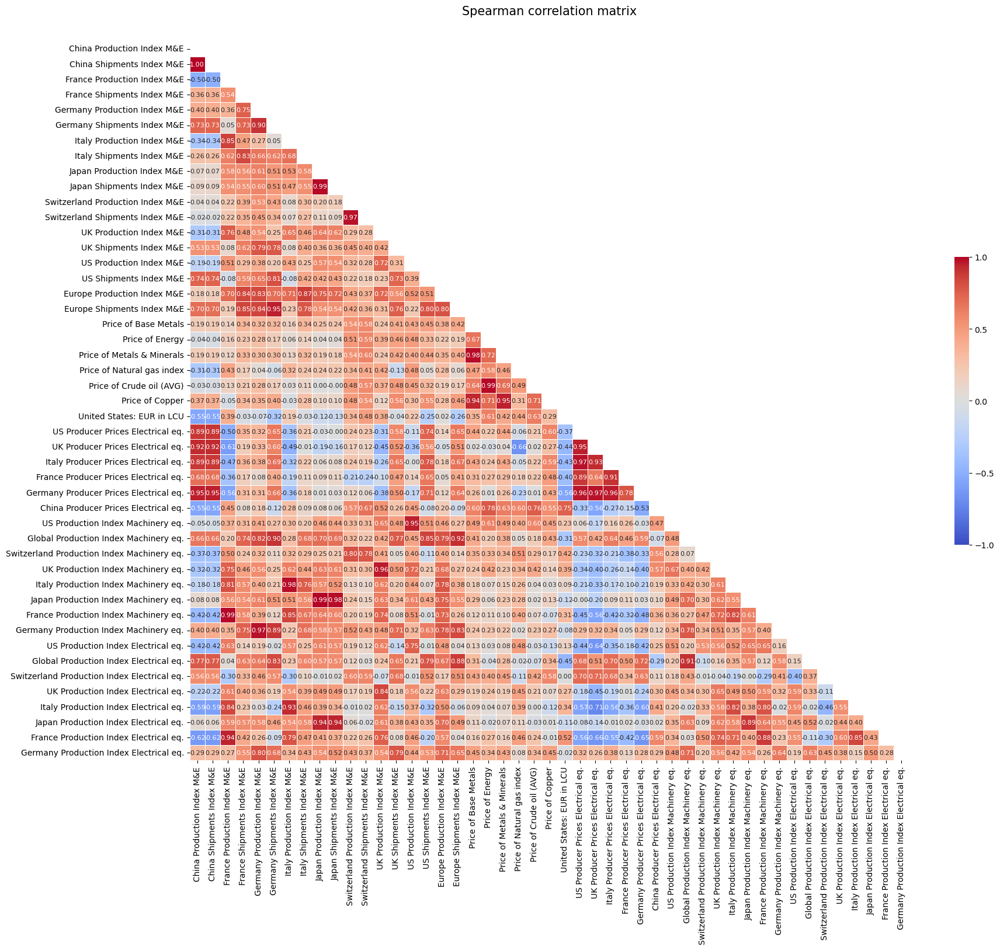

In [42]:
# Set correlation of variables
corr = market_viz.corr()

# Mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Create correlation matrix
fig , ax = plt.subplots(figsize=(20, 16))  # Increase the figure size
heatmap = sns.heatmap(corr,
                      mask=mask,
                      square=True,
                      linewidths=.5,
                      cmap='coolwarm',
                      cbar_kws={'shrink': .4,
                                'ticks': [-1, -.5, 0, 0.5, 1]},
                      fmt='.2f',  # Adjusted format to two decimal places
                      vmin=-1,
                      vmax=1,
                      annot=True,
                      annot_kws={'size': 8})  # Adjust annotation size

# Decoration
plt.title("Spearman correlation matrix", fontsize=15, y=1.03)
sns.set_style({'xtick.bottom': True}, {'ytick.left': True})
plt.show()


<hr>
<a class="anchor" id="3">
    
# 3. Data Preprocessing
    
    
</a>

In [43]:
# Copy the DataFrame
sales_copy = sales_data.copy()

# Convert 'Full_Date' column to datetime
sales_copy['Full_Date'] = pd.to_datetime(sales_copy['Full_Date'], format='%d-%m-%Y')

# Group by both 'Full_Date' (month) and 'GCK' (product), and sum the sales
sales_copy = sales_copy.groupby([sales_copy['Full_Date'].dt.to_period('M'), 'GCK']).sum().reset_index()

# Convert 'Full_Date' column to string
sales_copy['Full_Date'] = pd.to_datetime(sales_copy['Full_Date'].astype(str))

In [44]:
sales_copy

,Full_Date,GCK,Sales €
0,2018-10-01,#1,36098918.79
1,2018-10-01,#11,1021303.50
2,2018-10-01,#12,28686.33
3,2018-10-01,#13,27666.10
4,2018-10-01,#14,5770.00
...,...,...,...
597,2022-04-01,#4,302057.04
598,2022-04-01,#5,8884607.53
599,2022-04-01,#6,333705.61
600,2022-04-01,#8,1336220.96


In [45]:
# Copy
market_copy = market_data.copy()

# Function to parse date-like strings
def parse_date(date_str):
    month_str, year_str = date_str.split()
    month_map = {
        'Jan': 1, 'Feb': 2, 'Mar': 3, 'Apr': 4, 'May': 5, 'Jun': 6,
        'Jul': 7, 'Aug': 8, 'Sep': 9, 'Oct': 10, 'Nov': 11, 'Dec': 12
    }
    month = month_map[month_str]
    year = int(year_str)
    return datetime(year, month, 1)

# Apply the function to the 'date' column
market_copy['Month Year'] = market_copy['Month Year'].apply(parse_date)

market_copy.head(5)

,Month Year,China Production Index M&E,China Shipments Index M&E,France Production Index M&E,France Shipments Index M&E,Germany Production Index M&E,Germany Shipments Index M&E,Italy Production Index M&E,Italy Shipments Index M&E,Japan Production Index M&E,Japan Shipments Index M&E,Switzerland Production Index M&E,Switzerland Shipments Index M&E,UK Production Index M&E,UK Shipments Index M&E,US Production Index M&E,US Shipments Index M&E,Europe Production Index M&E,Europe Shipments Index M&E,Price of Base Metals,Price of Energy,Price of Metals & Minerals,Price of Natural gas index,Price of Crude oil (AVG),Price of Copper,United States: EUR in LCU,US Producer Prices Electrical eq.,UK Producer Prices Electrical eq.,Italy Producer Prices Electrical eq.,France Producer Prices Electrical eq.,Germany Producer Prices Electrical eq.,China Producer Prices Electrical eq.,US Production Index Machinery eq.,Global Production Index Machinery eq.,Switzerland Production Index Machinery eq.,UK Production Index Machinery eq.,Italy Production Index Machinery eq.,Japan Production Index Machinery eq.,France Production Index Machinery eq.,Germany Production Index Machinery eq.,US Production Index Electrical eq.,Global Production Index Electrical eq.,Switzerland Production Index Electrical eq.,UK Production Index Electrical eq.,Italy Production Index Electrical eq.,Japan Production Index Electrical eq.,France Production Index Electrical eq.,Germany Production Index Electrical eq.
0,2004-02-01,16.940704,16.940704,112.091273,83.458866,82.623037,79.452532,124.289603,86.560493,109.334010,110.495272,91.221862,89.987275,111.353812,73.601265,107.601400,79.240230,97.122911,80.098530,54.039811,44.123338,48.747945,87.076974,39.639458,36.623832,1.2646,78.969864,80.757423,93.020027,NaN,93.230453,NaN,102.491722,97.597374,97.100000,106.191977,116.790276,110.890034,118.274109,80.829010,117.723991,NaN,81.100000,120.706516,141.510864,106.161262,102.077057,85.913200
1,2004-03-01,23.711852,23.711852,136.327976,106.168192,100.556582,97.012918,143.411662,106.344544,140.884616,144.686166,85.866287,79.883583,127.558608,84.047595,110.187364,98.619024,113.783904,96.015929,54.666162,47.588957,49.256157,87.192705,42.592034,39.931055,1.2262,79.673569,80.962135,93.540268,NaN,93.335678,NaN,105.627480,113.224892,91.195116,121.625075,139.288391,141.176853,148.121841,102.130104,119.220779,NaN,76.690307,138.309550,152.880234,140.288741,117.225685,97.670815
2,2004-04-01,24.435235,24.435235,117.791806,92.007646,89.653203,84.932358,129.083828,95.579673,105.853579,102.655769,85.622508,79.740802,108.732297,73.026027,108.166564,89.774031,101.715199,85.167236,54.872715,47.779013,49.423751,91.379923,42.650637,39.134854,1.1985,80.337639,80.757423,93.852425,NaN,93.440903,NaN,103.484955,100.169090,93.793535,104.965505,125.289566,105.648765,125.482231,90.961426,117.441124,NaN,71.552403,115.557330,137.796875,106.271197,105.335777,87.253983
3,2004-05-01,23.708115,23.708115,109.002541,85.696486,86.880571,82.372794,135.590391,100.087039,101.864777,100.305285,85.378729,79.598021,110.645200,74.591883,108.425887,87.463813,101.275727,84.485767,51.230356,53.590898,46.468392,99.044520,47.517121,36.278433,1.2007,80.798828,80.757423,93.852425,NaN,93.546127,NaN,103.643944,99.581436,96.391954,105.885359,131.988998,101.990361,116.649750,88.082901,117.899216,NaN,66.414500,119.269534,143.860535,101.608710,96.616508,84.675552
4,2004-06-01,27.009138,27.009138,133.785737,106.641482,99.010814,95.108740,136.424935,110.889719,120.332920,119.616380,85.134950,79.455239,122.020960,82.343346,110.569933,97.364496,112.057197,96.963294,52.876331,50.799575,47.803913,98.636267,44.967605,35.657380,1.2138,80.913490,80.552711,93.956467,NaN,93.440903,NaN,106.062668,109.277710,98.990373,118.252278,132.988922,122.136575,143.248734,100.978699,119.499107,NaN,61.276596,128.849416,144.315308,116.655248,118.458710,95.401802


<a class="anchor" id="3_1">
    
## 3.1. Changing Data Types
    
    
</a>

In [46]:
# Define a dictionary where keys are column names and values are data types
data_types = {
    'Full_Date': 'datetime64[ns]',
    'GCK': 'object',
    'Sales €': 'float32'
}

# Apply data types to the DataFrame
for col, dtype in data_types.items():
    sales_copy[col] = sales_copy[col].astype(dtype)

In [47]:
# Define data types for each column
data_types = {
    'Month Year': 'datetime64[ns]',
    'China Production Index M&E': 'float16',
    'China Shipments Index M&E': 'float16',
    'France Production Index M&E': 'float16',
    'France Shipments Index M&E': 'float16',
    'Germany Production Index M&E': 'float16',
    'Germany Shipments Index M&E': 'float16',
    'Italy Production Index M&E': 'float16',
    'Italy Shipments Index M&E': 'float16',
    'Japan Production Index M&E': 'float16',
    'Japan Shipments Index M&E': 'float16',
    'Switzerland Production Index M&E': 'float16',
    'Switzerland Shipments Index M&E': 'float16',
    'UK Production Index M&E': 'float16',
    'UK Shipments Index M&E': 'float16',
    'US Production Index M&E': 'float16',
    'US Shipments Index M&E': 'float16',
    'Europe Production Index M&E': 'float16',
    'Europe Shipments Index M&E': 'float16',
    'Price of Base Metals': 'float16',
    'Price of Energy': 'float16',
    'Price of Metals & Minerals': 'float16',
    'Price of Natural gas index': 'float16',
    'Price of Crude oil (AVG)': 'float16',
    'Price of Copper': 'float16',
    'United States: EUR in LCU': 'float16',
    'US Producer Prices Electrical eq.': 'float16',
    'UK Producer Prices Electrical eq.': 'float16',
    'Italy Producer Prices Electrical eq.': 'float16',
    'France Producer Prices Electrical eq.': 'float16',
    'Germany Producer Prices Electrical eq.': 'float16',
    'China Producer Prices Electrical eq.': 'float16',
    'US Production Index Machinery eq.': 'float16',
    'Global Production Index Machinery eq.': 'float16',
    'Switzerland Production Index Machinery eq.': 'float16',
    'UK Production Index Machinery eq.': 'float16',
    'Italy Production Index Machinery eq.': 'float16',
    'Japan Production Index Machinery eq.': 'float16',
    'France Production Index Machinery eq.': 'float16',
    'Germany Production Index Machinery eq.': 'float16',
    'US Production Index Electrical eq.': 'float16',
    'Global Production Index Electrical eq.': 'float16',
    'Switzerland Production Index Electrical eq.': 'float16',
    'UK Production Index Electrical eq.': 'float16',
    'Italy Production Index Electrical eq.': 'float16',
    'Japan Production Index Electrical eq.': 'float16',
    'France Production Index Electrical eq.': 'float16',
    'Germany Production Index Electrical eq.': 'float16'
}

# Apply data types to the DataFrame
for col, dtype in data_types.items():
    market_copy[col] = market_copy[col].astype(dtype)

<a class="anchor" id="3_2">
    
## 3.2. Missing Values
    
    
</a>

* sales data does not present missing values

In [48]:
# Check missings values in market
market_copy.isnull().sum() 

Month Year                                      0
China Production Index M&E                      0
China Shipments Index M&E                       0
France Production Index M&E                     0
France Shipments Index M&E                      0
Germany Production Index M&E                    0
Germany Shipments Index M&E                     0
Italy Production Index M&E                      0
Italy Shipments Index M&E                       0
Japan Production Index M&E                      0
Japan Shipments Index M&E                       0
Switzerland Production Index M&E                1
Switzerland Shipments Index M&E                 1
UK Production Index M&E                         0
UK Shipments Index M&E                         18
US Production Index M&E                         0
US Shipments Index M&E                          1
Europe Production Index M&E                     0
Europe Shipments Index M&E                      0
Price of Base Metals                            0


In [49]:
# Checking lines with missing
market_missing_rows = market_copy[market_copy.isna().any(axis=1)]
market_missing_rows

,Month Year,China Production Index M&E,China Shipments Index M&E,France Production Index M&E,France Shipments Index M&E,Germany Production Index M&E,Germany Shipments Index M&E,Italy Production Index M&E,Italy Shipments Index M&E,Japan Production Index M&E,Japan Shipments Index M&E,Switzerland Production Index M&E,Switzerland Shipments Index M&E,UK Production Index M&E,UK Shipments Index M&E,US Production Index M&E,US Shipments Index M&E,Europe Production Index M&E,Europe Shipments Index M&E,Price of Base Metals,Price of Energy,Price of Metals & Minerals,Price of Natural gas index,Price of Crude oil (AVG),Price of Copper,United States: EUR in LCU,US Producer Prices Electrical eq.,UK Producer Prices Electrical eq.,Italy Producer Prices Electrical eq.,France Producer Prices Electrical eq.,Germany Producer Prices Electrical eq.,China Producer Prices Electrical eq.,US Production Index Machinery eq.,Global Production Index Machinery eq.,Switzerland Production Index Machinery eq.,UK Production Index Machinery eq.,Italy Production Index Machinery eq.,Japan Production Index Machinery eq.,France Production Index Machinery eq.,Germany Production Index Machinery eq.,US Production Index Electrical eq.,Global Production Index Electrical eq.,Switzerland Production Index Electrical eq.,UK Production Index Electrical eq.,Italy Production Index Electrical eq.,Japan Production Index Electrical eq.,France Production Index Electrical eq.,Germany Production Index Electrical eq.
0,2004-02-01,16.937500,16.937500,112.06250,83.4375,82.6250,79.4375,124.31250,86.56250,109.3125,110.5000,91.2500,90.0000,111.3750,73.6250,107.6250,79.2500,97.1250,80.1250,54.03125,44.12500,48.75000,87.06250,39.62500,36.62500,1.264648,79.0000,80.7500,93.0000,NaN,93.2500,NaN,102.5000,97.6250,97.1250,106.1875,116.81250,110.8750,118.2500,80.8125,117.7500,NaN,81.12500,120.6875,141.50000,106.1875,102.0625,85.9375
1,2004-03-01,23.718750,23.718750,136.37500,106.1875,100.5625,97.0000,143.37500,106.37500,140.8750,144.6250,85.8750,79.8750,127.5625,84.0625,110.1875,98.6250,113.8125,96.0000,54.65625,47.59375,49.25000,87.18750,42.59375,39.93750,1.226562,79.6875,80.9375,93.5625,NaN,93.3125,NaN,105.6250,113.2500,91.1875,121.6250,139.25000,141.1250,148.1250,102.1250,119.2500,NaN,76.68750,138.2500,152.87500,140.2500,117.2500,97.6875
2,2004-04-01,24.437500,24.437500,117.81250,92.0000,89.6250,84.9375,129.12500,95.56250,105.8750,102.6250,85.6250,79.7500,108.7500,73.0000,108.1875,89.7500,101.6875,85.1875,54.87500,47.78125,49.43750,91.37500,42.65625,39.12500,1.198242,80.3125,80.7500,93.8750,NaN,93.4375,NaN,103.5000,100.1875,93.8125,104.9375,125.31250,105.6250,125.5000,90.9375,117.4375,NaN,71.56250,115.5625,137.75000,106.2500,105.3125,87.2500
3,2004-05-01,23.703125,23.703125,109.00000,85.6875,86.8750,82.3750,135.62500,100.06250,101.8750,100.3125,85.3750,79.6250,110.6250,74.5625,108.4375,87.4375,101.2500,84.5000,51.21875,53.59375,46.46875,99.06250,47.53125,36.28125,1.201172,80.8125,80.7500,93.8750,NaN,93.5625,NaN,103.6250,99.5625,96.3750,105.8750,132.00000,102.0000,116.6250,88.0625,117.8750,NaN,66.43750,119.2500,143.87500,101.6250,96.6250,84.6875
4,2004-06-01,27.015625,27.015625,133.75000,106.6250,99.0000,95.1250,136.37500,110.87500,120.3125,119.6250,85.1250,79.4375,122.0000,82.3125,110.5625,97.3750,112.0625,96.9375,52.87500,50.81250,47.81250,98.62500,44.96875,35.65625,1.213867,80.9375,80.5625,93.9375,NaN,93.4375,NaN,106.0625,109.2500,99.0000,118.2500,133.00000,122.1250,143.2500,101.0000,119.5000,NaN,61.28125,128.8750,144.37500,116.6250,118.4375,95.3750
5,2004-07-01,23.593750,23.593750,117.37500,89.3125,94.1875,89.6250,140.37500,106.12500,118.1250,116.4375,84.3125,78.6875,112.6250,77.1250,104.5625,84.6875,104.0625,88.0625,54.78125,53.96875,49.34375,95.75000,47.93750,37.28125,1.226562,81.0000,80.5625,94.0625,NaN,93.4375,NaN,99.1250,102.1250,96.3750,108.9375,135.62500,118.8750,122.0000,95.6875,115.2500,NaN,63.53125,119.2500,151.25000,116.6250,109.9375,91.5000
6,2004-08-01,24.281250,24.281250,79.12500,

* data before 2015 won't be relevant to the study, so the missing data before this period will not be treated!

In [50]:
# Convert 'data' column to datetime if it's not already in that format
market_copy['Month Year'] = pd.to_datetime(market_copy['Month Year'])

# Filter data for month-years after 2015
market_data_after_2015 = market_copy[market_copy['Month Year'].dt.year > 2015]

# Count missing values for each column
missing_count = market_data_after_2015.isnull().sum()

# Calculate percentage of missing values for each column
total_rows = market_data_after_2015.shape[0]
missing_percentage = (missing_count / total_rows) * 100

# Create DataFrame to display missing values information
missing_info = pd.DataFrame({
    'Column with Missing': missing_count.index,
    'Number of Missing': missing_count.values,
    'Percentage': missing_percentage.values
})

# Filter out columns with no missing values
missing_info = missing_info[missing_info['Number of Missing'] > 0]

# Sort by percentage of missing values
missing_info = missing_info.sort_values(by='Percentage', ascending=False)

# Display the DataFrame
missing_info

,Column with Missing,Number of Missing,Percentage
14,UK Shipments Index M&E,18,23.684211
27,UK Producer Prices Electrical eq.,18,23.684211
11,Switzerland Production Index M&E,1,1.315789
12,Switzerland Shipments Index M&E,1,1.315789
16,US Shipments Index M&E,1,1.315789
34,Switzerland Production Index Machinery eq.,1,1.315789
42,Switzerland Production Index Electrical eq.,1,1.315789


* UK Shipments Index and UK Producer Prices in Electrical Equipment shows missing values in the last 18 months, meaning that there is no data for most time of our analyis (from 2018 to 2022, with data before 2021 only). So predicting this data would be an option, but not completely safe

In [51]:
# Calculate Switzerland Production Index M&E
fill_switpi = market_copy.iloc[-4:, 11].mean()

# Fill missing values
market_copy.iloc[:, 11].fillna(fill_switpi, inplace=True)

In [52]:
# Calculate Switzerland Shipments Index M&E
fill_switsi = market_copy.iloc[-4:, 12].mean()

# Fill missing values
market_copy.iloc[:, 12].fillna(fill_switsi, inplace=True)

In [53]:
# Calculate for US Shipments Index M&E
fill_ussi = market_copy.iloc[-4:, 16].mean()

# Fill missing values
market_copy.iloc[:, 16].fillna(fill_ussi, inplace=True)

In [54]:
# Calculate for Switzerland Production Index Machinery eq.
fill_switpim = market_copy.iloc[-4:, 34].mean()

# Fill missing values
market_copy.iloc[:, 34].fillna(fill_switpim, inplace=True)

In [55]:
# Calculate for Switzerland Production Index Electrical eq.
fill_switpie = market_copy.iloc[-4:, 42].mean()

# Fill missing values
market_copy.iloc[:, 42].fillna(fill_switpie, inplace=True)

In [56]:
# Drop UK columns due to lack of data in recent 18 months
market_copy.drop(["UK Shipments Index M&E","UK Producer Prices Electrical eq."], axis=1, inplace=True)

<a class="anchor" id="3_3">
    
## 3.3. Feature Creation
    
    
</a>

In [57]:
# FROM/ https://www.mayerbrown.com/en/insights/publications/2020/05/ger-covid19-in-germany-back-to-business-after-the-lockdown-guidance-for-employers
# Create a new column 'COVID Impact' with values marked as 1 for dates higher than or equal to March 1, 2020
sales_copy['COVID_Impact'] = (sales_copy["Full_Date"] >= pd.to_datetime('2020-04-01')).astype("int")
sales_copy

,Full_Date,GCK,Sales €,COVID_Impact
0,2018-10-01,#1,3.609892e+07,0
1,2018-10-01,#11,1.021304e+06,0
2,2018-10-01,#12,2.868633e+04,0
3,2018-10-01,#13,2.766610e+04,0
4,2018-10-01,#14,5.770000e+03,0
...,...,...,...,...
597,2022-04-01,#4,3.020570e+05,1
598,2022-04-01,#5,8.884608e+06,1
599,2022-04-01,#6,3.337056e+05,1
600,2022-04-01,#8,1.336221e+06,1


In [58]:
# FROM/ https://fred.stlouisfed.org/series/CPMNACNSAB1GQDE
german_gdp = pd.read_csv("German_GDP.csv")

# Convert the 'DATE' column to datetime format and set it as the index
german_gdp['Month Year'] = pd.to_datetime(german_gdp['Date'])
german_gdp.drop("Date", axis=1, inplace=True)
german_gdp.set_index('Month Year', inplace=True)

# Resample the data to monthly frequency and forward fill missing values
gdp_monthly = pd.DataFrame(german_gdp.resample('MS').ffill()['GDP'] / 3).reset_index()

# Convert 'Month Year' column to datetime format
market_copy['Month Year'] = pd.to_datetime(market_copy['Month Year'])

# Merge the datasets on the 'Month Year' column
market_copy = market_copy.merge(gdp_monthly.rename(columns={'GDP': 'German_GDP'}), on='Month Year', how='left')

* We operate under the assumption that the quarterly GDP figure corresponds to the cumulative sum of GDP values for the subsequent three months.

<a class="anchor" id="3_4">
    
## 3.4. Removing Perfect Collinearity
    
    
</a>

In [59]:
# Select only numerical features
numerical_features = market_copy.select_dtypes(include=[np.number])

# Calculate correlation matrix
correlation_matrix = numerical_features.corr().abs()

# Create a mask to select the upper triangle of correlation matrix
mask = np.triu(np.ones(correlation_matrix.shape), k=1).astype(bool)

# Select upper triangle of correlation matrix using the mask
upper_triangle = correlation_matrix.where(mask)

# Find index of feature columns with correlation greater than 0.95
to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] > 0.95)]

# Drop highly correlated features
market_copy = market_copy.drop(columns=to_drop)

In [60]:
to_drop

['China Shipments Index M&E',
 'Japan Shipments Index M&E',
 'Switzerland Shipments Index M&E',
 'Price of Metals & Minerals',
 'Price of Crude oil (AVG)',
 'Price of Copper',
 'Italy Producer Prices Electrical eq.',
 'Germany Producer Prices Electrical eq.',
 'US Production Index Machinery eq.',
 'UK Production Index Machinery eq.',
 'Italy Production Index Machinery eq.',
 'Japan Production Index Machinery eq.',
 'France Production Index Machinery eq.',
 'Germany Production Index Machinery eq.',
 'German_GDP']

<a class="anchor" id="3_5">
    
## 3.5. Outliers
    
    
</a>

**Z-Score**

In [61]:
# Function to check normality using Shapiro-Wilk test
def check_normality(data):
    _, p_value = shapiro(data)
    return p_value > 0.05  # Null hypothesis: data is normally distributed if p_value > 0.05

# Apply the function to check normality for each product
normality_results = sales_copy.groupby('GCK')['Sales €'].apply(check_normality)

# Print the results
for product, is_normal in normality_results.items():
    if is_normal:
        print(f"Product {product}: {Style.BRIGHT}Normally Distributed{Style.RESET_ALL}")
    else:
        print(f"Product {product}: Not Normally Distributed")

Product #1: Not Normally Distributed
Product #11: Not Normally Distributed
Product #12: Not Normally Distributed
Product #13: Not Normally Distributed
Product #14: Not Normally Distributed
Product #16: Not Normally Distributed
Product #20: Not Normally Distributed
Product #3: Normally Distributed
Product #36: Not Normally Distributed
Product #4: Not Normally Distributed
Product #5: Normally Distributed
Product #6: Normally Distributed
Product #8: Not Normally Distributed
Product #9: Not Normally Distributed


In [62]:
# Filter products with Normal Distribution
sales_normal = sales_copy.query('GCK == "#3" | GCK == "#5" | GCK == "#6"')

# Function to identify outliers using z-score
def detect_outliers_zscore(data):
    threshold = 3
    mean = np.mean(data)
    std_dev = np.std(data)
    z_scores = [(x - mean) / std_dev for x in data]
    return np.abs(z_scores) > threshold

# Create an empty list to store outlier indices
outlier_indices = []

# Iterate over groups
for group_name, group_data in sales_normal.groupby('GCK')['Sales €']:
    # Detect outliers for the current group
    outliers_group = group_data.pipe(detect_outliers_zscore)
    # Append outlier indices to the list
    outlier_indices.extend(group_data[outliers_group].index)

# Filter the DataFrame using outlier indices
outliers_df = sales_normal.loc[outlier_indices]

# Print the DataFrame containing outliers
outliers_df

,Full_Date,GCK,Sales €,COVID_Impact
385,2021-01-01,#3,3804319.75,1


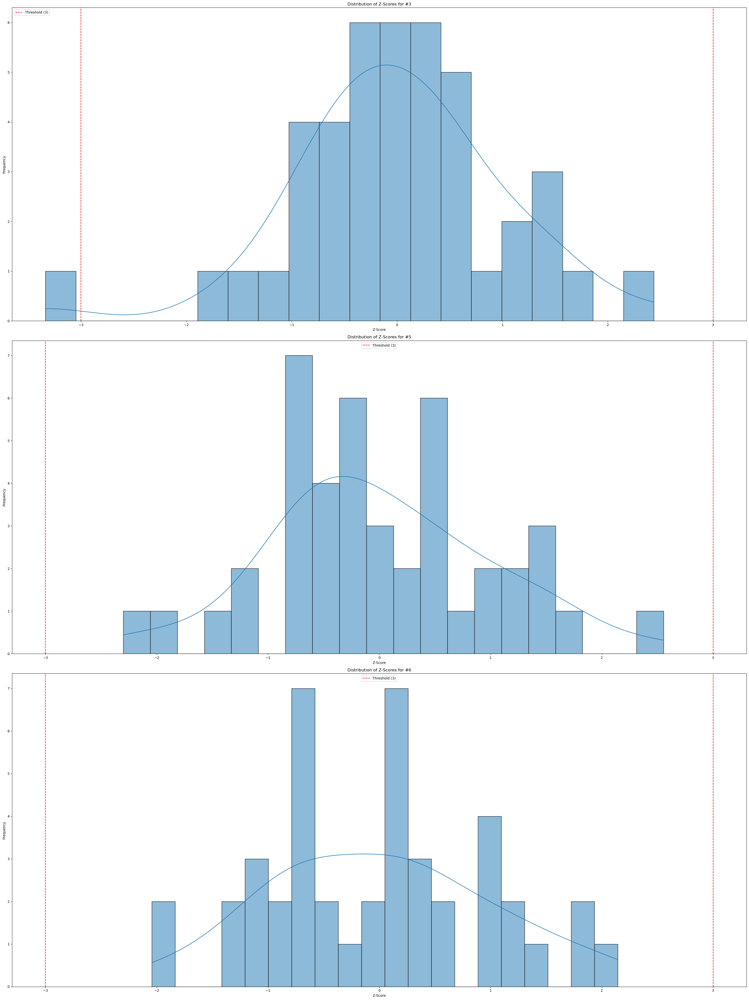

In [63]:
# Function to identify z-scores
def calculate_zscore(data):
    mean = data.mean()
    std_dev = data.std()
    z_scores = (data - mean) / std_dev
    return z_scores

# Apply the function to calculate z-scores
sales_normal['Z-Score'] = sales_normal.groupby('GCK')['Sales €'].transform(calculate_zscore)

# Create distribution plots of z-scores for each product
plt.figure(figsize=(30, 40))
for product, group_data in sales_normal.groupby('GCK'):
    plt.subplot(3, 1, list(sales_normal['GCK'].unique()).index(product) + 1)
    sns.histplot(data=group_data, x='Z-Score', bins=20, kde=True)
    plt.title(f'Distribution of Z-Scores for {product}')
    plt.xlabel('Z-Score')
    plt.ylabel('Frequency')
    plt.axvline(x=3, color='red', linestyle='--', label='Threshold (3)')
    plt.axvline(x=-3, color='red', linestyle='--')
    plt.legend()

plt.tight_layout()
plt.show()

In [64]:
sales_normal["GCK"].unique()

array(['#3', '#5', '#6'], dtype=object)

* Only three of the products present a Normal Distribution, and by those standards product #3 has one outlier

**Interquartile Range**

* Since most of the products do not follow a Normal Distribution IQR can be helpfull do detect outliers

In [65]:
# Function to identify outliers using IQR
def detect_outliers_iqr(data):
    quartile_1, quartile_3 = np.percentile(data, [25, 75])
    iqr = quartile_3 - quartile_1
    lower_bound = quartile_1 - (1.5 * iqr)
    upper_bound = quartile_3 + (1.5 * iqr)
    return (data < lower_bound) | (data > upper_bound)

# Create an empty list to store outlier indices
outlier_indices = []

# Iterate over groups
for group_name, group_data in sales_copy.groupby('GCK')['Sales €']:
    # Detect outliers for the current group
    outliers_group = group_data.pipe(detect_outliers_iqr)
    # Append outlier indices to the list
    outlier_indices.extend(group_data[outliers_group].index)

# Filter the DataFrame using outlier indices
outliers_df_iqr = sales_copy.loc[outlier_indices]

# Print the DataFrame containing outliers detected using IQR
outliers_df_iqr

,Full_Date,GCK,Sales €,COVID_Impact
14,2018-11-01,#1,5.140760e+06,0
378,2021-01-01,#1,2.718043e+07,1
17,2018-11-01,#13,6.818000e+04,0
171,2019-10-01,#13,6.575455e+04,0
409,2021-03-01,#13,6.309275e+04,1
116,2019-06-01,#14,6.301771e+04,0
466,2021-07-01,#14,7.616144e+04,1
578,2022-03-01,#14,4.610024e+04,1
19,2018-11-01,#16,1.377694e+06,0
33,2018-12-01,#16,4.762524e+06,0


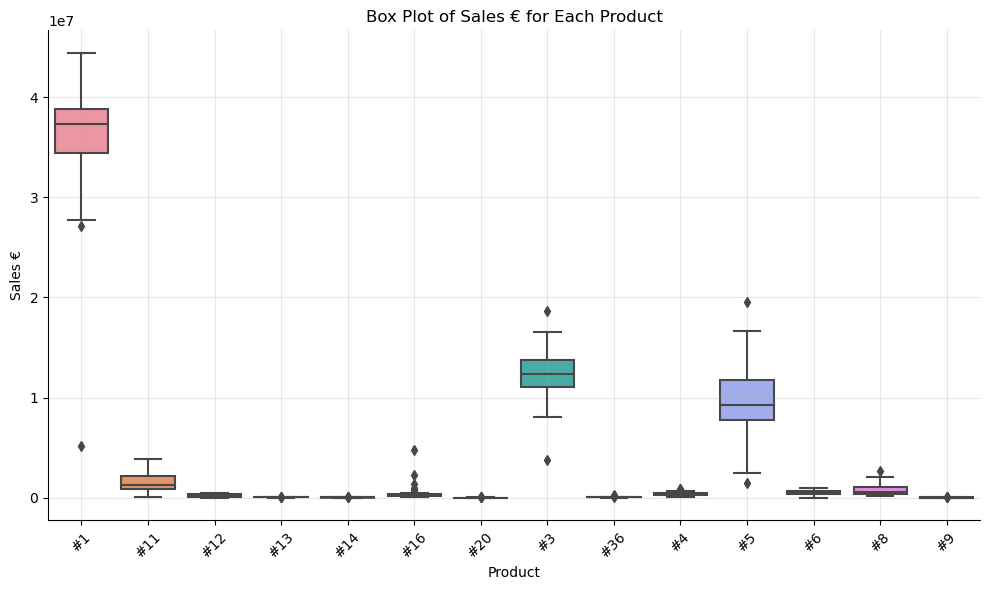

In [66]:
# Create a box plot for each product
plt.figure(figsize=(10, 6))
sns.boxplot(x='GCK', y='Sales €', data=sales_copy)
plt.title('Box Plot of Sales € for Each Product')
plt.xlabel('Product')
plt.ylabel('Sales €')
plt.xticks(rotation=45)

# Decorations
plt.grid(alpha=0.3) 
plt.tight_layout()
sns.despine()
plt.show()

* Overall, although IQR shows a lot of outliers we will consider only the lowest value in product #1... and for product #3 and #5, since these follow a Normal Distribution, we will give a higher importance to the previous graph

* This means that only 2 values need to be treated one for product #1 in November 2018, and another for product #3 in January 2021

In [67]:
# For product #1 (2018-11-01) we will substitute the outlier by the mean of the first 4 months

# Filter the DataFrame for product #1 and the first 6 months
mean_sales_product_1_first_6_months = sales_copy.query('GCK == "#1" and Full_Date < "2019-04-30"')['Sales €'].mean()

sales_copy.loc[sales_copy.query('GCK == "#1" and Full_Date == "2018-11-01"').index, 'Sales €'] = mean_sales_product_1_first_6_months

# For product #3 (2021-01-01) since it follows a normal distribution we will use Z-score 


In [68]:
# Calculate mean and standard deviation
mean_sales = sales_copy[sales_copy['GCK'] == "#3"]["Sales €"].mean()
std_dev_sales = sales_copy[sales_copy['GCK'] == "#3"]["Sales €"].std()

# Fill
sales_copy.loc[sales_copy.query('GCK == "#3" and Full_Date == "2021-01-01"').index, 'Sales €'] = round(mean_sales - 2.9 * std_dev_sales,2)


In [69]:
# Repeating the Normality Test
normality_results2 = sales_copy.groupby('GCK')['Sales €'].apply(check_normality)

# Print the results
for product, is_normal in normality_results2.items():
    if is_normal:
        print(f"Product {product}: {Style.BRIGHT}Normally Distributed{Style.RESET_ALL}")
    else:
        print(f"Product {product}: Not Normally Distributed")

Product #1: Normally Distributed
Product #11: Not Normally Distributed
Product #12: Not Normally Distributed
Product #13: Not Normally Distributed
Product #14: Not Normally Distributed
Product #16: Not Normally Distributed
Product #20: Not Normally Distributed
Product #3: Normally Distributed
Product #36: Not Normally Distributed
Product #4: Not Normally Distributed
Product #5: Normally Distributed
Product #6: Normally Distributed
Product #8: Not Normally Distributed
Product #9: Not Normally Distributed


* Note: Product #1 follows a normal distribution after removing the outliers!!

In [70]:
market_copy

,Month Year,China Production Index M&E,France Production Index M&E,France Shipments Index M&E,Germany Production Index M&E,Germany Shipments Index M&E,Italy Production Index M&E,Italy Shipments Index M&E,Japan Production Index M&E,Switzerland Production Index M&E,UK Production Index M&E,US Production Index M&E,US Shipments Index M&E,Europe Production Index M&E,Europe Shipments Index M&E,Price of Base Metals,Price of Energy,Price of Natural gas index,United States: EUR in LCU,US Producer Prices Electrical eq.,France Producer Prices Electrical eq.,China Producer Prices Electrical eq.,Global Production Index Machinery eq.,Switzerland Production Index Machinery eq.,US Production Index Electrical eq.,Global Production Index Electrical eq.,Switzerland Production Index Electrical eq.,UK Production Index Electrical eq.,Italy Production Index Electrical eq.,Japan Production Index Electrical eq.,France Production Index Electrical eq.,Germany Production Index Electrical eq.
0,2004-02-01,16.937500,112.0625,83.4375,82.6250,79.4375,124.3125,86.5625,109.3125,91.2500,111.3750,107.6250,79.2500,97.1250,80.1250,54.03125,44.12500,87.0625,1.264648,79.0000,NaN,NaN,97.6250,97.1250,117.7500,NaN,81.12500,120.6875,141.5000,106.1875,102.0625,85.9375
1,2004-03-01,23.718750,136.3750,106.1875,100.5625,97.0000,143.3750,106.3750,140.8750,85.8750,127.5625,110.1875,98.6250,113.8125,96.0000,54.65625,47.59375,87.1875,1.226562,79.6875,NaN,NaN,113.2500,91.1875,119.2500,NaN,76.68750,138.2500,152.8750,140.2500,117.2500,97.6875
2,2004-04-01,24.437500,117.8125,92.0000,89.6250,84.9375,129.1250,95.5625,105.8750,85.6250,108.7500,108.1875,89.7500,101.6875,85.1875,54.87500,47.78125,91.3750,1.198242,80.3125,NaN,NaN,100.1875,93.8125,117.4375,NaN,71.56250,115.5625,137.7500,106.2500,105.3125,87.2500
3,2004-05-01,23.703125,109.0000,85.6875,86.8750,82.3750,135.6250,100.0625,101.8750,85.3750,110.6250,108.4375,87.4375,101.2500,84.5000,51.21875,53.59375,99.0625,1.201172,80.8125,NaN,NaN,99.5625,96.3750,117.8750,NaN,66.43750,119.2500,143.8750,101.6250,96.6250,84.6875
4,2004-06-01,27.015625,133.7500,106.6250,99.0000,95.1250,136.3750,110.8750,120.3125,85.1250,122.0000,110.5625,97.3750,112.0625,96.9375,52.87500,50.81250,98.6250,1.213867,80.9375,NaN,NaN,109.2500,99.0000,119.5000,NaN,61.28125,128.8750,144.3750,116.6250,118.4375,95.3750
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
214,2021-12-01,310.750000,100.5625,134.6250,118.1250,149.3750,94.0000,150.5000,127.7500,106.6875,101.2500,107.0625,148.6250,123.0625,150.0000,125.18750,112.37500,236.5000,1.130859,128.5000,108.1875,98.1250,134.6250,102.2500,109.6250,132.250,114.31250,121.0625,72.9375,109.0000,80.7500,97.7500
215,2022-01-01,236.000000,85.7500,108.1875,94.5625,120.3750,86.8750,101.2500,110.4375,103.5000,95.0000,111.0625,129.6250,103.1875,120.3125,133.25000,121.31250,196.8750,1.131836,131.6250,111.0625,98.2500,117.5000,100.3125,111.3750,122.250,109.00000,112.3125,74.3750,95.3750,77.9375,98.6250
216,2022-02-01,236.000000,90.6250,117.6875,104.0000,129.3750,106.5625,120.9375,117.8750,100.3125,98.4375,116.3125,138.5000,113.5000,131.5000,138.87500,131.25000,197.5000,1.133789,133.3750,112.0625,98.6875,124.6250,98.3125,114.6875,127.375,103.68750,115.5625,91.1875,103.9375,79.0000,106.1250
217,2022-03-01,329.500000,107.8125,136.8750,121.3125,151.2500,124.6250,153.6250,152.0000,97.0625,122.0000,117.6250,165.8750,133.1250,158.0000,149.87500,163.12500,271.0000,1.101562,136.1250,112.3750,99.0000,149.3750,96.3750,115.1875,152.500,98.37500,145.2500,102.5000,133.7500,96.6875,119.9375


In [71]:
market_copy.columns

Index(['Month Year', 'China Production Index M&E',
       'France Production Index M&E', 'France Shipments Index M&E',
       'Germany Production Index M&E', 'Germany Shipments Index M&E',
       'Italy Production Index M&E', 'Italy Shipments Index M&E',
       'Japan Production Index M&E', 'Switzerland Production Index M&E',
       'UK Production Index M&E', 'US Production Index M&E',
       'US Shipments Index M&E', 'Europe Production Index M&E',
       'Europe Shipments Index M&E', 'Price of Base Metals', 'Price of Energy',
       'Price of Natural gas index', 'United States: EUR in LCU',
       'US Producer Prices Electrical eq.',
       'France Producer Prices Electrical eq.',
       'China Producer Prices Electrical eq.',
       'Global Production Index Machinery eq.',
       'Switzerland Production Index Machinery eq.',
       'US Production Index Electrical eq.',
       'Global Production Index Electrical eq.',
       'Switzerland Production Index Electrical eq.',
       'UK Pr

<a class="anchor" id="3_6">
    
## 3.6. Feature Selection
    
    
</a>

In [72]:
# Creating a dataframe for each product sales
for product_name in sales_copy["GCK"].unique():
    
    # Modify product name to ensure it's a valid variable name
    valid_product_name = re.sub(r'\W+', '_', product_name)
    
    # Dynamically create variable name based on product name
    globals()[f"sales{valid_product_name}"] = sales_copy[sales_copy["GCK"] == product_name]

**LAGGING MACROECONOMIC FEATURES**

In [73]:
# Set 'Month Year' as index
market_copy['Month Year'] = pd.to_datetime(market_copy['Month Year'])
market_copy.set_index('Month Year', inplace=True)

# Define lag periods
lag_periods = range(1, 13)

# Create a dictionary to store lagged datasets
lagged_datasets = {}

# Generate lagged datasets
for lag in lag_periods:
    start_date = pd.to_datetime('2018-09-01') - pd.DateOffset(months=lag)
    end_date = pd.to_datetime('2022-03-01') - pd.DateOffset(months=lag)
    lagged_datasets[f'market_lag{lag}'] = market_copy[start_date:end_date].reset_index(drop=True)
    
# Access lagged datasets
market_lag1 = lagged_datasets['market_lag1']
market_lag2 = lagged_datasets['market_lag2']
market_lag3 = lagged_datasets['market_lag3']
market_lag4 = lagged_datasets['market_lag4']
market_lag5 = lagged_datasets['market_lag5']
market_lag6 = lagged_datasets['market_lag6']
market_lag7 = lagged_datasets['market_lag7']
market_lag8 = lagged_datasets['market_lag8']
market_lag9 = lagged_datasets['market_lag9']
market_lag10 = lagged_datasets['market_lag10']
market_lag11 = lagged_datasets['market_lag11']
market_lag12 = lagged_datasets['market_lag12']

In [74]:
def find_lag(product_code):
    """ 
    This function identifies the most significant lag for each macroeconomic index with respect to a given product group's sales data. 
    
    Args:
        product_code (int): The code corresponding to the product group for which the analysis is performed.
        
    Returns:
        pandas.DataFrame: A DataFrame containing the original sales data along with the most important lag features 
        for each macroeconomic index identified through Spearman correlation analysis.
    """

    # Select sales data based on product code
    sales_data = globals()["sales_" + str(product_code)].reset_index(drop=True)

    # Initialize DataFrame to store lag features
    data_with_lags = sales_data.copy()
    
    # List to store the most important lag for each feature
    most_important = [] 

    # Loop through each feature in the market_copy DataFrame
    for feature in market_copy.columns:
        # Initialize DataFrame to store lag features for the current feature
        lag_features = pd.DataFrame()
        
        # Create lag features for the current feature
        for lag in range(1, 13):
            lag_feature = globals()[f"market_lag{lag}"][feature].rename(f"{feature} LAG{lag}")
            lag_features = pd.concat([lag_features, lag_feature], axis=1)
        
        # Concatenate lag features with sales data
        df_lags = pd.concat([lag_features, sales_data['Sales €']], axis=1)
        
        # Calculate Spearman correlation matrix
        cor_spearman = df_lags.corr(method='spearman')
        cor_spearman = cor_spearman.mask(np.triu(np.ones(cor_spearman.shape)).astype(bool))
        
        # Find the most important lag for the current feature
        most_important_lag = abs(cor_spearman.loc['Sales €', :]).idxmax()
        most_important.append(most_important_lag)
        
        # Add the most important lag feature to the DataFrame with lags
        data_with_lags = pd.concat([data_with_lags, df_lags[most_important_lag]], axis=1)
    
    return data_with_lags

In [75]:
# Sales #1
sales_lag1 = find_lag(1)
sales_lag1.set_index("Full_Date", inplace=True)
sales_lag1.drop("GCK", axis=1, inplace=True)

# Sales #3
sales_lag3 = find_lag(3)
sales_lag3.set_index("Full_Date", inplace=True)
sales_lag3.drop("GCK", axis=1, inplace=True)

# Sales #4
sales_lag4 = find_lag(4)
sales_lag4.set_index("Full_Date", inplace=True)
sales_lag4.drop("GCK", axis=1, inplace=True)

# Sales #5
sales_lag5 = find_lag(5)
sales_lag5.set_index("Full_Date", inplace=True)
sales_lag5.drop("GCK", axis=1, inplace=True)

# Sales #6
sales_lag6 = find_lag(6)
sales_lag6.set_index("Full_Date", inplace=True)
sales_lag6.drop("GCK", axis=1, inplace=True)

# Sales #8
sales_lag8 = find_lag(8)
sales_lag8.set_index("Full_Date", inplace=True)
sales_lag8.drop("GCK", axis=1, inplace=True)

# Sales #9
sales_lag9 = find_lag(9)
sales_lag9.set_index("Full_Date", inplace=True)
sales_lag9.drop("GCK", axis=1, inplace=True)

# Sales #11
sales_lag11 = find_lag(11)
sales_lag11.set_index("Full_Date", inplace=True)
sales_lag11.drop("GCK", axis=1, inplace=True)

# Sales #12
sales_lag12 = find_lag(12)
sales_lag12.set_index("Full_Date", inplace=True)
sales_lag12.drop("GCK", axis=1, inplace=True)

# Sales #13
sales_lag13 = find_lag(13)
sales_lag13.set_index("Full_Date", inplace=True)
sales_lag13.drop("GCK", axis=1, inplace=True)

# Sales #14
sales_lag14 = find_lag(14)
sales_lag14.set_index("Full_Date", inplace=True)
sales_lag14.drop("GCK", axis=1, inplace=True)

# Sales #16
sales_lag16 = find_lag(16)
sales_lag16.set_index("Full_Date", inplace=True)
sales_lag16.drop("GCK", axis=1, inplace=True)

# Sales #20
sales_lag20 = find_lag(20)
sales_lag20.set_index("Full_Date", inplace=True)
sales_lag20.drop("GCK", axis=1, inplace=True)

# Sales #36
sales_lag36 = find_lag(36)
sales_lag36.set_index("Full_Date", inplace=True)
sales_lag36.drop("GCK", axis=1, inplace=True)

**LAGGING SALES**

In [76]:
# List of lag dataframes and corresponding dataset names
lag_datasets = [(sales_lag1, 'Sales 1'), 
                (sales_lag3, 'Sales 3'), 
                (sales_lag4, 'Sales 4'), 
                (sales_lag5, 'Sales 5'), 
                (sales_lag6, 'Sales 6'), 
                (sales_lag8, 'Sales 8'), 
                (sales_lag9, 'Sales 9'), 
                (sales_lag11, 'Sales 11'), 
                (sales_lag12, 'Sales 12'), 
                (sales_lag13, 'Sales 13'), 
                (sales_lag14, 'Sales 14'), 
                (sales_lag16, 'Sales 16'), 
                (sales_lag20, 'Sales 20'), 
                (sales_lag36, 'Sales 36')]

Autocorrelation Plot:


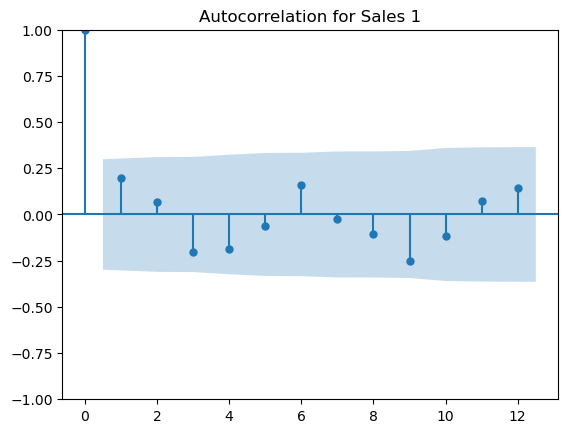

--------------------------------------------------
Relevant sales lags added to Sales 1 dataset.
Autocorrelation Plot:


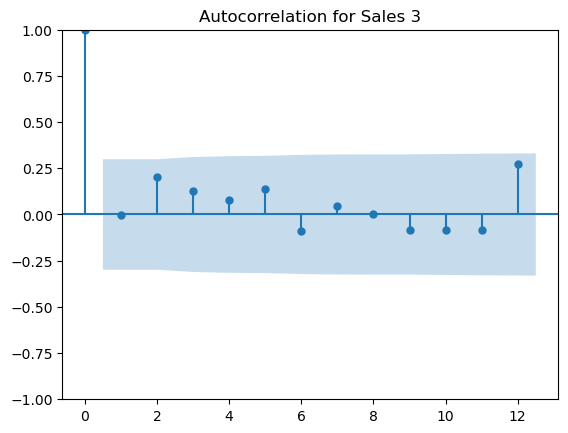

--------------------------------------------------
Relevant sales lags added to Sales 3 dataset.
Autocorrelation Plot:


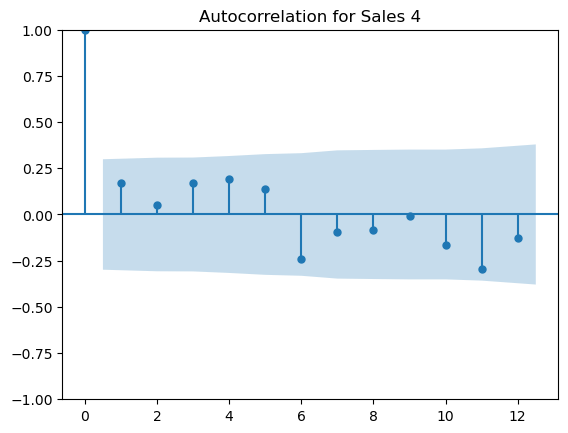

--------------------------------------------------
Relevant sales lags added to Sales 4 dataset.
Autocorrelation Plot:


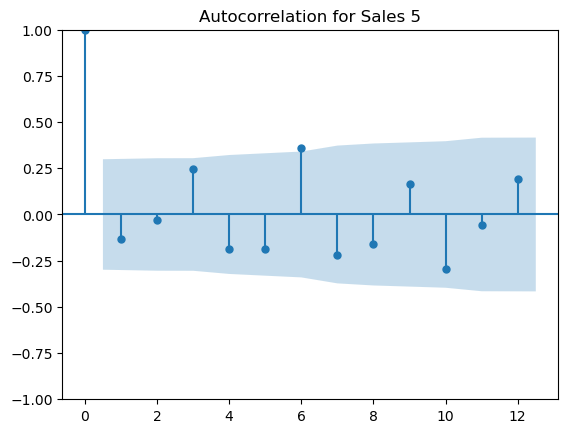

--------------------------------------------------
Relevant sales lags added to Sales 5 dataset.
Autocorrelation Plot:


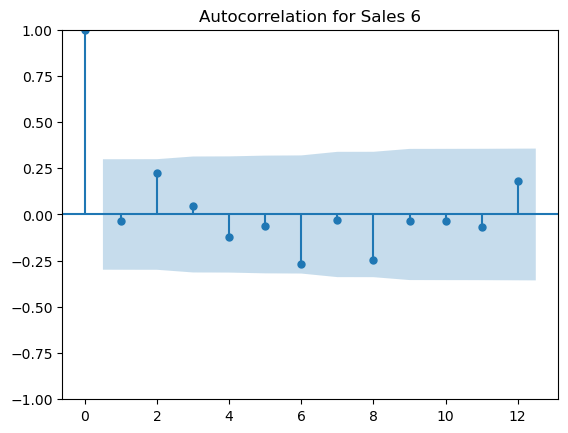

--------------------------------------------------
Relevant sales lags added to Sales 6 dataset.
Autocorrelation Plot:


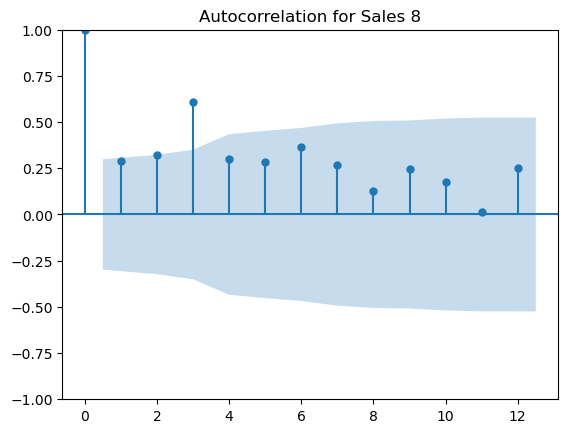

--------------------------------------------------
Relevant sales lags added to Sales 8 dataset.
Autocorrelation Plot:


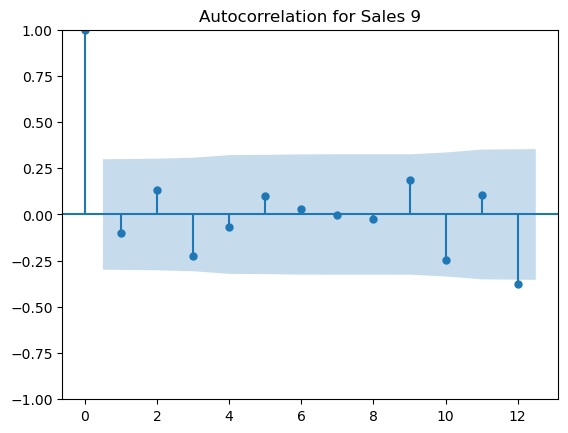

--------------------------------------------------
Relevant sales lags added to Sales 9 dataset.
Autocorrelation Plot:


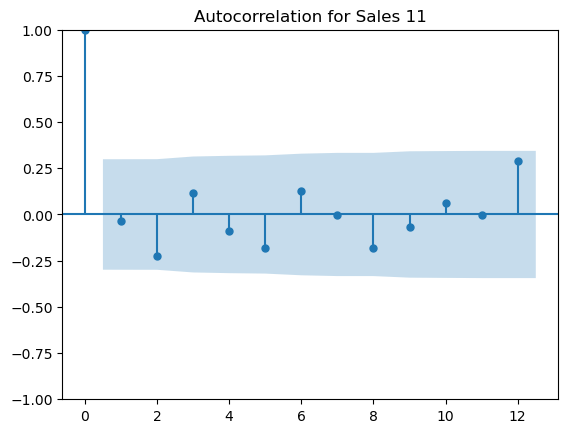

--------------------------------------------------
Relevant sales lags added to Sales 11 dataset.
Autocorrelation Plot:


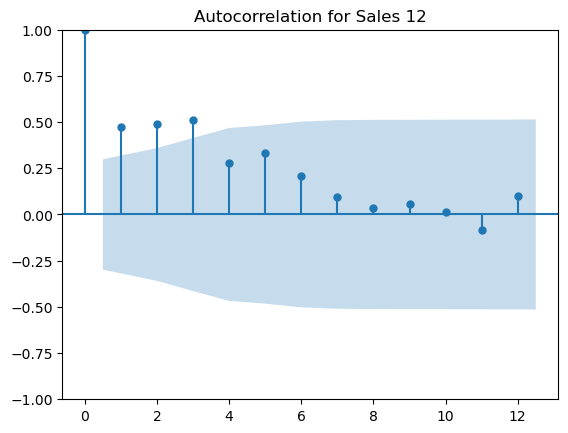

--------------------------------------------------
Relevant sales lags added to Sales 12 dataset.
Autocorrelation Plot:


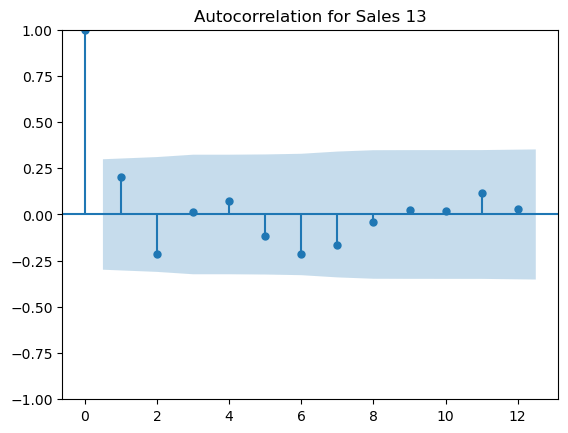

--------------------------------------------------
Relevant sales lags added to Sales 13 dataset.
Autocorrelation Plot:


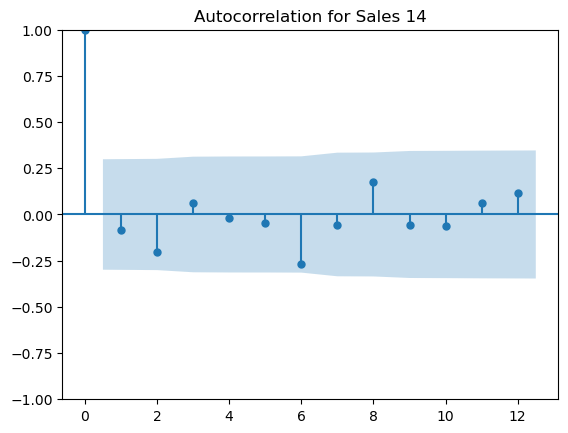

--------------------------------------------------
Relevant sales lags added to Sales 14 dataset.
Autocorrelation Plot:


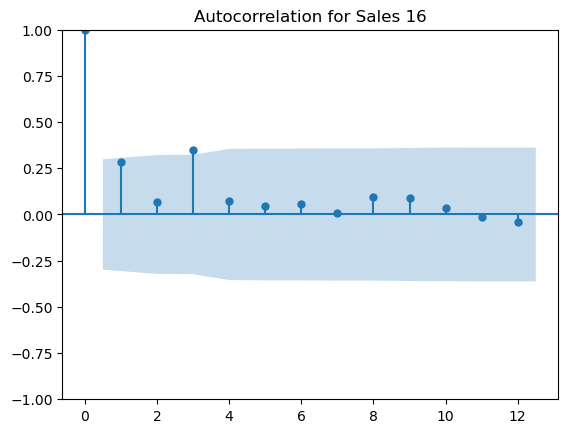

--------------------------------------------------
Relevant sales lags added to Sales 16 dataset.
Autocorrelation Plot:


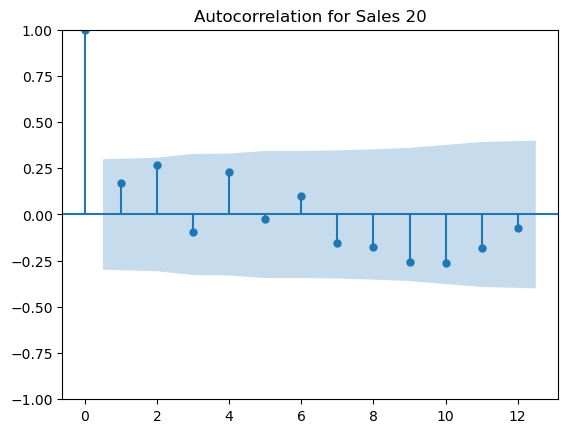

--------------------------------------------------
Relevant sales lags added to Sales 20 dataset.
Autocorrelation Plot:


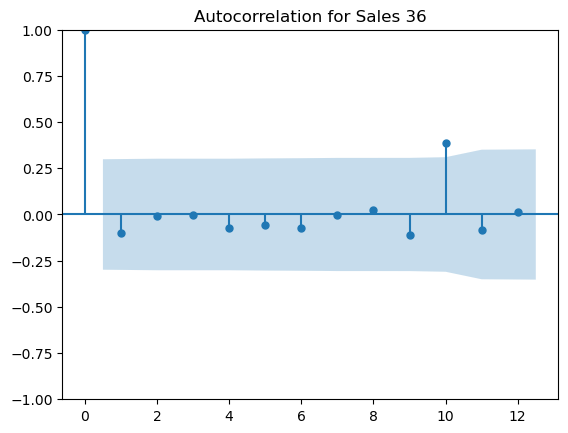

--------------------------------------------------
Relevant sales lags added to Sales 36 dataset.


In [77]:
def add_sales_lags(sales_data, data_name):
    # Plot autocorrelation
    print("\033[1mAutocorrelation Plot:\033[0m")
    plot_acf(sales_data['Sales €'], lags=12)
    plt.title(f'Autocorrelation for {data_name}')
    plt.show()
    print("-" * 50)
    
    # Calculate autocorrelation
    autocorr = sales_data['Sales €'].autocorr()

    # Find relevant lags (> 5% significance level)
    relevant_lags = []
    for lag in range(1, 7):
        corr = sales_data['Sales €'].autocorr(lag)
        if abs(corr) > 0.1:
            relevant_lags.append(lag)
    
    # Add relevant lags to lag_data
    for lag in relevant_lags:
        lag_data[f'Sales € LAG{lag}'] = sales_data['Sales €'].shift(lag)
    
    return lag_data

# Apply the function to each lag dataset
for lag_data, dataset_name in lag_datasets:
    lag_data_with_sales_lags = add_sales_lags(lag_data, dataset_name)
    print(f'Relevant sales lags added to {dataset_name} dataset.')

* Since we don't want to lose too many rows of data, we will save the data before removing the missing values caused by 12 LAGGING, this way we can see through Spearman Correlation and XGBoosting the most important features, and recovering some of the rows if possible

* So in conclusion, we believe that 6 Sales Lags is the best considering the data

In [78]:
# Copy of Lag Datasets
sales_p1 = sales_lag1.copy()
sales_p3 = sales_lag3.copy()
sales_p4 = sales_lag4.copy()
sales_p5 = sales_lag5.copy()
sales_p6 = sales_lag6.copy()
sales_p8 = sales_lag8.copy()
sales_p9 = sales_lag9.copy()
sales_p11 = sales_lag11.copy()
sales_p12 = sales_lag12.copy()
sales_p13 = sales_lag13.copy()
sales_p14 = sales_lag14.copy()
sales_p16 = sales_lag16.copy()
sales_p20 = sales_lag20.copy()
sales_p36 = sales_lag36.copy()

In [79]:
# Iterate through each lag dataset
for lag_data, dataset_name in lag_datasets:
    # Remove rows with missing values
    lag_data.dropna(inplace=True)

**Spearman Corretion**

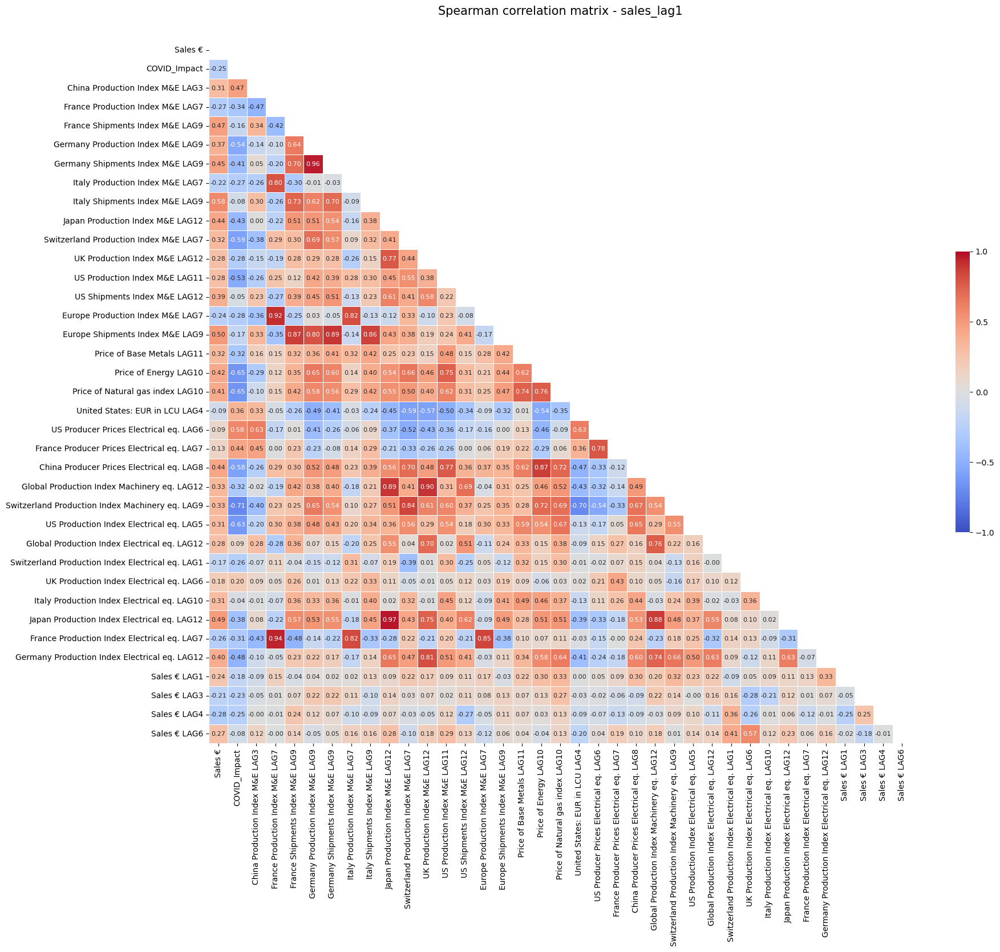

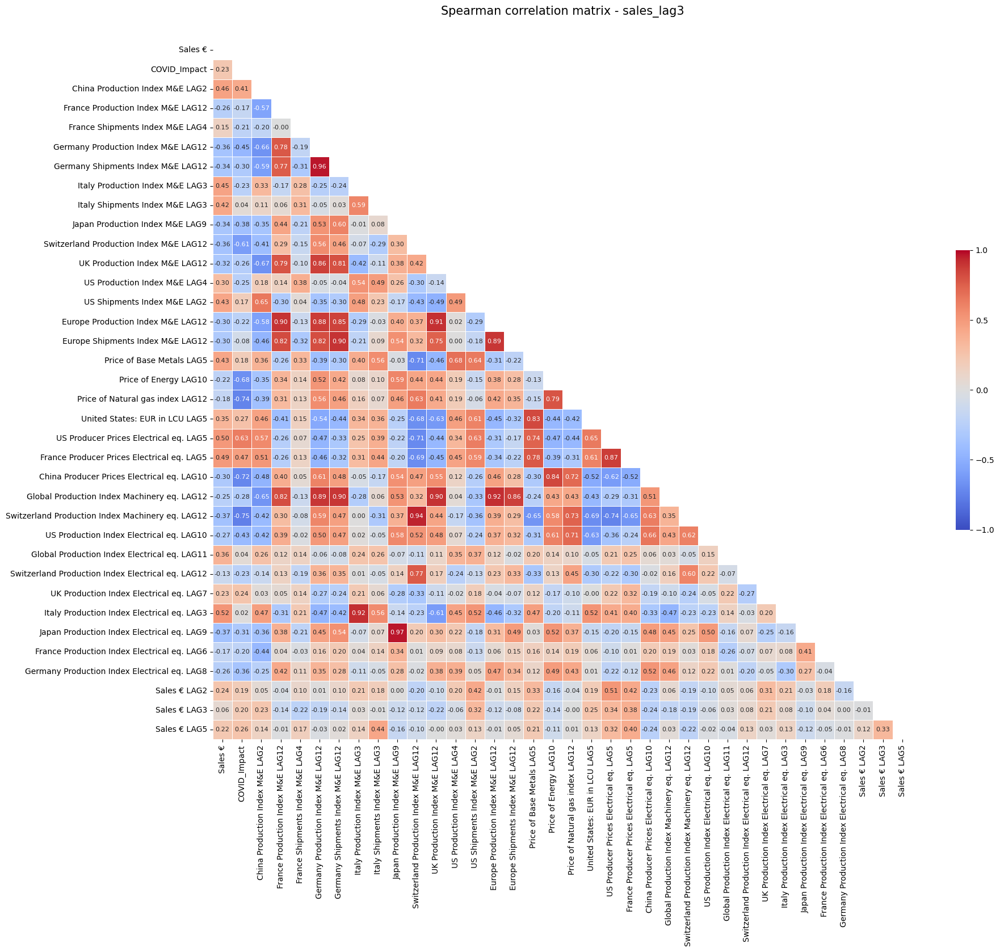

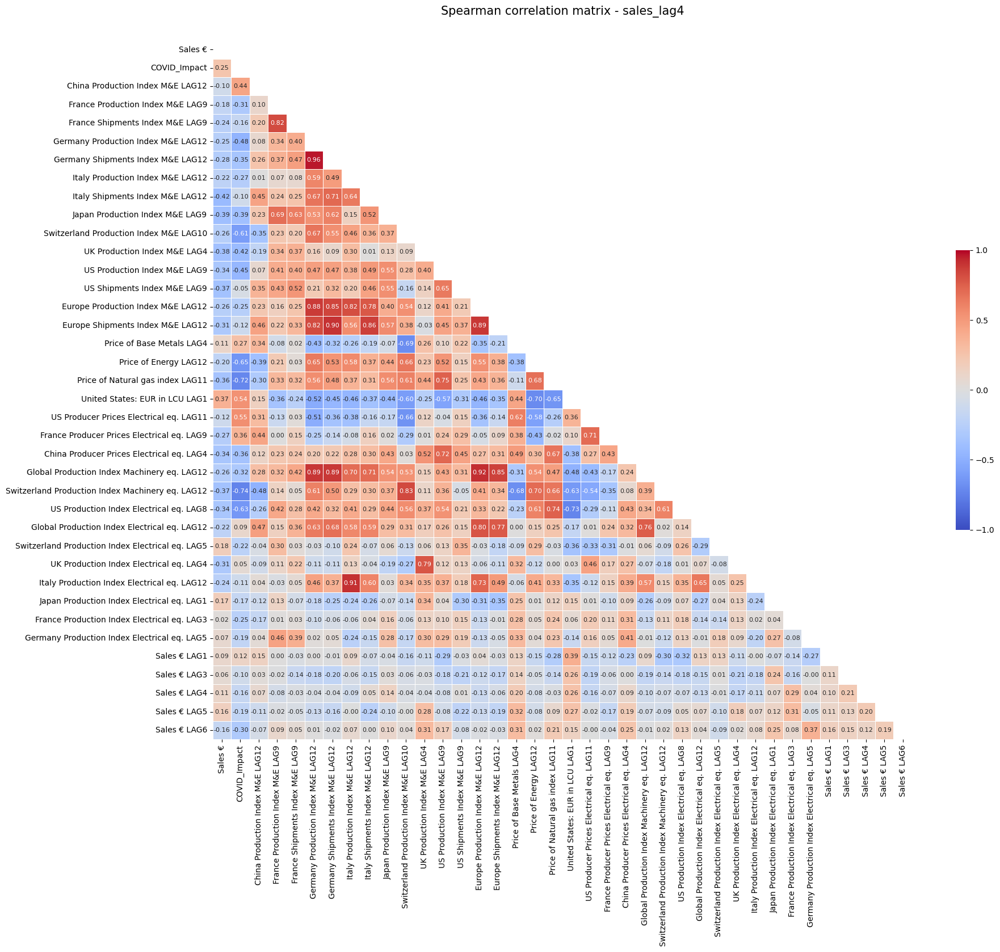

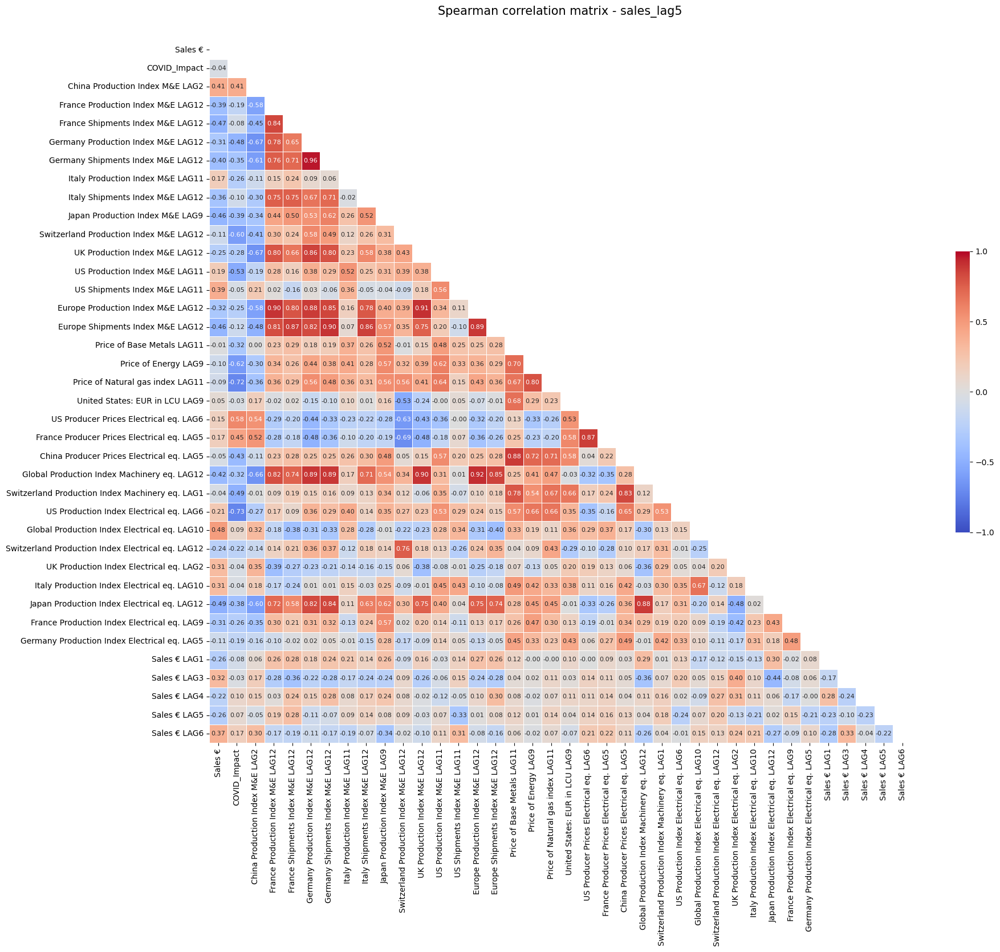

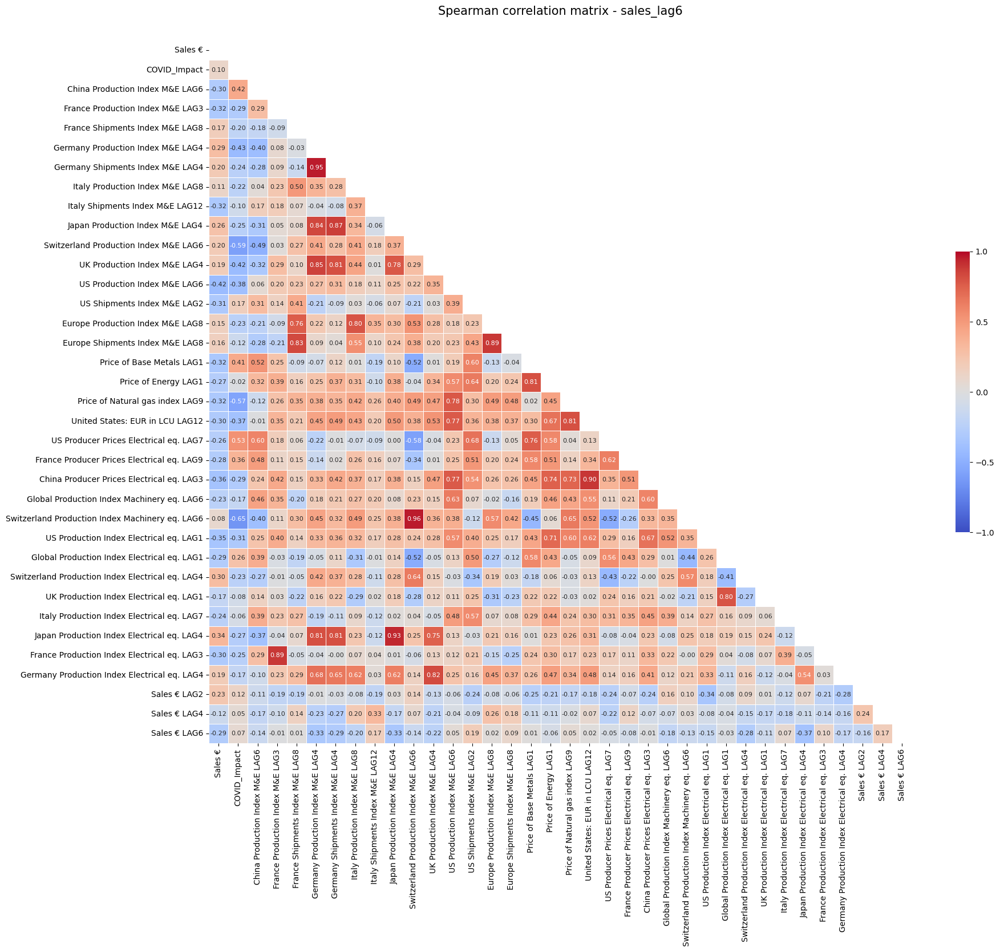

...

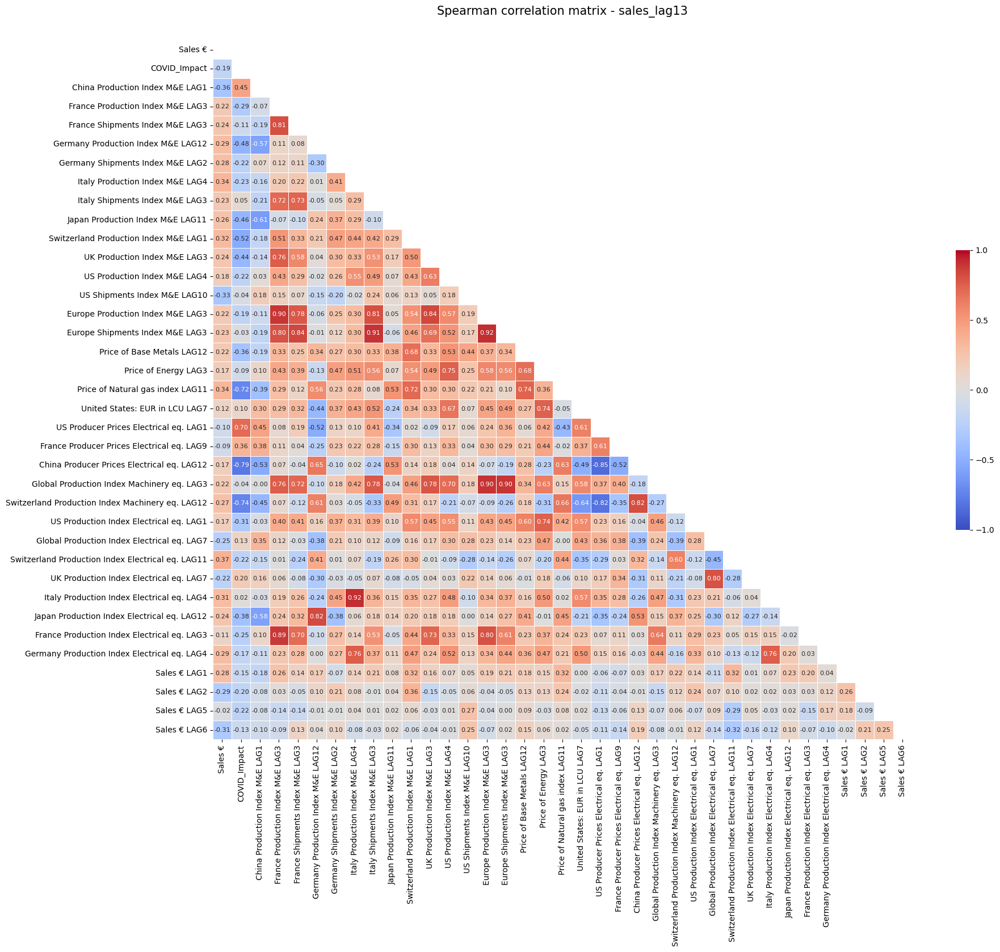

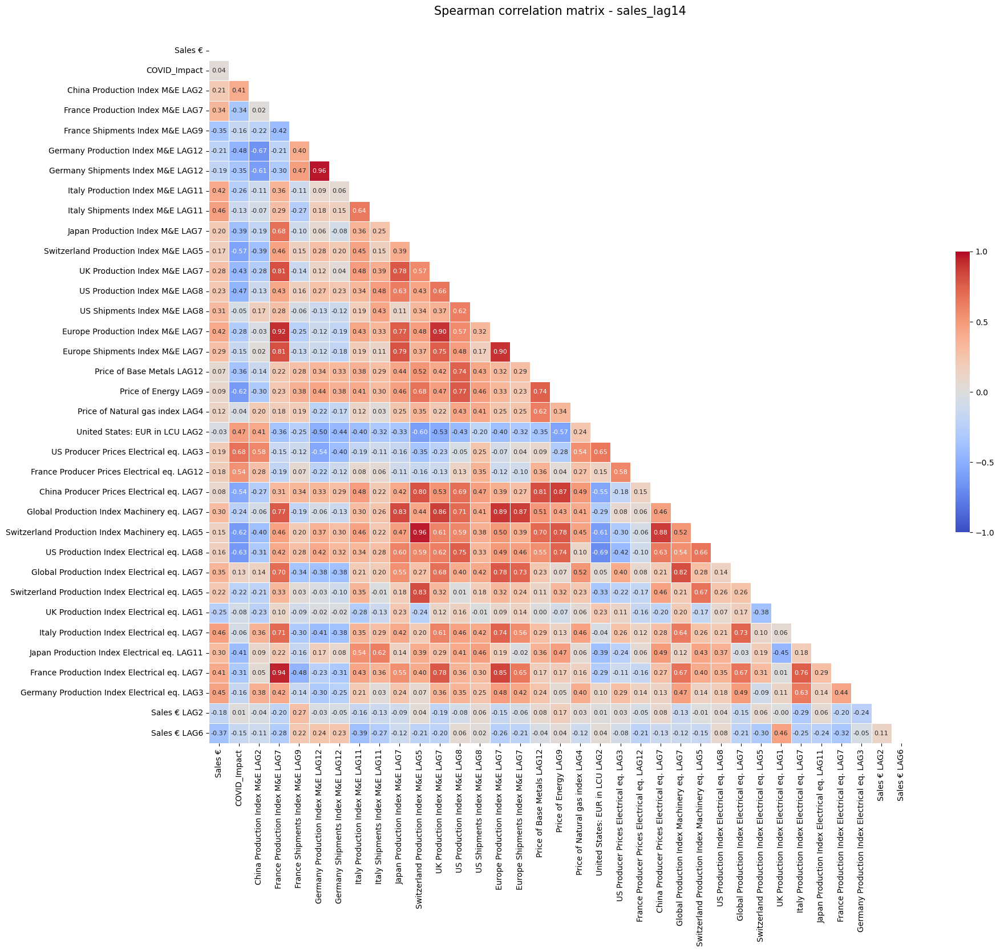

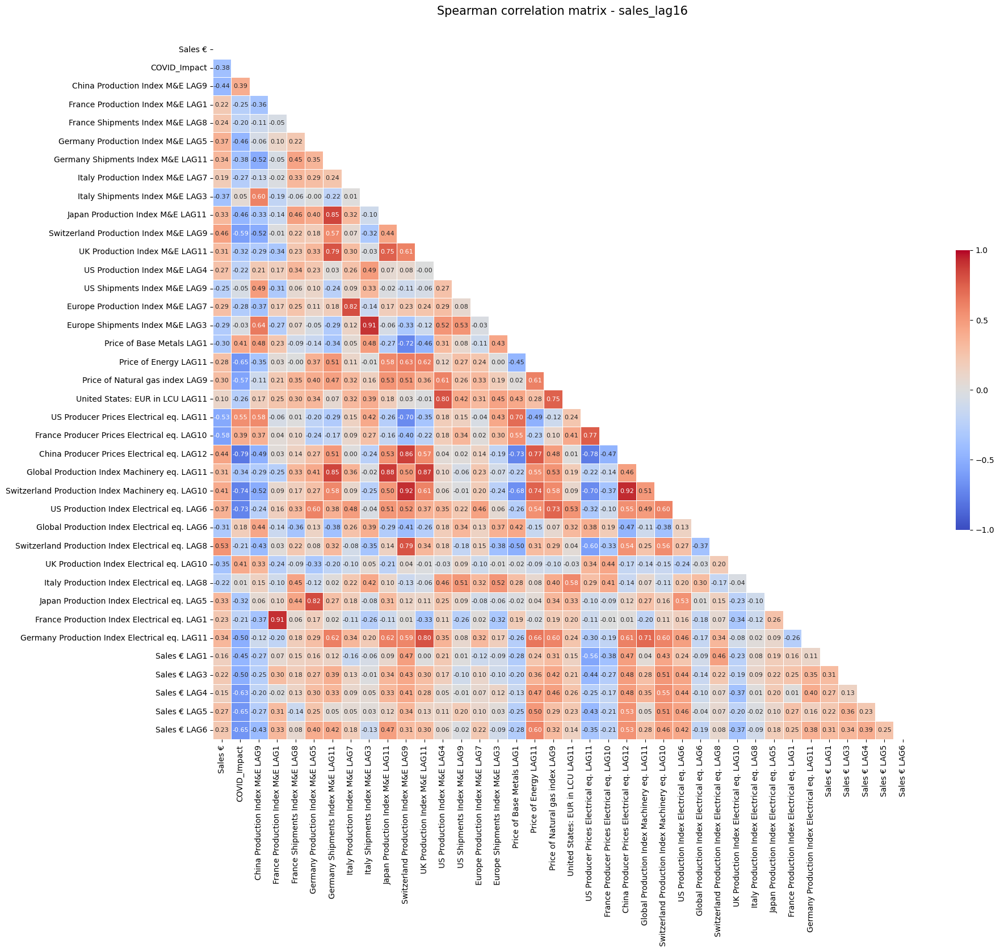

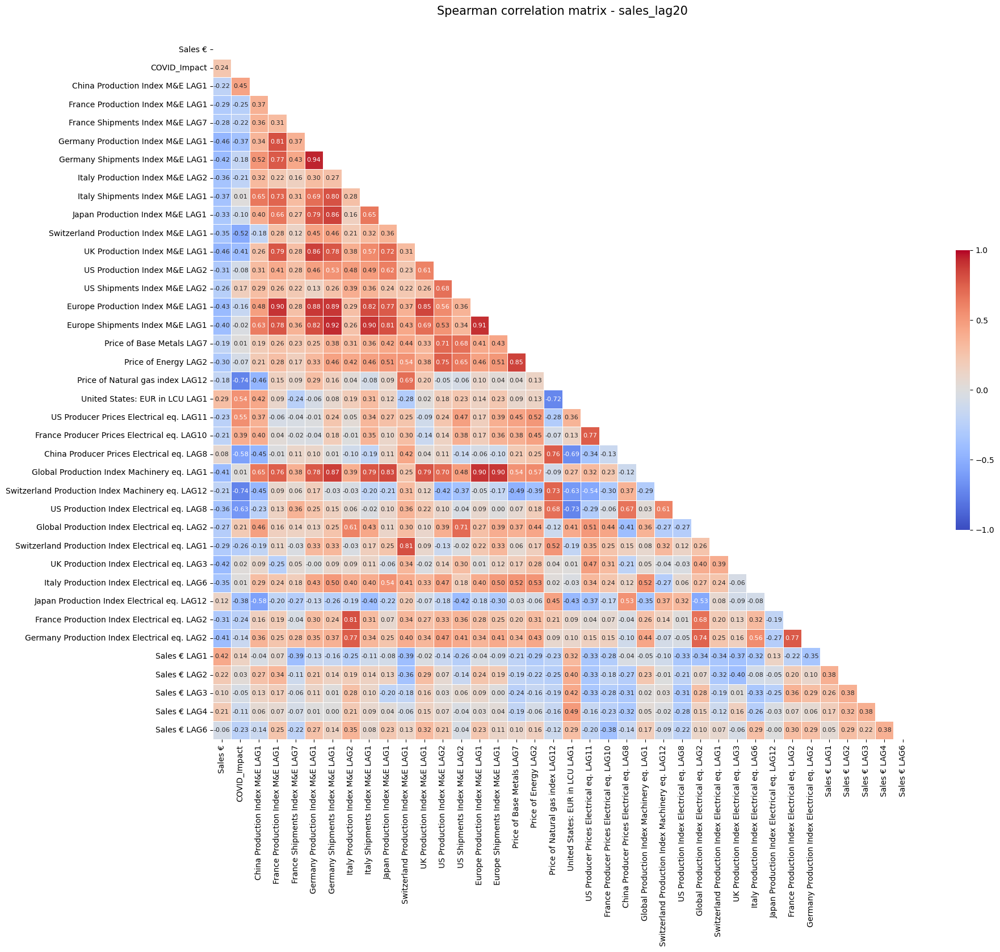

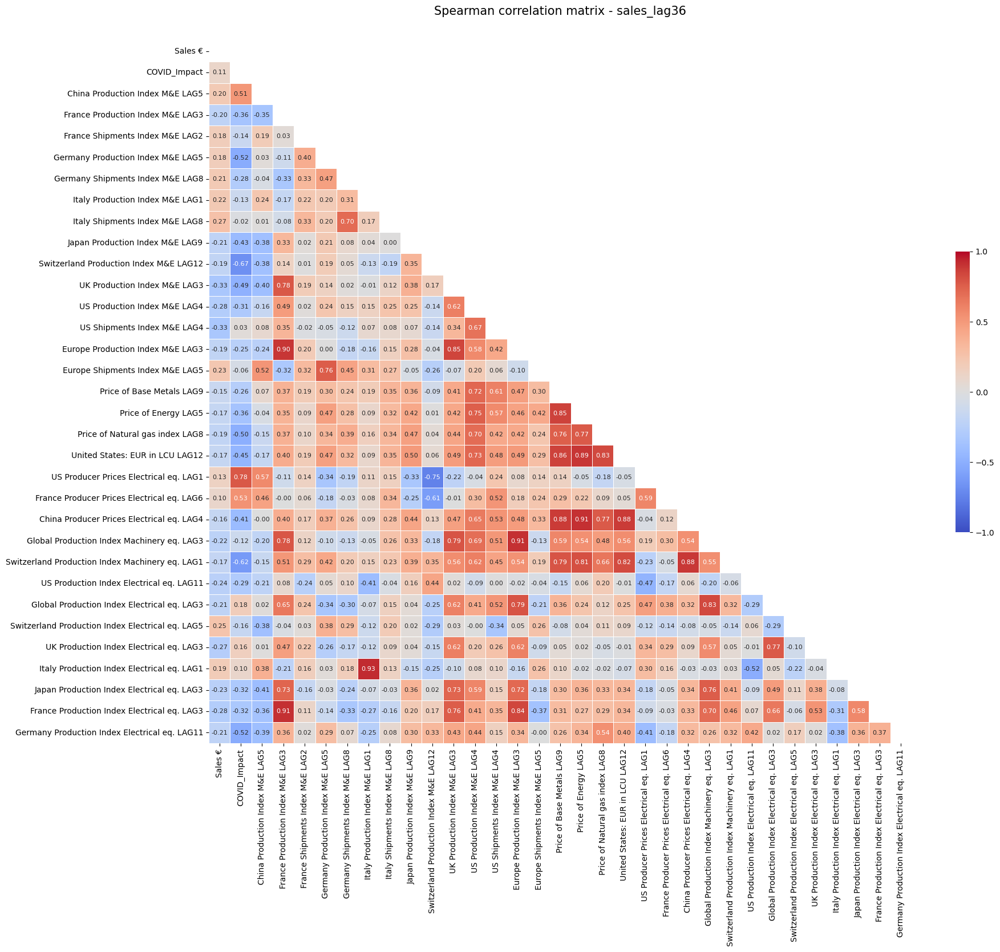

In [80]:
# Dictionary mapping dataset names to corresponding sales_lagX DataFrames
sales_lag_datasets = {
    "sales_lag1": sales_lag1, "sales_lag3": sales_lag3, "sales_lag4": sales_lag4, "sales_lag5": sales_lag5,
    "sales_lag6": sales_lag6, "sales_lag8": sales_lag8, "sales_lag9": sales_lag9, "sales_lag11": sales_lag11,
    "sales_lag12": sales_lag12, "sales_lag13": sales_lag13, "sales_lag14": sales_lag14, "sales_lag16": sales_lag16,
    "sales_lag20": sales_lag20,"sales_lag36": sales_lag36
}

# Loop through each dataset
for dataset_name, sales_lag in sales_lag_datasets.items():
    # Calculate the Spearman correlation matrix
    corr = sales_lag.corr(method='spearman')

    # Mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Create correlation matrix heatmap
    fig , ax = plt.subplots(figsize=(20, 16))  # Increase the figure size
    heatmap = sns.heatmap(corr,
                          mask=mask,
                          square=True,
                          linewidths=.5,
                          cmap='coolwarm',
                          cbar_kws={'shrink': .4,
                                    'ticks': [-1, -.5, 0, 0.5, 1]},
                          fmt='.2f',  # Adjusted format to two decimal places
                          vmin=-1,
                          vmax=1,
                          annot=True,
                          annot_kws={'size': 8})  # Adjust annotation size

    # Decoration
    plt.title(f"Spearman correlation matrix - {dataset_name}", fontsize=15, y=1.03)
    sns.set_style({'xtick.bottom': True}, {'ytick.left': True})
    plt.show()


In [81]:
# Dictionary to store correlated features for each dataset
correlated_features = {}

# Loop through each dataset
for dataset_name, sales_lag in sales_lag_datasets.items():
    # Calculate the Spearman correlation matrix
    corr = sales_lag.corr(method='spearman')
    
    # Getting correlations with sales (the target)
    sales_correlation = corr['Sales €'].abs()
    
    # Filtering features with correlation >= 0.4
    highly_correlated_features = sales_correlation[sales_correlation >= 0.4].index.tolist()
    
    # Remove sales from the list if present
    if 'Sales €' in highly_correlated_features:
        highly_correlated_features.remove('Sales €')
    
    # Choosing the less correlated feature if multiple features are highly correlated
    chosen_features = []
    for feature in highly_correlated_features:
        correlated_with_sales = corr[feature].abs().drop(index=feature)
        less_correlated_feature = correlated_with_sales.idxmax()
        chosen_features.append(less_correlated_feature)
    
    # Store the dataset's correlated features in the dictionary
    correlated_features[dataset_name] = chosen_features

# Print the list of correlated features for each dataset
for dataset_name, features in correlated_features.items():
    print(f"Dataset: {dataset_name}")
    print(f"Correlated Features: {features}\n")

Dataset: sales_lag1
Correlated Features: ['Europe Shipments Index M&E LAG9', 'Germany Production Index M&E LAG9', 'Europe Shipments Index M&E LAG9', 'Japan Production Index Electrical eq. LAG12', 'Germany Shipments Index M&E LAG9', 'China Producer Prices Electrical eq. LAG8', 'Price of Energy LAG10', 'Price of Energy LAG10', 'Japan Production Index M&E LAG12']

Dataset: sales_lag3
Correlated Features: ['UK Production Index M&E LAG12', 'Italy Production Index Electrical eq. LAG3', 'Italy Production Index M&E LAG3', 'China Production Index M&E LAG2', 'United States: EUR in LCU LAG5', 'France Producer Prices Electrical eq. LAG5', 'US Producer Prices Electrical eq. LAG5', 'Italy Production Index M&E LAG3']

Dataset: sales_lag4
Correlated Features: ['Europe Shipments Index M&E LAG12']

Dataset: sales_lag5
Correlated Features: ['UK Production Index M&E LAG12', 'Europe Shipments Index M&E LAG12', 'Germany Production Index M&E LAG12', 'Japan Production Index Electrical eq. LAG12', 'Germany Shi

**SPEARMAN CORRELATION RESULTS**

**PRODUCT 1**

* Selected Features: 5 features
* Reasoning: These 5 features showed a correlation of 0.4 or higher with the target variable, indicating a significant relationship with sales for Product 1.

**PRODUCT 3**

* Selected Features: 5 features
* Reasoning: Similar to Product 1, these 5 features displayed a correlation of 0.4 or higher with the target variable, suggesting their importance in influencing sales for Product 3.

**PRODUCT 4**

* Selected Features: 1 feature
* Reasoning: Only "Europe Shipments Index" was selected as it exhibited the highest correlation with the target compared to other features, making it the most relevant predictor for Product 4 sales.

**PRODUCT 5**

* Selected Features: 5 features
* Reasoning: These 5 features demonstrated a correlation of 0.4 or higher with the target variable, indicating their significant impact on Product 5 sales.

**PRODUCT 6**

* Selected Features: 1 feature
* Reasoning: "Price of Natural gas index LAG9" was the sole feature selected due to its higher correlation with the target compared to other features, suggesting its influence on Product 6 sales.

**PRODUCT 8**

* Selected Features: 5 features
* Reasoning: These 5 features displayed a correlation of 0.4 or higher with the target variable, indicating their importance in predicting sales for Product 8.

**PRODUCT 9**

* Selected Features: 1 feature
* Reasoning: Only "UK Production Index M&E LAG10" was selected as it exhibited the highest correlation with the target among available features for Product 9.

**PRODUCT 11**

* Selected Features: 5 features
* Reasoning: These 5 features showed a correlation of 0.4 or higher with the target variable, suggesting their significance in influencing sales for Product 11.

**PRODUCT 12**

* Selected Features: 5 features
* Reasoning: Similar to Product 11, these 5 features demonstrated a correlation of 0.4 or higher with the target variable, indicating their importance in predicting sales for Product 12.

**PRODUCT 13**

* Selected Features: 0 features
* Reasoning: No feature exhibited a correlation of 0.4 or higher with the target variable for Product 13, suggesting that none of the available features significantly impact its sales.

**PRODUCT 14**

* Selected Features: 5 features
* Reasoning: These 5 features displayed a correlation of 0.4 or higher with the target variable, indicating their importance in influencing sales for Product 14.

**PRODUCT 16**

* Selected Features: 7 features
* Reasoning: These 7 features showed a correlation of 0.4 or higher with the target variable, suggesting their significance in predicting sales for Product 16.

**PRODUCT 20**

* Selected Features: 5 features
* Reasoning: Similar to other products, these 5 features demonstrated a correlation of 0.4 or higher with the target variable, indicating their importance in predicting sales for Product 20.

**PRODUCT 36**

* Selected Features: 0 features
* Reasoning: None of the available features exhibited a correlation of 0.4 or higher with the target variable for Product 36, suggesting that none of the features significantly impact its sales.

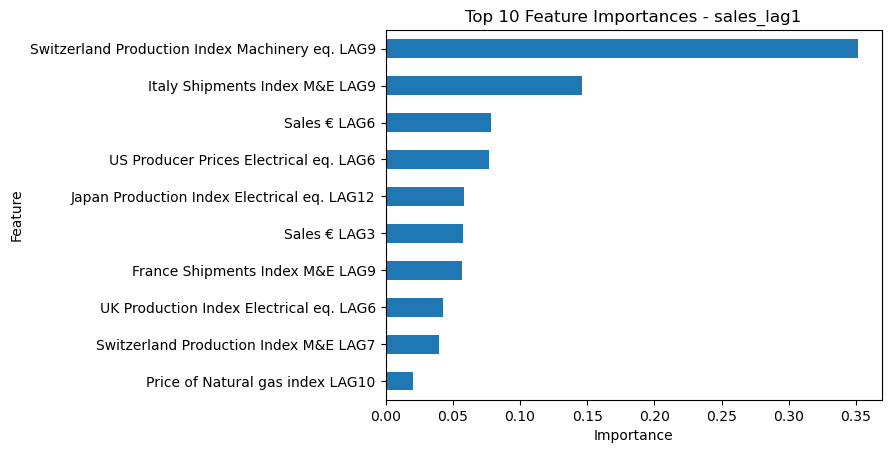

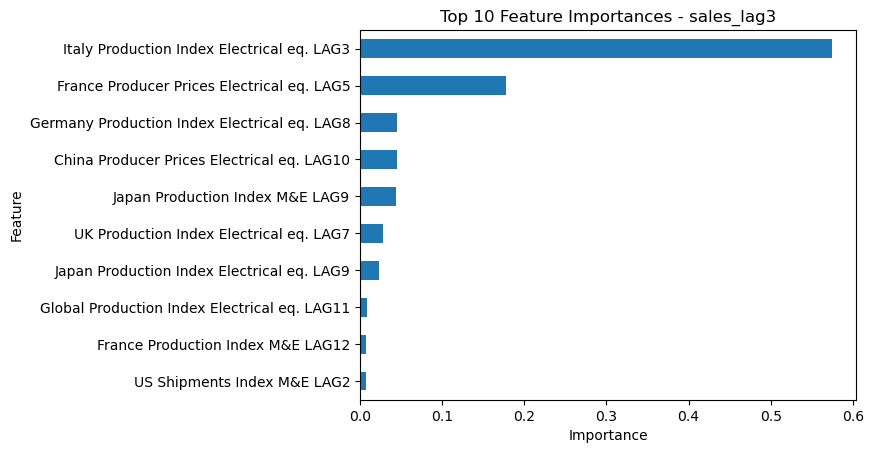

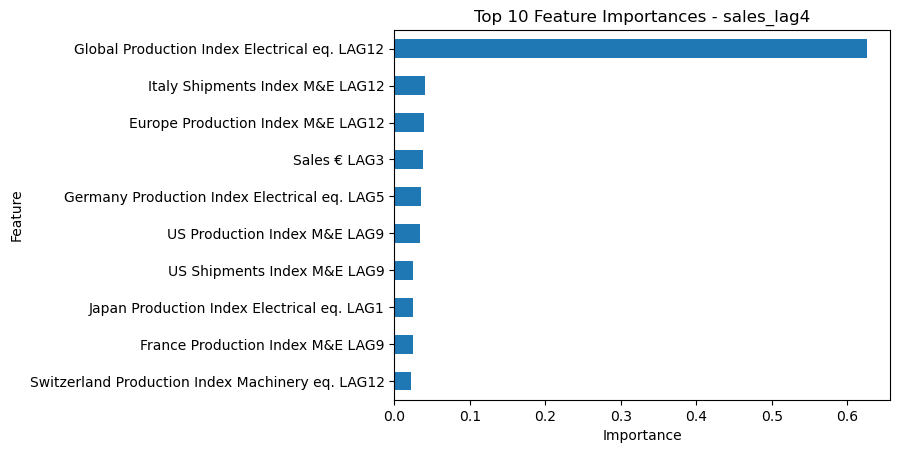

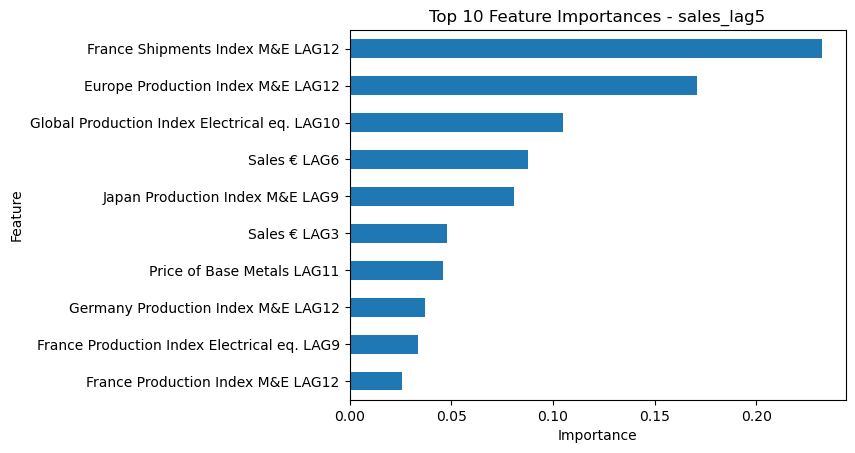

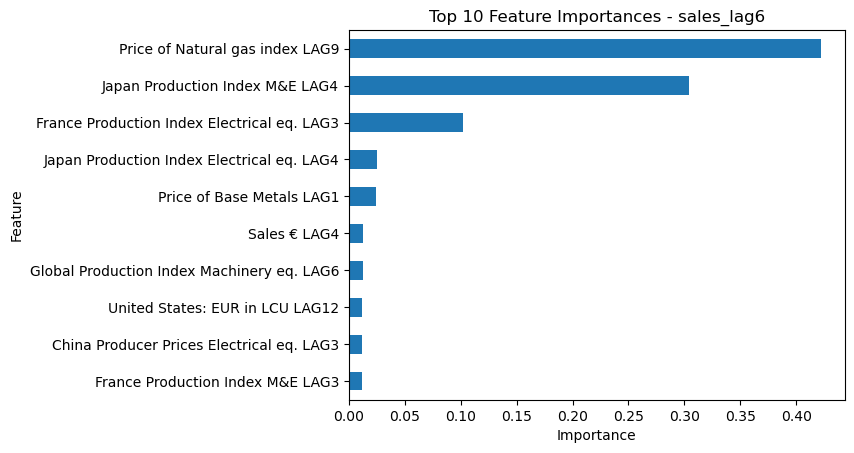

...

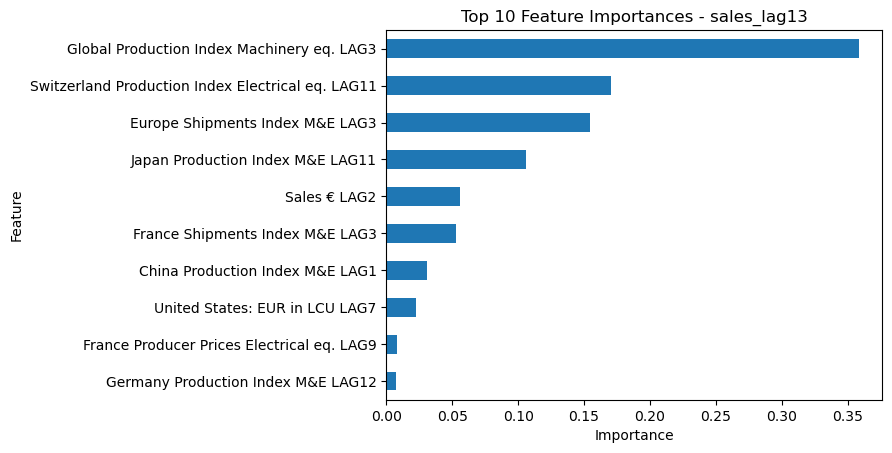

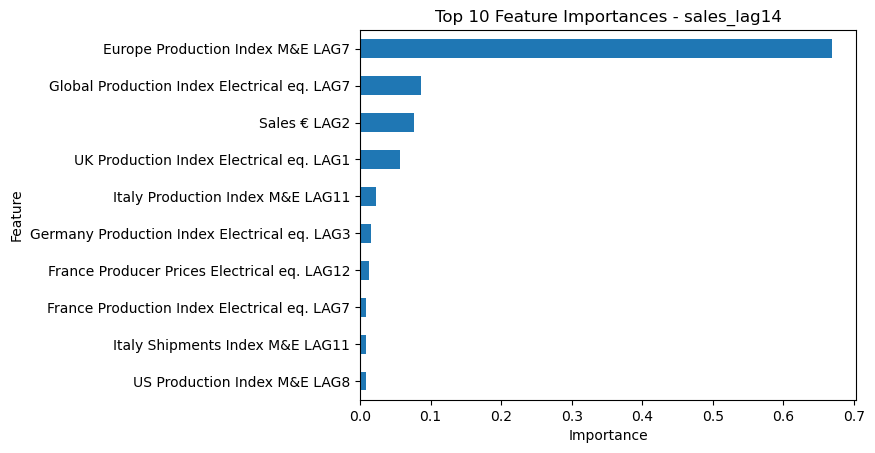

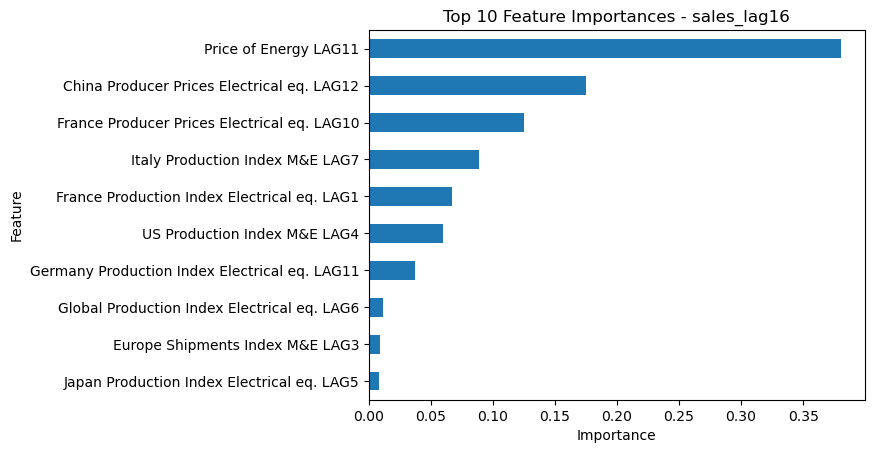

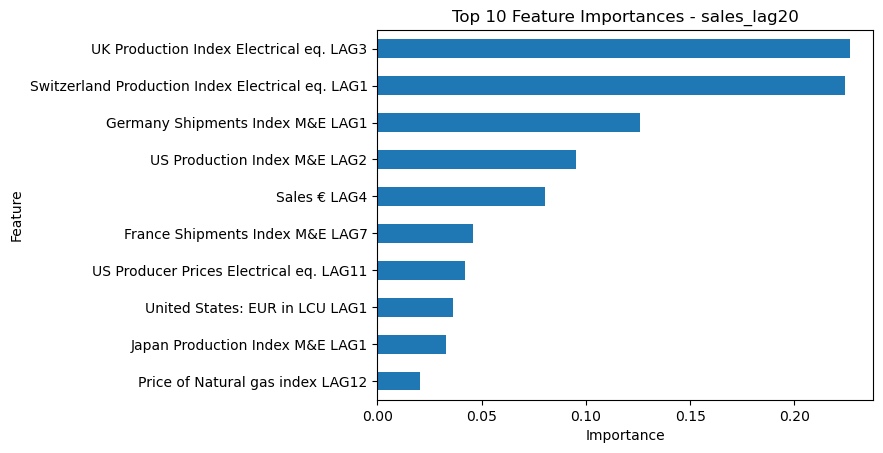

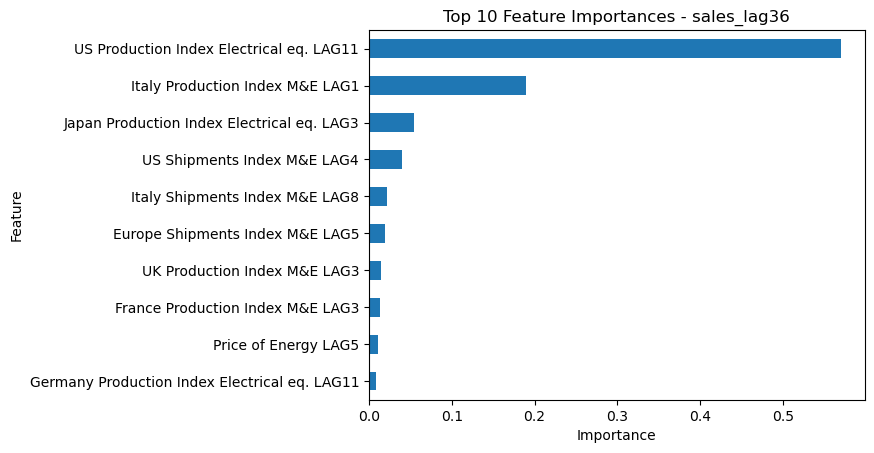

Dataset: sales_lag1
Top 10 Features: ['Price of Natural gas index LAG10', 'Switzerland Production Index M&E LAG7', 'UK Production Index Electrical eq. LAG6', 'France Shipments Index M&E LAG9', 'Sales € LAG3', 'Japan Production Index Electrical eq. LAG12', 'US Producer Prices Electrical eq. LAG6', 'Sales € LAG6', 'Italy Shipments Index M&E LAG9', 'Switzerland Production Index Machinery eq. LAG9']

Dataset: sales_lag3
Top 10 Features: ['US Shipments Index M&E LAG2', 'France Production Index M&E LAG12', 'Global Production Index Electrical eq. LAG11', 'Japan Production Index Electrical eq. LAG9', 'UK Production Index Electrical eq. LAG7', 'Japan Production Index M&E LAG9', 'China Producer Prices Electrical eq. LAG10', 'Germany Production Index Electrical eq. LAG8', 'France Producer Prices Electrical eq. LAG5', 'Italy Production Index Electrical eq. LAG3']

Dataset: sales_lag4
Top 10 Features: ['Switzerland Production Index Machinery eq. LAG12', 'France Production Index M&E LAG9', 'Japan Pr

In [82]:
# XGBoost

# Dictionary to store top 10 features for each dataset
top_features_dict = {}

# Define a function to fit XGBoost model and plot feature importances
def plot_feature_importance(lag_data, dataset_name):
    
    # Fit model on training data
    model = XGBRegressor(random_state=1)
    model.fit(lag_data.iloc[:,1:], lag_data.iloc[:,0])  # Sales € is the first column, so it's used as the dependent variable

    # Feature importance
    importance = pd.DataFrame(index=lag_data.iloc[:,1:].columns, data=model.feature_importances_)
    importance.sort_values(by=0, inplace=True)

    # Select the top 10 rows
    top_10 = importance.iloc[-10:]
    
    # Extract the top feature names into a list
    top_feature_list = top_10.index.tolist()
    
    # Plot a horizontal bar chart of the top 10 feature importances
    top_10.plot(kind='barh', legend=None)
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f'Top 10 Feature Importances - {dataset_name}')
    plt.show()
    
    # Store the top features in the dictionary
    top_features_dict[dataset_name] = top_feature_list

# Loop through each dataset and plot feature importance
for dataset_name, lag_data in sales_lag_datasets.items():
    plot_feature_importance(lag_data, dataset_name)


# Print the list of correlated features for each dataset
for dataset_name, features in top_features_dict.items():
    print(f"Dataset: {dataset_name}")
    print(f"Top 10 Features: {features}\n")

**XGBOOST RESULTS**

**PRODUCT 1**
* From the features, Switzerland Production Index Machinery eq. LAG9 was the most import with and import of almost 35%

**PRODUCT 3**
* Italy Production Index Electrical, prevels as the most importante feature with almost 60%

**PRODUCT 4**
* The Global Production Index Electrical shows as the most important feature (by a lot) w/ 60% importance

**PRODUCT 5**
* With less importance, relative to others, France Shipments and Europe Production are on top with more than 15% significance

**PRODUCT 6**
* With more than 25% significance, Janpan Prouction and the Price of Natural Gas index, were the most significant

**PRODUCT 8**
* 3 features surpass teh 15% mark of most important

**PRODUCT 9**
* 3 features surpass teh 15% mark of most important

**PRODUCT 11**
* Relatively low importance, but Europe Shipments, shows as the most important (20%)

**PRODUCT 12**
* Relatively low importance, but Japan Production, shows as the most important (20%)

**PRODUCT 13**
* Global Production as the most relevant

**PRODUCT 14**
* Europe Production shows a huge importance for this product (70%)

**PRODUCT 16**
* High importance by the Price of Energy

**PRODUCT 20**
* UK Production Electrical eq. and Switzerland Production Electrical eq. are the most important above the 20% mark

**PRODUCT 36**
* US Production Electrical eq. shows as the most relevant almost on the 55% of importance

In [83]:
# Selecting 10 from XGBoost + >0.4 correlation

## Product 1
sales_p1 = sales_p1[list(set(['Sales €'] + correlated_features["sales_lag1"] + top_features_dict["sales_lag1"]))]
sales_p1.dropna(inplace=True)

## Product 3
sales_p3 = sales_p3[list(set(['Sales €'] + correlated_features["sales_lag3"] + top_features_dict["sales_lag3"]))]
sales_p3.dropna(inplace=True)

## Product 4
sales_p4 = sales_p4[list(set(['Sales €'] + correlated_features["sales_lag4"] + top_features_dict["sales_lag4"]))]
sales_p4.dropna(inplace=True)

## Product 5
sales_p5 = sales_p5[list(set(['Sales €'] + correlated_features["sales_lag5"] + top_features_dict["sales_lag5"]))]
sales_p5.dropna(inplace=True)

## Product 6
sales_p6 = sales_p6[list(set(['Sales €'] + correlated_features["sales_lag6"] + top_features_dict["sales_lag6"]))]
sales_p6.dropna(inplace=True)

## Product 8
sales_p8 = sales_p8[list(set(['Sales €'] + correlated_features["sales_lag8"] + top_features_dict["sales_lag8"]))]
sales_p8.dropna(inplace=True)

## Product 9
sales_p9 = sales_p9[list(set(['Sales €'] + correlated_features["sales_lag9"] + top_features_dict["sales_lag9"]))]
sales_p9.dropna(inplace=True)

## Product 11
sales_p11 = sales_p11[list(set(['Sales €'] + correlated_features["sales_lag11"] + top_features_dict["sales_lag11"]))]
sales_p11.dropna(inplace=True)

## Product 12
sales_p12 = sales_p12[list(set(['Sales €'] + correlated_features["sales_lag12"] + top_features_dict["sales_lag12"]))]
sales_p12.dropna(inplace=True)

## Product 13
sales_p13 = sales_p13[list(set(['Sales €'] + correlated_features["sales_lag13"] + top_features_dict["sales_lag13"]))]
sales_p13.dropna(inplace=True)

## Product 14
sales_p14 = sales_p14[list(set(['Sales €'] + correlated_features["sales_lag14"] + top_features_dict["sales_lag14"]))]
sales_p14.dropna(inplace=True)

## Product 16
sales_p16 = sales_p16[list(set(['Sales €'] + correlated_features["sales_lag16"] + top_features_dict["sales_lag16"]))]
sales_p16.dropna(inplace=True)

## Product 20
sales_p20 = sales_p20[list(set(['Sales €'] + correlated_features["sales_lag20"] + top_features_dict["sales_lag20"]))]
sales_p20.dropna(inplace=True)

## Product 36
sales_p36 = sales_p36[list(set(['Sales €'] + correlated_features["sales_lag36"] + top_features_dict["sales_lag36"]))]
sales_p36.dropna(inplace=True)


<a class="anchor" id="4">
    
# 4. Exploring the Datasets
    
    
</a>

In [84]:
def explore_time_series(df):
    # Step 1: Checking the Head and Tail
    print("First few rows of the dataset:")
    display(df.head())

    print("\nLast few rows of the dataset:")
    display(df.tail())

    # Step 2: Features
    print("\nNumber of Features:", len(df.columns))
    print("Features:", list(df.columns))

    # Step 3: Summary Statistics
    print("\nSummary statistics of sales data:")
    display(df.describe())

    # Step 4: Visualizing the Time Series
    print("\n")
    plt.figure(figsize=(10, 6))
    plt.plot(df.index, df['Sales €']/1000000, color='blue')
    plt.title('Daily Sales')
    plt.xlabel('Date')
    plt.ylabel('Sales (€) in millions')
    plt.grid(True)
    plt.show()


**PRODUCT #1**

First few rows of the dataset:


,US Producer Prices Electrical eq. LAG6,France Shipments Index M&E LAG9,UK Production Index Electrical eq. LAG6,Japan Production Index M&E LAG12,Japan Production Index Electrical eq. LAG12,Europe Shipments Index M&E LAG9,Price of Natural gas index LAG10,Germany Production Index M&E LAG9,Sales € LAG3,Switzerland Production Index M&E LAG7,Germany Shipments Index M&E LAG9,Sales €,Switzerland Production Index Machinery eq. LAG9,Sales € LAG6,Italy Shipments Index M&E LAG9,Price of Energy LAG10,China Producer Prices Electrical eq. LAG8
Full_Date,,,,,,,,,,,,,,,,,
2019-04-01,110.3750,127.1250,110.3125,153.8750,141.5000,136.5000,76.5000,126.9375,27728148.0,103.1875,148.000,39688292.0,100.9375,36098920.0,127.0000,94.6250,97.0625
2019-05-01,110.6875,104.7500,118.6875,115.5625,108.3125,120.4375,78.3125,116.7500,34793164.0,105.9375,129.875,38897976.0,101.5625,30742242.0,121.3750,93.6875,96.7500
2019-06-01,111.0000,92.8125,120.4375,115.3750,107.0625,112.3125,77.5000,114.6875,33856804.0,109.0625,130.000,39106752.0,102.1875,37889612.0,74.4375,93.0000,96.5625
2019-07-01,111.1875,110.5000,105.3750,126.9375,118.7500,127.6875,81.6875,118.5625,39688292.0,112.2500,136.625,37912572.0,102.8125,27728148.0,115.3125,92.0000,96.3125
2019-08-01,111.3750,122.4375,107.1875,123.1875,116.5000,131.0000,89.1875,124.2500,38897976.0,115.3750,137.750,38042676.0,106.8125,34793164.0,122.4375,98.7500,95.3750



Last few rows of the dataset:


,US Producer Prices Electrical eq. LAG6,France Shipments Index M&E LAG9,UK Production Index Electrical eq. LAG6,Japan Production Index M&E LAG12,Japan Production Index Electrical eq. LAG12,Europe Shipments Index M&E LAG9,Price of Natural gas index LAG10,Germany Production Index M&E LAG9,Sales € LAG3,Switzerland Production Index M&E LAG7,Germany Shipments Index M&E LAG9,Sales €,Switzerland Production Index Machinery eq. LAG9,Sales € LAG6,Italy Shipments Index M&E LAG9,Price of Energy LAG10,China Producer Prices Electrical eq. LAG8
Full_Date,,,,,,,,,,,,,,,,,
2021-12-01,118.8125,107.8750,117.250,107.8750,100.8750,119.1875,73.0000,102.5000,36278888.0,89.1250,117.6875,33950068.0,85.6875,35801400.0,107.8125,69.8750,92.8125
2022-01-01,120.7500,129.2500,129.875,116.5000,109.6875,147.1250,97.5000,123.5625,44483012.0,89.3750,147.2500,37942944.0,84.6250,37130004.0,134.2500,80.3750,92.9375
2022-02-01,121.8750,115.1875,122.750,102.5000,96.4375,127.1875,65.6250,108.0000,34187396.0,89.6250,125.1875,36293076.0,87.0625,36310816.0,116.7500,80.7500,95.1875
2022-03-01,122.6875,103.0000,116.375,112.0625,103.4375,126.5000,71.2500,102.8750,33950068.0,93.3125,122.5625,40220408.0,89.5000,36278888.0,127.3750,80.8125,96.6875
2022-04-01,124.3125,135.6250,130.500,143.3750,134.6250,144.3750,83.4375,115.5625,37942944.0,96.9375,139.0000,41053204.0,91.9375,44483012.0,134.8750,86.3125,97.6875



Number of Features: 17
Features: ['US Producer Prices Electrical eq. LAG6', 'France Shipments Index M&E LAG9', 'UK Production Index Electrical eq. LAG6', 'Japan Production Index M&E LAG12', 'Japan Production Index Electrical eq. LAG12', 'Europe Shipments Index M&E LAG9', 'Price of Natural gas index LAG10', 'Germany Production Index M&E LAG9', 'Sales € LAG3', 'Switzerland Production Index M&E LAG7', 'Germany Shipments Index M&E LAG9', 'Sales €', 'Switzerland Production Index Machinery eq. LAG9', 'Sales € LAG6', 'Italy Shipments Index M&E LAG9', 'Price of Energy LAG10', 'China Producer Prices Electrical eq. LAG8']

Summary statistics of sales data:


,US Producer Prices Electrical eq. LAG6,France Shipments Index M&E LAG9,UK Production Index Electrical eq. LAG6,Japan Production Index M&E LAG12,Japan Production Index Electrical eq. LAG12,Europe Shipments Index M&E LAG9,Price of Natural gas index LAG10,Germany Production Index M&E LAG9,Sales € LAG3,Switzerland Production Index M&E LAG7,Germany Shipments Index M&E LAG9,Sales €,Switzerland Production Index Machinery eq. LAG9,Sales € LAG6,Italy Shipments Index M&E LAG9,Price of Energy LAG10,China Producer Prices Electrical eq. LAG8
count,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000,3.700000e+01,37.000000,37.0000,3.700000e+01,37.0000,3.700000e+01,37.00000,37.00000,37.000000
mean,113.312500,109.187500,117.500000,114.062500,106.625000,122.250000,63.687500,109.812500,3.641919e+07,96.375000,126.8125,3.699185e+07,94.0625,3.638271e+07,110.50000,73.00000,93.812500
std,3.708984,14.617188,11.898438,15.070312,13.359375,13.398438,18.109375,11.171875,3.571042e+06,8.820312,13.0625,3.325598e+06,9.4375,3.651972e+06,20.09375,17.21875,1.910156
min,110.375000,64.437500,77.937500,82.000000,78.562500,83.750000,34.000000,81.062500,2.718043e+07,77.812500,93.3125,2.718043e+07,77.9375,2.718043e+07,55.12500,31.62500,90.312500
25%,111.187500,103.625000,112.312500,104.625000,98.875000,113.625000,51.843750,103.687500,3.418740e+07,89.625000,121.1250,3.481696e+07,86.3125,3.463052e+07,100.43750,63.75000,92.250000
50%,111.562500,110.812500,117.562500,114.437500,104.250000,125.937500,62.500000,112.250000,3.732390e+07,96.125000,128.8750,3.764361e+07,97.8750,3.732390e+07,118.31250,76.31250,93.875000
75%,113.375000,119.062500,125.625000,123.000000,112.500000,131.000000,77.500000,116.875000,3.887936e+07,103.437500,135.8750,3.901230e+07,99.8125,3.887936e+07,123.25000,84.43750,95.000000
max,124.312500,135.625000,140.750000,153.875000,141.500000,147.125000,97.500000,127.375000,4.448301e+07,115.375000,148.0000,4.448301e+07,114.7500,4.448301e+07,135.75000,100.25000,97.687500


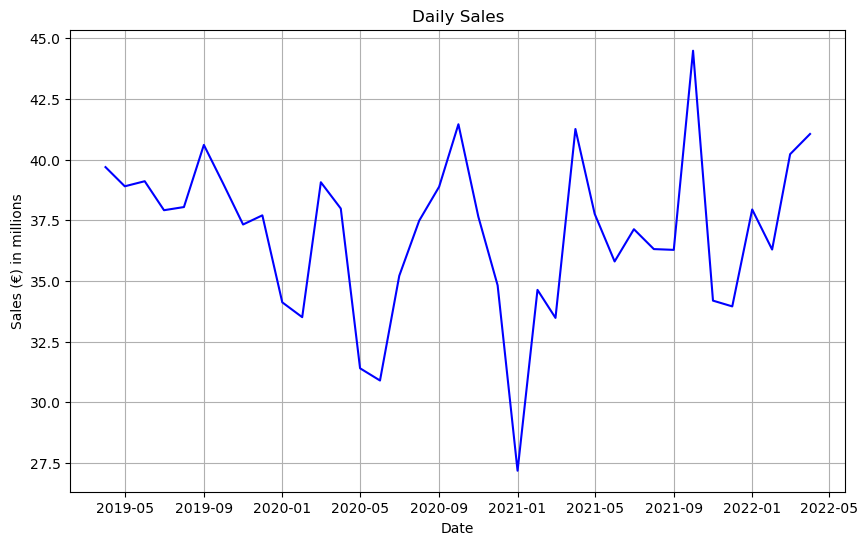

In [85]:
explore_time_series(sales_p1)

**PRODUCT #3**

First few rows of the dataset:


,Italy Production Index M&E LAG3,UK Production Index M&E LAG12,United States: EUR in LCU LAG5,Germany Production Index Electrical eq. LAG8,Global Production Index Electrical eq. LAG11,China Production Index M&E LAG2,Japan Production Index Electrical eq. LAG9,US Producer Prices Electrical eq. LAG5,Italy Production Index Electrical eq. LAG3,Sales €,US Shipments Index M&E LAG2,France Production Index M&E LAG12,Japan Production Index M&E LAG9,France Producer Prices Electrical eq. LAG5,UK Production Index Electrical eq. LAG7,China Producer Prices Electrical eq. LAG10
Full_Date,,,,,,,,,,,,,,,,
2018-10-01,115.2500,112.1250,1.227539,110.3750,122.7500,207.875,116.3750,108.0000,89.43750,8089466.0,117.7500,103.6250,127.2500,102.5000,99.6250,96.6250
2018-11-01,116.5000,108.8125,1.181641,107.2500,125.9375,197.500,103.6250,108.5625,90.81250,11863002.0,128.2500,107.6875,112.4375,102.2500,109.1875,96.4375
2018-12-01,60.7500,114.1875,1.167969,117.0625,114.9375,199.375,111.8125,108.7500,46.90625,8736859.0,126.0000,101.0625,119.8125,102.5625,99.3750,96.6875
2019-01-01,105.4375,102.0000,1.168945,108.6875,110.4375,212.000,141.5000,110.0000,85.18750,10705301.0,127.8125,101.3750,153.8750,102.5000,102.5000,96.6250
2019-02-01,118.3750,104.0625,1.155273,106.7500,110.5625,220.500,108.3125,110.1250,93.00000,10167797.0,117.6875,91.0000,115.5625,102.5000,105.1250,96.1875



Last few rows of the dataset:


,Italy Production Index M&E LAG3,UK Production Index M&E LAG12,United States: EUR in LCU LAG5,Germany Production Index Electrical eq. LAG8,Global Production Index Electrical eq. LAG11,China Production Index M&E LAG2,Japan Production Index Electrical eq. LAG9,US Producer Prices Electrical eq. LAG5,Italy Production Index Electrical eq. LAG3,Sales €,US Shipments Index M&E LAG2,France Production Index M&E LAG12,Japan Production Index M&E LAG9,France Producer Prices Electrical eq. LAG5,UK Production Index Electrical eq. LAG7,China Producer Prices Electrical eq. LAG10
Full_Date,,,,,,,,,,,,,,,,
2021-12-01,61.34375,106.1875,1.205078,119.8750,126.4375,259.00,103.4375,120.7500,49.03125,12376415.0,147.500,94.0000,112.0625,105.5625,119.250,92.0000
2022-01-01,112.37500,98.8125,1.182617,105.5000,116.3125,269.75,134.6250,121.8750,94.87500,13754291.0,141.625,94.0625,143.3750,105.8125,117.250,92.2500
2022-02-01,108.12500,88.2500,1.176758,100.6875,120.0625,291.50,108.1875,122.6875,91.18750,15665217.0,134.250,84.1250,116.1875,106.6250,129.875,92.8125
2022-03-01,111.37500,98.9375,1.176758,112.5000,145.6250,310.75,96.7500,124.3125,89.00000,14320305.0,148.625,88.8125,102.8125,106.5625,122.750,92.9375
2022-04-01,94.00000,125.1875,1.160156,107.7500,133.6250,236.00,119.9375,126.0625,72.93750,11999375.0,129.625,109.4375,128.8750,107.3750,116.375,95.1875



Number of Features: 16
Features: ['Italy Production Index M&E LAG3', 'UK Production Index M&E LAG12', 'United States: EUR in LCU LAG5', 'Germany Production Index Electrical eq. LAG8', 'Global Production Index Electrical eq. LAG11', 'China Production Index M&E LAG2', 'Japan Production Index Electrical eq. LAG9', 'US Producer Prices Electrical eq. LAG5', 'Italy Production Index Electrical eq. LAG3', 'Sales €', 'US Shipments Index M&E LAG2', 'France Production Index M&E LAG12', 'Japan Production Index M&E LAG9', 'France Producer Prices Electrical eq. LAG5', 'UK Production Index Electrical eq. LAG7', 'China Producer Prices Electrical eq. LAG10']

Summary statistics of sales data:


,Italy Production Index M&E LAG3,UK Production Index M&E LAG12,United States: EUR in LCU LAG5,Germany Production Index Electrical eq. LAG8,Global Production Index Electrical eq. LAG11,China Production Index M&E LAG2,Japan Production Index Electrical eq. LAG9,US Producer Prices Electrical eq. LAG5,Italy Production Index Electrical eq. LAG3,Sales €,US Shipments Index M&E LAG2,France Production Index M&E LAG12,Japan Production Index M&E LAG9,France Producer Prices Electrical eq. LAG5,UK Production Index Electrical eq. LAG7,China Producer Prices Electrical eq. LAG10
count,43.000000,43.0000,43.000000,43.000000,43.000000,43.00000,43.0000,43.000000,43.00000,4.300000e+01,43.000000,43.000000,43.00000,43.000000,43.000000,43.000000
mean,98.812500,103.8125,1.152344,103.812500,121.875000,240.50000,107.0625,113.125000,79.87500,1.243187e+07,126.625000,92.687500,114.50000,103.250000,115.000000,94.125000
std,18.546875,11.8125,0.039734,9.710938,9.148438,42.59375,12.7500,4.222656,16.03125,2.492096e+06,10.539062,13.539062,14.40625,1.335938,12.023438,1.960938
min,50.625000,61.0625,1.085938,81.062500,103.500000,130.50000,78.5625,108.000000,38.96875,4.931400e+06,108.750000,50.750000,82.00000,102.062500,77.937500,90.312500
25%,91.812500,100.5625,1.120117,99.250000,116.500000,215.37500,99.8750,111.031250,74.09375,1.105907e+07,117.718750,90.125000,104.96875,102.500000,108.031250,92.312500
50%,104.562500,106.0625,1.148438,106.312500,122.250000,241.87500,107.0625,111.437500,85.06250,1.231748e+07,126.187500,94.562500,115.18750,102.750000,116.375000,94.500000
75%,111.906250,110.8750,1.182129,109.750000,128.031250,263.50000,113.5000,113.281250,91.40625,1.377567e+07,133.437500,100.843750,123.09375,103.187500,123.531250,95.875000
max,118.375000,125.1875,1.227539,119.875000,145.625000,321.75000,141.5000,126.062500,102.18750,1.868682e+07,148.625000,111.937500,153.87500,107.375000,140.750000,97.062500


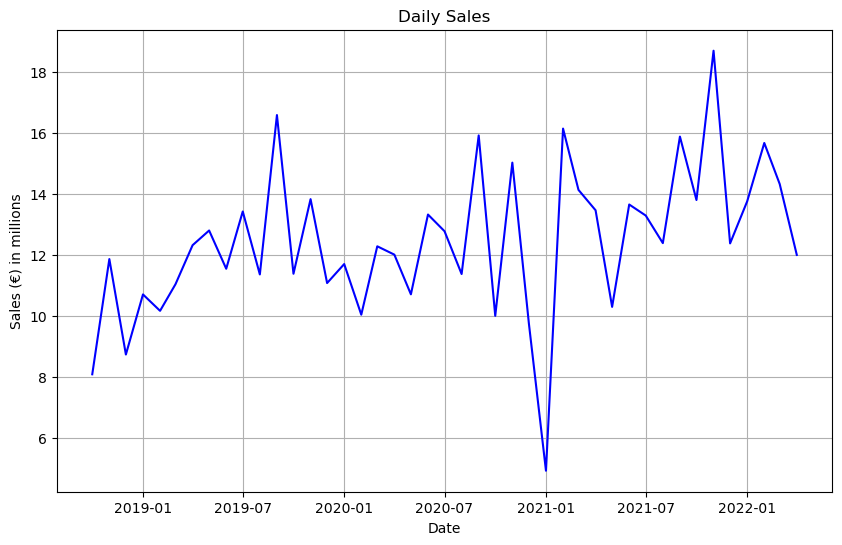

In [86]:
explore_time_series(sales_p3)

**PRODUCT #4**

First few rows of the dataset:


,Switzerland Production Index Machinery eq. LAG12,Europe Shipments Index M&E LAG12,France Production Index M&E LAG9,US Production Index M&E LAG9,Sales € LAG3,Germany Production Index Electrical eq. LAG5,Sales €,Europe Production Index M&E LAG12,US Shipments Index M&E LAG9,Italy Shipments Index M&E LAG12,Global Production Index Electrical eq. LAG12,Japan Production Index Electrical eq. LAG1
Full_Date,,,,,,,,,,,,
2019-01-01,109.3125,134.8750,111.9375,109.0625,397760.68750,111.1875,484173.87500,117.1875,131.0000,131.6250,114.9375,111.9375
2019-02-01,105.3750,108.9375,92.2500,111.6250,371322.40625,111.3125,620031.81250,105.2500,120.4375,86.4375,110.4375,112.5000
2019-03-01,101.4375,112.7500,88.5000,110.0000,430100.96875,110.8750,491643.59375,108.0000,126.2500,100.5000,110.5625,95.9375
2019-04-01,97.5000,132.2500,109.7500,112.6875,484173.87500,118.3125,426221.34375,124.0625,133.7500,120.2500,128.1250,107.3125
2019-05-01,98.6250,116.9375,100.8125,106.5625,620031.81250,117.1875,375671.56250,110.6250,117.7500,102.8750,117.6875,131.5000



Last few rows of the dataset:


,Switzerland Production Index Machinery eq. LAG12,Europe Shipments Index M&E LAG12,France Production Index M&E LAG9,US Production Index M&E LAG9,Sales € LAG3,Germany Production Index Electrical eq. LAG5,Sales €,Europe Production Index M&E LAG12,US Shipments Index M&E LAG9,Italy Shipments Index M&E LAG12,Global Production Index Electrical eq. LAG12,Japan Production Index Electrical eq. LAG1
Full_Date,,,,,,,,,,,,
2021-12-01,87.0625,129.5000,88.8125,107.6875,323380.87500,112.5000,199188.75000,115.6250,121.3125,120.1250,135.3750,98.8750
2022-01-01,87.8125,136.7500,109.4375,112.1875,344985.71875,107.7500,283630.81250,113.3125,144.5000,132.2500,126.4375,104.3750
2022-02-01,86.7500,105.7500,93.5000,112.5625,290506.87500,103.4375,245306.12500,96.6250,135.1250,92.8750,116.3125,109.0000
2022-03-01,85.6875,119.1875,86.4375,112.1875,199188.75000,111.6875,406399.84375,107.9375,135.1250,107.8125,120.0625,95.3750
2022-04-01,84.6250,147.1250,107.2500,112.8125,283630.81250,106.2500,302057.03125,129.6250,148.6250,134.2500,145.6250,103.9375



Number of Features: 12
Features: ['Switzerland Production Index Machinery eq. LAG12', 'Europe Shipments Index M&E LAG12', 'France Production Index M&E LAG9', 'US Production Index M&E LAG9', 'Sales € LAG3', 'Germany Production Index Electrical eq. LAG5', 'Sales €', 'Europe Production Index M&E LAG12', 'US Shipments Index M&E LAG9', 'Italy Shipments Index M&E LAG12', 'Global Production Index Electrical eq. LAG12', 'Japan Production Index Electrical eq. LAG1']

Summary statistics of sales data:


,Switzerland Production Index Machinery eq. LAG12,Europe Shipments Index M&E LAG12,France Production Index M&E LAG9,US Production Index M&E LAG9,Sales € LAG3,Germany Production Index Electrical eq. LAG5,Sales €,Europe Production Index M&E LAG12,US Shipments Index M&E LAG9,Italy Shipments Index M&E LAG12,Global Production Index Electrical eq. LAG12,Japan Production Index Electrical eq. LAG1
count,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000,40.000000
mean,95.625000,121.312500,91.937500,106.625000,366836.048633,102.875000,360700.522070,110.875000,124.375000,109.312500,121.375000,104.125000
std,9.500000,12.867188,13.804688,5.386719,159991.745566,9.562500,161113.387877,10.929688,8.890625,19.562500,9.273438,11.914062
min,77.937500,83.750000,50.750000,90.562500,93226.320312,81.062500,93226.320312,77.562500,108.750000,55.125000,103.500000,78.562500
25%,86.640625,113.343750,88.734375,104.000000,281715.148438,98.171875,270828.054688,106.484375,117.484375,98.546875,115.968750,97.453125
50%,98.093750,122.281250,94.031250,107.593750,331017.406250,105.187500,319434.921875,113.406250,125.468750,116.968750,121.281250,102.687500
75%,101.468750,131.062500,99.906250,110.906250,431243.132812,108.328125,428333.414062,117.359375,128.656250,122.437500,127.984375,109.921875
max,114.750000,147.125000,111.937500,112.812500,829442.312500,119.875000,829442.312500,129.625000,148.625000,135.750000,145.625000,134.625000


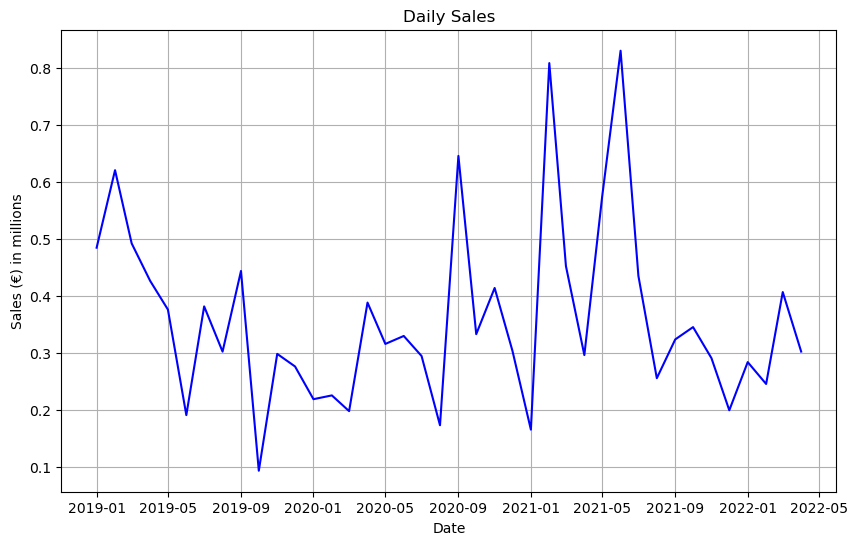

In [87]:
explore_time_series(sales_p4)

**PRODUCT #5**

First few rows of the dataset:


,UK Production Index M&E LAG12,Europe Shipments Index M&E LAG12,Germany Production Index M&E LAG12,Global Production Index Electrical eq. LAG10,Japan Production Index Electrical eq. LAG12,Italy Production Index Electrical eq. LAG10,France Production Index M&E LAG12,Sales €,Europe Production Index M&E LAG12,France Production Index Electrical eq. LAG9,Price of Base Metals LAG11,Japan Production Index M&E LAG9,Sales € LAG6,Global Production Index Machinery eq. LAG12,Sales € LAG3,France Shipments Index M&E LAG12,Germany Shipments Index M&E LAG12
Full_Date,,,,,,,,,,,,,,,,,
2019-04-01,119.9375,132.2500,125.9375,119.0000,141.5000,89.81250,111.9375,5714462.5,124.0625,95.1250,96.0625,126.9375,2499061.25,137.2500,8233205.0,121.6875,141.750
2019-05-01,106.0625,116.9375,113.4375,126.3125,108.3125,89.43750,92.2500,11389673.0,110.6250,86.3750,96.4375,123.1875,8993944.00,123.1875,6879251.0,106.6250,126.375
2019-06-01,107.1875,122.1250,112.1250,121.9375,107.0625,90.81250,88.5000,13681879.0,114.3125,64.3125,96.8125,115.1875,6947507.50,124.3750,11914314.0,102.2500,126.250
2019-07-01,111.1250,136.5000,126.9375,117.5000,118.7500,46.90625,109.7500,11145039.0,124.1250,85.0625,88.0000,127.8125,8233205.00,133.5000,5714462.5,127.1250,148.000
2019-08-01,106.0625,120.4375,116.7500,126.3750,116.5000,85.18750,100.8125,7645745.5,114.0625,97.8750,85.5625,125.1875,6879251.00,124.8125,11389673.0,104.7500,129.875



Last few rows of the dataset:


,UK Production Index M&E LAG12,Europe Shipments Index M&E LAG12,Germany Production Index M&E LAG12,Global Production Index Electrical eq. LAG10,Japan Production Index Electrical eq. LAG12,Italy Production Index Electrical eq. LAG10,France Production Index M&E LAG12,Sales €,Europe Production Index M&E LAG12,France Production Index Electrical eq. LAG9,Price of Base Metals LAG11,Japan Production Index M&E LAG9,Sales € LAG6,Global Production Index Machinery eq. LAG12,Sales € LAG3,France Shipments Index M&E LAG12,Germany Shipments Index M&E LAG12
Full_Date,,,,,,,,,,,,,,,,,
2021-12-01,106.1875,129.5000,112.2500,116.3125,100.8750,80.9375,94.0000,8656480.0,115.6250,80.7500,98.0625,112.0625,11687229.0,123.7500,15629191.0,116.6250,129.3750
2022-01-01,98.8125,136.7500,112.7500,120.0625,109.6875,90.2500,94.0625,7731408.5,113.3125,94.5000,99.6875,143.3750,8321886.5,123.6250,11472426.0,120.0625,135.7500
2022-02-01,88.2500,105.7500,90.6250,145.6250,96.4375,102.1875,84.1250,7675455.5,96.6250,83.0625,105.0000,116.1875,19524640.0,109.4375,9606371.0,97.8125,103.1875
2022-03-01,98.9375,119.1875,102.5000,133.6250,103.4375,91.6250,88.8125,14739187.0,107.9375,75.8125,109.0625,102.8125,15629191.0,116.3750,8656480.0,107.8750,117.6875
2022-04-01,125.1875,147.1250,123.5625,128.5000,134.6250,94.3125,109.4375,8884608.0,129.6250,94.0625,113.5000,128.8750,11472426.0,143.0000,7731408.5,129.2500,147.2500



Number of Features: 17
Features: ['UK Production Index M&E LAG12', 'Europe Shipments Index M&E LAG12', 'Germany Production Index M&E LAG12', 'Global Production Index Electrical eq. LAG10', 'Japan Production Index Electrical eq. LAG12', 'Italy Production Index Electrical eq. LAG10', 'France Production Index M&E LAG12', 'Sales €', 'Europe Production Index M&E LAG12', 'France Production Index Electrical eq. LAG9', 'Price of Base Metals LAG11', 'Japan Production Index M&E LAG9', 'Sales € LAG6', 'Global Production Index Machinery eq. LAG12', 'Sales € LAG3', 'France Shipments Index M&E LAG12', 'Germany Shipments Index M&E LAG12']

Summary statistics of sales data:


,UK Production Index M&E LAG12,Europe Shipments Index M&E LAG12,Germany Production Index M&E LAG12,Global Production Index Electrical eq. LAG10,Japan Production Index Electrical eq. LAG12,Italy Production Index Electrical eq. LAG10,France Production Index M&E LAG12,Sales €,Europe Production Index M&E LAG12,France Production Index Electrical eq. LAG9,Price of Base Metals LAG11,Japan Production Index M&E LAG9,Sales € LAG6,Global Production Index Machinery eq. LAG12,Sales € LAG3,France Shipments Index M&E LAG12,Germany Shipments Index M&E LAG12
count,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000,3.700000e+01,37.00000,37.00000,37.000000,37.000000,3.700000e+01,37.000000,3.700000e+01,37.0000,37.000000
mean,103.250000,121.500000,110.500000,122.625000,106.625000,79.375000,91.625000,1.038183e+07,111.00000,81.06250,85.625000,113.000000,1.006221e+07,121.312500,1.026636e+07,108.6250,127.000000
std,12.507812,12.953125,11.390625,9.367188,13.359375,15.828125,14.109375,3.713048e+06,11.28125,11.53125,10.328125,13.835938,3.903270e+06,9.984375,3.676159e+06,14.0625,13.117188
min,61.062500,83.750000,81.062500,103.500000,78.562500,38.968750,50.750000,1.405295e+06,77.56250,44.84375,67.312500,82.000000,1.405295e+06,98.687500,1.405295e+06,64.4375,93.312500
25%,98.937500,113.625000,104.375000,117.062500,98.875000,75.250000,88.812500,7.990826e+06,106.50000,76.18750,80.375000,104.250000,7.645746e+06,116.375000,7.990826e+06,103.6250,121.125000
50%,106.062500,122.437500,112.750000,122.812500,104.250000,84.125000,94.062500,9.872427e+06,113.50000,83.06250,83.812500,112.062500,9.872427e+06,123.187500,9.872427e+06,110.5000,128.875000
75%,110.625000,131.000000,117.125000,128.500000,112.500000,90.250000,99.750000,1.242441e+07,117.87500,88.25000,88.000000,123.000000,1.191431e+07,125.312500,1.191431e+07,119.0625,135.875000
max,125.187500,147.125000,127.375000,145.625000,141.500000,102.187500,111.937500,1.952464e+07,129.62500,97.87500,113.500000,143.375000,1.952464e+07,143.000000,1.952464e+07,129.2500,148.000000


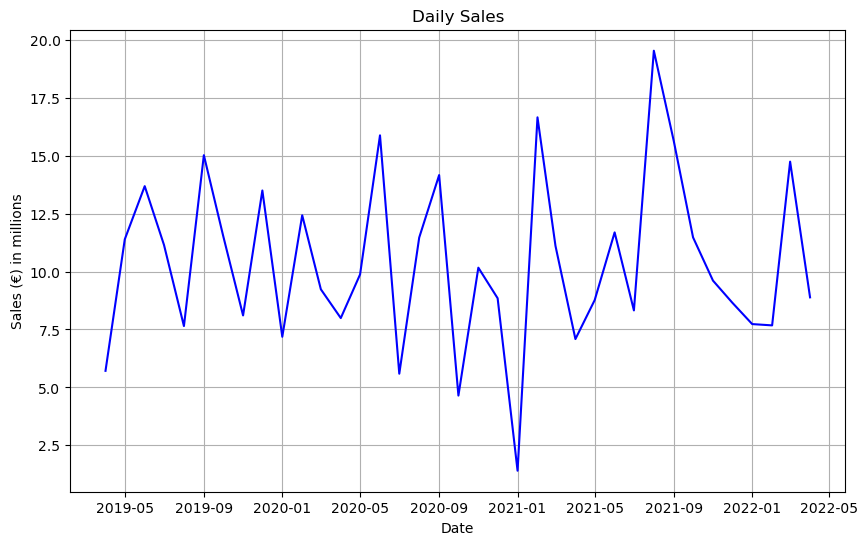

In [88]:
explore_time_series(sales_p5)

**PRODUCT #6**

First few rows of the dataset:


,France Production Index M&E LAG3,Global Production Index Machinery eq. LAG6,Price of Natural gas index LAG9,Price of Base Metals LAG1,Sales € LAG4,Japan Production Index M&E LAG4,United States: EUR in LCU LAG12,China Producer Prices Electrical eq. LAG3,Sales €,France Production Index Electrical eq. LAG3,Japan Production Index Electrical eq. LAG4
Full_Date,,,,,,,,,,,
2019-02-01,108.2500,124.8125,73.5000,82.7500,369231.59375,127.8125,1.219727,96.3125,542037.50000,97.8750,114.5000
2019-03-01,99.6250,118.8750,76.5000,81.2500,473046.96875,125.1875,1.234375,95.3750,735604.25000,91.1250,112.3750
2019-04-01,94.6875,128.5000,78.3125,84.6875,999472.68750,122.6250,1.233398,95.0000,277575.12500,78.0625,111.9375
2019-05-01,90.1250,131.3750,77.5000,86.1875,598874.12500,123.0000,1.227539,94.9375,315978.78125,81.9375,112.5000
2019-06-01,92.5625,130.0000,81.6875,85.6250,542037.50000,105.5000,1.181641,94.6875,282963.18750,80.3125,95.9375



Last few rows of the dataset:


,France Production Index M&E LAG3,Global Production Index Machinery eq. LAG6,Price of Natural gas index LAG9,Price of Base Metals LAG1,Sales € LAG4,Japan Production Index M&E LAG4,United States: EUR in LCU LAG12,China Producer Prices Electrical eq. LAG3,Sales €,France Production Index Electrical eq. LAG3,Japan Production Index Electrical eq. LAG4
Full_Date,,,,,,,,,,,
2021-12-01,63.84375,125.125,97.5000,130.0000,529725.437500,119.5625,1.183594,97.8125,190074.953125,61.3750,110.6250
2022-01-01,101.87500,139.250,65.6250,125.1875,947905.375000,103.1875,1.216797,98.1250,157670.312500,89.5625,85.6875
2022-02-01,97.37500,129.375,71.2500,125.1875,196463.812500,123.2500,1.216797,98.6875,391088.312500,88.7500,107.3125
2022-03-01,94.31250,119.875,83.4375,133.2500,386462.968750,114.0000,1.209961,98.1250,316132.218750,88.3125,98.8750
2022-04-01,100.56250,135.625,94.7500,138.8750,190074.953125,121.8125,1.189453,98.1250,333705.625000,80.7500,104.3750



Number of Features: 11
Features: ['France Production Index M&E LAG3', 'Global Production Index Machinery eq. LAG6', 'Price of Natural gas index LAG9', 'Price of Base Metals LAG1', 'Sales € LAG4', 'Japan Production Index M&E LAG4', 'United States: EUR in LCU LAG12', 'China Producer Prices Electrical eq. LAG3', 'Sales €', 'France Production Index Electrical eq. LAG3', 'Japan Production Index Electrical eq. LAG4']

Summary statistics of sales data:


,France Production Index M&E LAG3,Global Production Index Machinery eq. LAG6,Price of Natural gas index LAG9,Price of Base Metals LAG1,Sales € LAG4,Japan Production Index M&E LAG4,United States: EUR in LCU LAG12,China Producer Prices Electrical eq. LAG3,Sales €,France Production Index Electrical eq. LAG3,Japan Production Index Electrical eq. LAG4
count,39.000000,39.000000,39.00000,39.00000,39.000000,39.000000,39.000000,39.000000,39.000000,39.00000,39.000000
mean,91.312500,121.750000,64.68750,95.12500,498546.001477,112.812500,1.152344,94.125000,466699.106445,81.00000,104.687500
std,13.601562,10.054688,18.37500,20.81250,245594.827395,13.484375,0.043915,2.273438,238543.232387,11.28125,12.140625
min,50.750000,98.687500,34.00000,67.31250,-15202.959961,82.000000,1.085938,90.312500,-15202.959961,44.84375,78.562500
25%,89.468750,116.500000,52.28125,80.40625,316454.000000,103.875000,1.115234,92.250000,314757.343750,77.12500,98.187500
50%,94.312500,123.375000,63.46875,85.18750,515644.625000,112.062500,1.141602,94.187500,499147.718750,82.43750,103.437500
75%,99.687500,127.750000,77.90625,116.25000,674749.437500,122.218750,1.182129,95.156250,608789.531250,88.53125,112.093750
max,109.437500,143.000000,97.50000,138.87500,999472.687500,143.375000,1.234375,98.687500,947905.375000,97.87500,134.625000


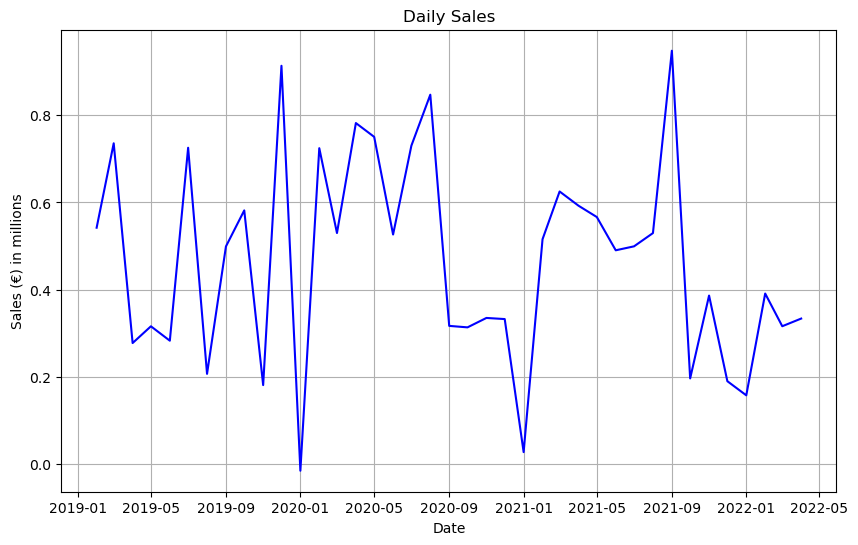

In [89]:
explore_time_series(sales_p6)

**PRODUCT #8**

First few rows of the dataset:


,Switzerland Production Index Machinery eq. LAG12,Europe Shipments Index M&E LAG12,Germany Production Index Electrical eq. LAG10,Italy Shipments Index M&E LAG8,Switzerland Production Index M&E LAG12,China Production Index M&E LAG8,Price of Energy LAG12,Price of Base Metals LAG1,Japan Production Index M&E LAG12,Global Production Index Electrical eq. LAG4,Europe Production Index M&E LAG12,COVID_Impact,France Producer Prices Electrical eq. LAG5,Germany Production Index M&E LAG6,Global Production Index Machinery eq. LAG12,France Production Index Electrical eq. LAG12,Japan Production Index Electrical eq. LAG12,Sales € LAG5,China Producer Prices Electrical eq. LAG12,UK Production Index M&E LAG6,Italy Production Index M&E LAG12,Sales €,Sales € LAG3,US Producer Prices Electrical eq. LAG3,Sales € LAG2
Full_Date,,,,,,,,,,,,,,,,,,,,,,,,,
2019-03-01,101.4375,112.7500,108.6875,127.0000,103.3125,244.125,82.1250,81.2500,119.8125,129.3750,108.0000,0,102.1875,114.6875,115.6250,82.2500,111.8125,586052.75000,96.6250,103.6875,103.250,591288.37500,271490.71875,111.0000,381400.15625
2019-04-01,97.5000,132.2500,106.7500,121.3750,98.8125,207.875,82.8125,84.6875,153.8750,128.2500,124.0625,0,102.0625,118.5625,137.2500,94.6875,141.5000,526292.75000,96.1875,108.3125,116.125,418899.90625,381400.15625,111.1875,368475.56250
2019-05-01,98.6250,116.9375,116.7500,74.4375,98.4375,197.500,88.3750,86.1875,115.5625,117.0625,110.6250,0,102.0625,124.2500,123.1875,83.9375,108.3125,271490.71875,95.5625,113.6875,101.250,298806.84375,368475.56250,111.3750,591288.37500
2019-06-01,99.8125,122.1250,111.1875,115.3125,98.0625,199.375,94.6250,85.6250,115.3750,111.5000,114.3125,0,102.1875,127.3750,124.3750,81.8125,107.0625,381400.15625,96.6250,115.0625,118.250,420707.71875,591288.37500,111.5625,418899.90625
2019-07-01,100.9375,136.5000,111.3125,122.4375,97.6875,212.000,93.6875,81.0000,126.9375,112.6875,124.1250,0,102.7500,120.5000,133.5000,95.1250,118.7500,368475.56250,97.0000,101.5625,115.250,366980.25000,418899.90625,111.9375,298806.84375



Last few rows of the dataset:


,Switzerland Production Index Machinery eq. LAG12,Europe Shipments Index M&E LAG12,Germany Production Index Electrical eq. LAG10,Italy Shipments Index M&E LAG8,Switzerland Production Index M&E LAG12,China Production Index M&E LAG8,Price of Energy LAG12,Price of Base Metals LAG1,Japan Production Index M&E LAG12,Global Production Index Electrical eq. LAG4,Europe Production Index M&E LAG12,COVID_Impact,France Producer Prices Electrical eq. LAG5,Germany Production Index M&E LAG6,Global Production Index Machinery eq. LAG12,France Production Index Electrical eq. LAG12,Japan Production Index Electrical eq. LAG12,Sales € LAG5,China Producer Prices Electrical eq. LAG12,UK Production Index M&E LAG6,Italy Production Index M&E LAG12,Sales €,Sales € LAG3,US Producer Prices Electrical eq. LAG3,Sales € LAG2
Full_Date,,,,,,,,,,,,,,,,,,,,,,,,,
2021-12-01,87.0625,129.5000,93.3125,134.250,94.4375,309.50,55.3125,130.0000,107.8750,134.250,115.6250,1,105.5625,102.8750,123.7500,83.8750,100.8750,1.207554e+06,91.1250,103.0625,103.4375,2655036.750,2.036355e+06,122.6875,3.563226e+05
2022-01-01,87.8125,136.7500,103.4375,116.750,96.5000,282.50,63.7500,125.1875,116.5000,125.750,113.3125,1,105.8125,115.5625,123.6250,75.7500,109.6875,1.093380e+06,91.6250,116.7500,88.3125,1208090.250,3.563226e+05,124.3125,1.140720e+06
2022-02-01,86.7500,105.7500,119.8750,127.375,93.9375,291.50,69.8750,125.1875,102.5000,141.750,96.6250,1,106.6250,110.6875,109.4375,76.1875,96.4375,2.036355e+06,92.0000,105.4375,89.6250,1239171.375,1.140720e+06,126.0625,2.655037e+06
2022-03-01,85.6875,119.1875,105.5000,134.875,91.4375,321.75,80.3750,133.2500,112.0625,137.000,107.9375,1,106.5625,100.8750,116.3750,80.7500,103.4375,3.563226e+05,92.2500,99.3125,103.6875,1873520.375,2.655037e+06,127.7500,1.208090e+06
2022-04-01,84.6250,147.1250,100.6875,131.000,88.8750,264.00,80.7500,138.8750,143.3750,142.625,129.6250,1,107.3750,115.0625,143.0000,94.5000,134.6250,1.140720e+06,92.8125,115.8125,117.8125,1336221.000,1.208090e+06,128.5000,1.239171e+06



Number of Features: 25
Features: ['Switzerland Production Index Machinery eq. LAG12', 'Europe Shipments Index M&E LAG12', 'Germany Production Index Electrical eq. LAG10', 'Italy Shipments Index M&E LAG8', 'Switzerland Production Index M&E LAG12', 'China Production Index M&E LAG8', 'Price of Energy LAG12', 'Price of Base Metals LAG1', 'Japan Production Index M&E LAG12', 'Global Production Index Electrical eq. LAG4', 'Europe Production Index M&E LAG12', 'COVID_Impact', 'France Producer Prices Electrical eq. LAG5', 'Germany Production Index M&E LAG6', 'Global Production Index Machinery eq. LAG12', 'France Production Index Electrical eq. LAG12', 'Japan Production Index Electrical eq. LAG12', 'Sales € LAG5', 'China Producer Prices Electrical eq. LAG12', 'UK Production Index M&E LAG6', 'Italy Production Index M&E LAG12', 'Sales €', 'Sales € LAG3', 'US Producer Prices Electrical eq. LAG3', 'Sales € LAG2']

Summary statistics of sales data:


,Switzerland Production Index Machinery eq. LAG12,Europe Shipments Index M&E LAG12,Germany Production Index Electrical eq. LAG10,Italy Shipments Index M&E LAG8,Switzerland Production Index M&E LAG12,China Production Index M&E LAG8,Price of Energy LAG12,Price of Base Metals LAG1,Japan Production Index M&E LAG12,Global Production Index Electrical eq. LAG4,Europe Production Index M&E LAG12,COVID_Impact,France Producer Prices Electrical eq. LAG5,Germany Production Index M&E LAG6,Global Production Index Machinery eq. LAG12,France Production Index Electrical eq. LAG12,Japan Production Index Electrical eq. LAG12,Sales € LAG5,China Producer Prices Electrical eq. LAG12,UK Production Index M&E LAG6,Italy Production Index M&E LAG12,Sales €,Sales € LAG3,US Producer Prices Electrical eq. LAG3,Sales € LAG2
count,38.000000,38.000000,38.000000,38.00000,38.000000,38.00000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,3.800000e+01,38.000000,38.000000,38.000000,3.800000e+01,3.800000e+01,38.000000,3.800000e+01
mean,95.000000,121.250000,102.812500,111.06250,97.500000,236.00000,73.375000,95.437500,114.187500,124.937500,110.937500,0.657895,103.375000,109.062500,121.062500,81.312500,106.812500,6.989258e+05,93.937500,103.062500,98.750000,8.615134e+05,7.713148e+05,114.500000,7.967801e+05
std,9.328125,12.851562,9.867188,20.09375,8.500000,42.40625,17.125000,21.000000,14.898438,10.828125,11.132812,0.480783,1.389648,10.703125,9.890625,11.367188,13.203125,4.283202e+05,1.941406,12.335938,18.468750,5.577821e+05,5.360492e+05,5.261719,5.346463e+05
min,77.937500,83.750000,81.062500,55.12500,77.812500,130.50000,31.625000,67.312500,82.000000,103.500000,77.562500,0.000000,102.062500,81.062500,98.687500,44.843750,78.562500,1.117913e+05,90.312500,61.062500,50.625000,1.117913e+05,1.117913e+05,110.562500,1.117913e+05
25%,86.421875,113.484375,97.140625,101.12500,92.765625,214.87500,64.390625,80.390625,104.796875,117.578125,106.750000,0.000000,102.515625,103.171875,115.812500,78.203125,99.375000,3.673541e+05,92.250000,99.031250,90.890625,4.028779e+05,3.673541e+05,111.375000,3.717067e+05
50%,98.031250,122.281250,105.187500,118.59375,98.000000,241.06250,76.468750,85.406250,114.812500,125.781250,113.406250,1.000000,102.750000,110.656250,123.125000,83.156250,105.656250,5.846052e+05,94.312500,103.687500,103.343750,8.297324e+05,5.955602e+05,111.718750,6.562892e+05
75%,100.656250,130.656250,108.531250,123.34375,103.406250,261.62500,84.031250,117.625000,122.906250,133.093750,117.656250,1.000000,103.515625,115.656250,125.234375,88.046875,112.468750,1.025705e+06,95.312500,110.406250,112.796875,1.128885e+06,1.081136e+06,115.218750,1.089601e+06
max,114.750000,147.125000,119.875000,135.75000,115.375000,321.75000,100.250000,138.875000,153.875000,145.625000,129.625000,1.000000,107.375000,127.375000,143.000000,97.875000,141.500000,2.036355e+06,97.062500,125.187500,118.375000,2.655037e+06,2.655037e+06,128.500000,2.655037e+06


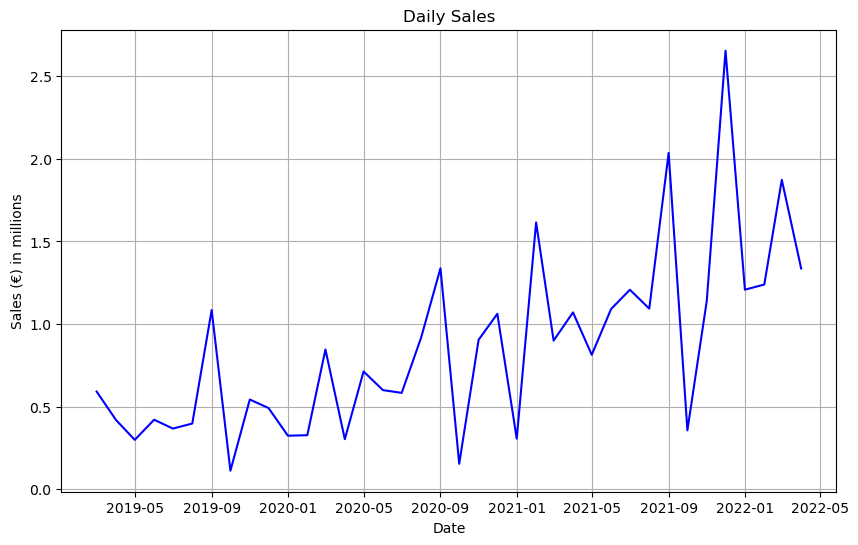

In [90]:
explore_time_series(sales_p8)

**PRODUCT #9**

First few rows of the dataset:


,Global Production Index Electrical eq. LAG5,China Producer Prices Electrical eq. LAG11,UK Production Index M&E LAG10,Sales € LAG1,France Production Index M&E LAG6,Price of Base Metals LAG11,Sales €,Japan Production Index M&E LAG9,US Shipments Index M&E LAG9,Germany Production Index M&E LAG6,Price of Energy LAG10,UK Production Index Electrical eq. LAG10
Full_Date,,,,,,,,,,,,
2018-11-01,119.0000,96.6250,102.0000,3219.320068,92.2500,92.625,1875.900024,112.4375,105.9375,113.4375,80.8125,101.6875
2018-12-01,126.3125,96.4375,104.0625,1875.900024,88.5000,92.125,0.000000,119.8125,112.6250,112.1250,87.4375,100.0000
2019-01-01,121.9375,96.6875,101.0625,0.000000,109.7500,97.000,1487.000000,153.8750,131.0000,126.9375,82.1250,99.6250
2019-02-01,117.5000,96.6250,119.9375,1487.000000,100.8125,96.875,3234.280029,115.5625,120.4375,116.7500,82.8125,109.1875
2019-03-01,126.3750,96.1875,106.0625,3234.280029,68.2500,92.875,13050.610352,115.3750,126.2500,114.6875,88.3750,99.3750



Last few rows of the dataset:


,Global Production Index Electrical eq. LAG5,China Producer Prices Electrical eq. LAG11,UK Production Index M&E LAG10,Sales € LAG1,France Production Index M&E LAG6,Price of Base Metals LAG11,Sales €,Japan Production Index M&E LAG9,US Shipments Index M&E LAG9,Germany Production Index M&E LAG6,Price of Energy LAG10,UK Production Index Electrical eq. LAG10
Full_Date,,,,,,,,,,,,
2021-12-01,141.00,91.6250,88.2500,14035.580078,86.43750,98.0625,14935.200195,112.0625,121.3125,102.8750,69.8750,106.8125
2022-01-01,134.25,92.0000,98.9375,14935.200195,107.25000,99.6875,2064.699951,143.3750,144.5000,115.5625,80.3750,121.8750
2022-02-01,125.75,92.2500,125.1875,2064.699951,95.31250,105.0000,901.500000,116.1875,135.1250,110.6875,80.7500,140.7500
2022-03-01,141.75,92.8125,104.6250,901.500000,63.84375,109.0625,4452.600098,102.8125,135.1250,100.8750,80.8125,119.2500
2022-04-01,137.00,92.9375,103.0625,4452.600098,101.87500,113.5000,3285.000000,128.8750,148.6250,115.0625,86.3125,117.2500



Number of Features: 12
Features: ['Global Production Index Electrical eq. LAG5', 'China Producer Prices Electrical eq. LAG11', 'UK Production Index M&E LAG10', 'Sales € LAG1', 'France Production Index M&E LAG6', 'Price of Base Metals LAG11', 'Sales €', 'Japan Production Index M&E LAG9', 'US Shipments Index M&E LAG9', 'Germany Production Index M&E LAG6', 'Price of Energy LAG10', 'UK Production Index Electrical eq. LAG10']

Summary statistics of sales data:


,Global Production Index Electrical eq. LAG5,China Producer Prices Electrical eq. LAG11,UK Production Index M&E LAG10,Sales € LAG1,France Production Index M&E LAG6,Price of Base Metals LAG11,Sales €,Japan Production Index M&E LAG9,US Shipments Index M&E LAG9,Germany Production Index M&E LAG6,Price of Energy LAG10,UK Production Index Electrical eq. LAG10
count,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000,42.000000
mean,124.187500,94.125000,103.250000,7265.750339,91.125000,86.687500,7267.314147,114.312500,123.687500,109.875000,74.312500,113.687500
std,10.007812,1.977539,11.734375,8308.358392,13.890625,10.117188,8307.584338,14.445312,9.296875,10.617188,16.593750,12.218750
min,103.500000,90.312500,61.062500,-4358.100098,50.750000,67.312500,-4358.100098,82.000000,105.937500,81.062500,31.625000,77.937500
25%,117.875000,92.281250,100.343750,1556.850006,88.578125,80.453125,1556.850006,104.796875,116.781250,103.859375,67.203125,106.015625
50%,125.687500,94.468750,103.875000,4551.084961,94.031250,84.937500,4551.084961,114.812500,124.968750,112.187500,78.062500,113.812500
75%,130.593750,96.031250,109.656250,9745.200195,99.718750,92.812500,9745.200195,122.906250,128.187500,116.484375,85.000000,122.812500
max,145.625000,97.062500,125.187500,39510.750000,109.750000,113.500000,39510.750000,153.875000,148.625000,127.375000,100.250000,140.750000


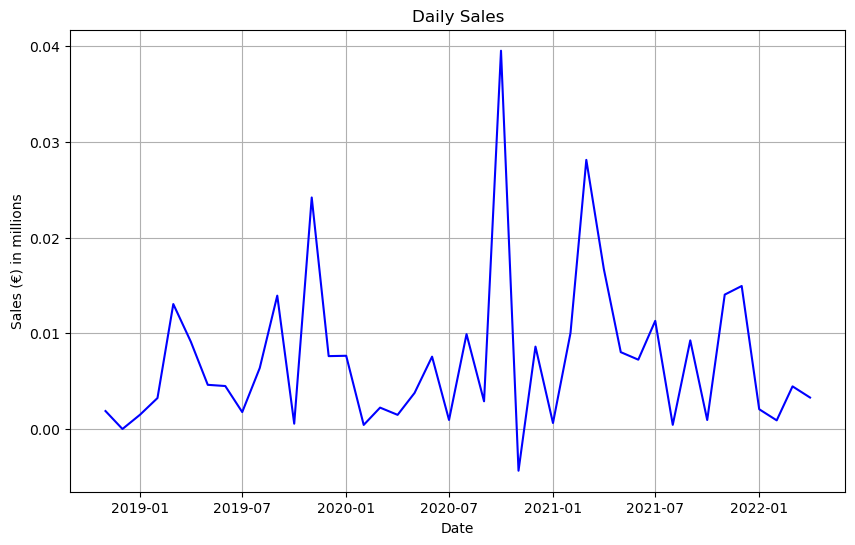

In [91]:
explore_time_series(sales_p9)

**PRODUCT #11**

First few rows of the dataset:


,Global Production Index Electrical eq. LAG8,Japan Production Index Electrical eq. LAG6,France Producer Prices Electrical eq. LAG6,Italy Shipments Index M&E LAG8,Switzerland Production Index M&E LAG12,China Production Index M&E LAG8,France Production Index M&E LAG6,Germany Production Index M&E LAG6,France Production Index Electrical eq. LAG6,US Production Index Electrical eq. LAG10,Europe Production Index M&E LAG6,US Production Index M&E LAG7,Germany Shipments Index M&E LAG6,Global Production Index Machinery eq. LAG6,UK Production Index M&E LAG6,Sales €,Japan Production Index M&E LAG6,Europe Shipments Index M&E LAG8,France Shipments Index M&E LAG8
Full_Date,,,,,,,,,,,,,,,,,,,
2018-10-01,110.4375,141.5000,102.3750,86.4375,102.2500,163.750,111.9375,125.9375,94.6875,109.6250,124.0625,107.6875,141.750,137.2500,119.9375,1021303.500,153.8750,108.9375,103.8125
2018-11-01,110.5625,108.3125,102.5000,100.5000,105.6250,163.750,92.2500,113.4375,83.9375,105.7500,110.6250,109.0625,126.375,123.1875,106.0625,1898844.750,115.5625,112.7500,104.5625
2018-12-01,128.1250,107.0625,102.2500,120.2500,109.0000,227.250,88.5000,112.1250,81.8125,106.8125,114.3125,111.6250,126.250,124.3750,107.1875,1226122.000,115.3750,132.2500,121.6875
2019-01-01,117.6875,118.7500,102.5625,102.8750,112.3125,210.375,109.7500,126.9375,95.1250,107.9375,124.1250,110.0000,148.000,133.5000,111.1250,2216391.750,126.9375,116.9375,106.6250
2019-02-01,119.0000,116.5000,102.5000,120.6250,107.8125,221.250,100.8125,116.7500,86.3750,107.3125,114.0625,112.6875,129.875,124.8125,106.0625,610456.625,123.1875,122.1250,102.2500



Last few rows of the dataset:


,Global Production Index Electrical eq. LAG8,Japan Production Index Electrical eq. LAG6,France Producer Prices Electrical eq. LAG6,Italy Shipments Index M&E LAG8,Switzerland Production Index M&E LAG12,China Production Index M&E LAG8,France Production Index M&E LAG6,Germany Production Index M&E LAG6,France Production Index Electrical eq. LAG6,US Production Index Electrical eq. LAG10,Europe Production Index M&E LAG6,US Production Index M&E LAG7,Germany Shipments Index M&E LAG6,Global Production Index Machinery eq. LAG6,UK Production Index M&E LAG6,Sales €,Japan Production Index M&E LAG6,Europe Shipments Index M&E LAG8,France Shipments Index M&E LAG8
Full_Date,,,,,,,,,,,,,,,,,,,
2021-12-01,145.625,96.7500,104.8125,134.250,94.4375,309.50,86.43750,102.8750,75.8125,109.0000,112.0625,112.5625,122.5625,125.125,103.0625,2.645690e+06,102.8125,147.1250,129.2500
2022-01-01,133.625,119.9375,105.5625,116.750,96.5000,282.50,107.25000,115.5625,94.0625,107.4375,125.1250,112.1875,139.0000,139.250,116.7500,1.054581e+06,128.8750,127.1875,115.1875
2022-02-01,128.500,110.6250,105.8125,127.375,93.9375,291.50,95.31250,110.6875,82.0000,110.0000,116.1875,112.8125,130.8750,129.375,105.4375,9.646723e+05,119.5625,126.5000,103.0000
2022-03-01,141.000,85.6875,106.6250,134.875,91.4375,321.75,63.84375,100.8750,61.3750,110.6250,98.2500,107.9375,119.0625,119.875,99.3125,2.284958e+06,103.1875,144.3750,135.6250
2022-04-01,134.250,107.3125,106.5625,131.000,88.8750,264.00,101.87500,115.0625,89.5625,110.0625,124.9375,110.1250,142.3750,135.625,115.8125,1.126269e+06,123.2500,128.8750,101.0000



Number of Features: 19
Features: ['Global Production Index Electrical eq. LAG8', 'Japan Production Index Electrical eq. LAG6', 'France Producer Prices Electrical eq. LAG6', 'Italy Shipments Index M&E LAG8', 'Switzerland Production Index M&E LAG12', 'China Production Index M&E LAG8', 'France Production Index M&E LAG6', 'Germany Production Index M&E LAG6', 'France Production Index Electrical eq. LAG6', 'US Production Index Electrical eq. LAG10', 'Europe Production Index M&E LAG6', 'US Production Index M&E LAG7', 'Germany Shipments Index M&E LAG6', 'Global Production Index Machinery eq. LAG6', 'UK Production Index M&E LAG6', 'Sales €', 'Japan Production Index M&E LAG6', 'Europe Shipments Index M&E LAG8', 'France Shipments Index M&E LAG8']

Summary statistics of sales data:


,Global Production Index Electrical eq. LAG8,Japan Production Index Electrical eq. LAG6,France Producer Prices Electrical eq. LAG6,Italy Shipments Index M&E LAG8,Switzerland Production Index M&E LAG12,China Production Index M&E LAG8,France Production Index M&E LAG6,Germany Production Index M&E LAG6,France Production Index Electrical eq. LAG6,US Production Index Electrical eq. LAG10,Europe Production Index M&E LAG6,US Production Index M&E LAG7,Germany Shipments Index M&E LAG6,Global Production Index Machinery eq. LAG6,UK Production Index M&E LAG6,Sales €,Japan Production Index M&E LAG6,Europe Shipments Index M&E LAG8,France Shipments Index M&E LAG8
count,43.000000,43.000000,43.000000,43.00000,43.000000,43.0000,43.000000,43.000000,43.000000,43.000000,43.000000,43.000000,43.000000,43.000000,43.00000,4.300000e+01,43.00000,43.000000,43.00000
mean,122.812500,106.437500,103.187500,110.50000,98.625000,231.5000,91.562500,110.250000,81.250000,108.000000,111.562500,106.687500,127.375000,122.437500,103.81250,1.532589e+06,114.25000,121.937500,108.81250
std,9.734375,13.054688,1.176758,19.43750,8.679688,42.8125,14.085938,10.773438,11.382812,3.894531,11.085938,5.222656,12.601562,10.007812,11.93750,9.811598e+05,14.43750,12.820312,13.81250
min,103.500000,78.562500,102.062500,55.12500,77.812500,130.5000,50.750000,81.062500,44.843750,97.625000,77.562500,90.562500,93.312500,98.687500,61.06250,1.820000e+04,82.00000,83.750000,64.43750
25%,116.875000,98.781250,102.500000,100.46875,94.187500,211.1875,88.656250,104.031250,77.125000,107.375000,107.000000,104.281250,121.531250,117.562500,99.71875,9.035992e+05,104.43750,113.531250,103.31250
50%,122.812500,107.062500,102.750000,118.31250,98.437500,233.1250,94.062500,112.250000,83.062500,109.000000,113.687500,107.687500,128.875000,123.625000,105.43750,1.226122e+06,115.18750,124.000000,110.25000
75%,128.875000,112.437500,103.125000,122.84375,104.562500,259.8750,100.062500,116.812500,88.906250,110.375000,117.875000,110.843750,136.250000,128.625000,110.87500,2.161184e+06,123.09375,130.312500,117.84375
max,145.625000,141.500000,106.625000,135.75000,115.375000,321.7500,111.937500,127.375000,97.875000,113.125000,129.625000,112.812500,148.000000,143.000000,125.18750,3.891448e+06,153.87500,147.125000,135.62500


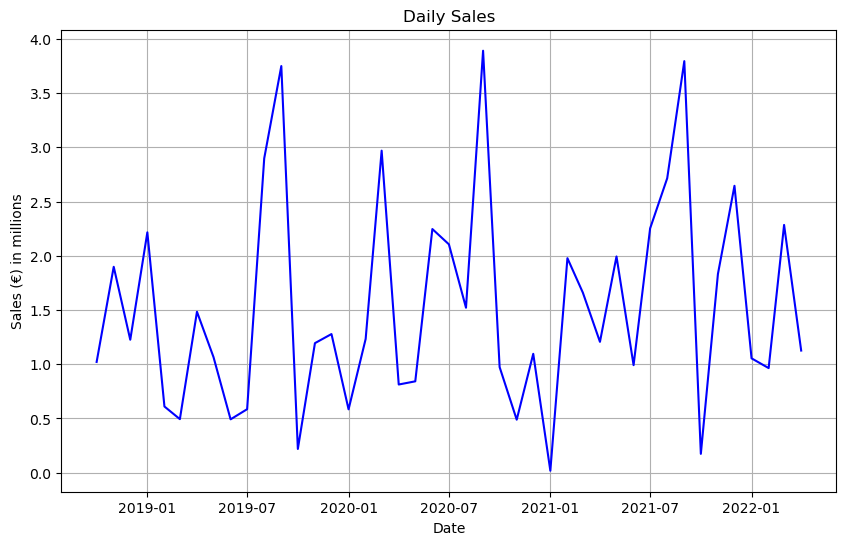

In [92]:
explore_time_series(sales_p11)

**PRODUCT #12**

First few rows of the dataset:


,Europe Shipments Index M&E LAG12,UK Production Index M&E LAG9,Switzerland Production Index Machinery eq. LAG7,Switzerland Production Index Electrical eq. LAG7,Germany Shipments Index M&E LAG9,Japan Production Index M&E LAG9,COVID_Impact,Price of Energy LAG10,China Production Index M&E LAG5,France Production Index Electrical eq. LAG12,US Producer Prices Electrical eq. LAG8,Japan Production Index Electrical eq. LAG9,Switzerland Production Index M&E LAG7,Sales € LAG6,Italy Production Index Electrical eq. LAG1,China Producer Prices Electrical eq. LAG11,Germany Production Index M&E LAG9,Sales €,Europe Production Index M&E LAG9,France Producer Prices Electrical eq. LAG7,Sales € LAG3,Sales € LAG2
Full_Date,,,,,,,,,,,,,,,,,,,,,,
2019-04-01,132.2500,111.1250,102.1875,104.8125,148.000,126.9375,0,94.6250,212.000,94.6875,110.0000,118.750,103.1875,28686.330078,83.4375,95.5625,126.9375,21813.269531,124.1250,102.5000,21484.000000,34214.738281
2019-05-01,116.9375,106.0625,102.8125,111.1875,129.875,123.1875,0,93.6875,220.500,83.9375,110.1250,116.500,105.9375,1070.000000,88.8125,96.6250,116.7500,24468.000000,114.0625,102.1875,34214.738281,10118.000000
2019-06-01,122.1250,103.6875,106.8125,113.0000,130.000,115.1875,0,93.0000,241.875,81.8125,110.3750,103.000,109.0625,17880.599609,75.9375,97.0000,114.6875,44255.679688,100.6875,102.0625,10118.000000,21813.269531
2019-07-01,136.5000,108.3125,110.8125,114.7500,136.625,127.8125,0,92.0000,175.625,95.1250,110.6875,114.500,112.2500,21484.000000,91.6250,97.0625,118.5625,21318.480469,117.0000,102.0625,21813.269531,24468.000000
2019-08-01,120.4375,113.6875,114.7500,116.5000,137.750,125.1875,0,98.7500,175.625,86.3750,111.0000,112.375,115.3750,34214.738281,83.5000,96.7500,124.2500,19217.000000,124.3750,102.1875,24468.000000,44255.679688



Last few rows of the dataset:


,Europe Shipments Index M&E LAG12,UK Production Index M&E LAG9,Switzerland Production Index Machinery eq. LAG7,Switzerland Production Index Electrical eq. LAG7,Germany Shipments Index M&E LAG9,Japan Production Index M&E LAG9,COVID_Impact,Price of Energy LAG10,China Production Index M&E LAG5,France Production Index Electrical eq. LAG12,US Producer Prices Electrical eq. LAG8,Japan Production Index Electrical eq. LAG9,Switzerland Production Index M&E LAG7,Sales € LAG6,Italy Production Index Electrical eq. LAG1,China Producer Prices Electrical eq. LAG11,Germany Production Index M&E LAG9,Sales €,Europe Production Index M&E LAG9,France Producer Prices Electrical eq. LAG7,Sales € LAG3,Sales € LAG2
Full_Date,,,,,,,,,,,,,,,,,,,,,,
2021-12-01,129.5000,98.9375,87.0625,92.6250,117.6875,112.0625,1,69.8750,321.75,83.8750,115.6875,103.4375,89.1250,326883.3125,91.1875,91.6250,102.5000,322647.81250,107.9375,104.6250,423432.6875,217388.43750
2022-01-01,136.7500,125.1875,89.5000,89.1250,147.2500,143.3750,1,80.3750,264.00,75.7500,117.2500,134.6250,89.3750,363685.4375,89.0000,92.0000,123.5625,147680.18750,129.6250,104.8125,217388.4375,428753.93750
2022-02-01,105.7500,104.6250,91.9375,85.5625,125.1875,116.1875,1,80.7500,253.75,76.1875,118.8125,108.1875,89.6250,143436.6250,72.9375,92.2500,108.0000,312165.53125,114.1250,105.5625,428753.9375,322647.81250
2022-03-01,119.1875,103.0625,94.3750,91.4375,122.5625,102.8125,1,80.8125,259.00,80.7500,120.7500,96.7500,93.3125,423432.6875,74.3750,92.8125,102.8750,343523.40625,112.0625,105.8125,322647.8125,147680.18750
2022-04-01,147.1250,116.7500,96.7500,97.3125,139.0000,128.8750,1,86.3125,269.75,94.5000,121.8750,119.9375,96.9375,217388.4375,91.1875,92.9375,115.5625,178141.00000,125.1250,106.6250,147680.1875,312165.53125



Number of Features: 22
Features: ['Europe Shipments Index M&E LAG12', 'UK Production Index M&E LAG9', 'Switzerland Production Index Machinery eq. LAG7', 'Switzerland Production Index Electrical eq. LAG7', 'Germany Shipments Index M&E LAG9', 'Japan Production Index M&E LAG9', 'COVID_Impact', 'Price of Energy LAG10', 'China Production Index M&E LAG5', 'France Production Index Electrical eq. LAG12', 'US Producer Prices Electrical eq. LAG8', 'Japan Production Index Electrical eq. LAG9', 'Switzerland Production Index M&E LAG7', 'Sales € LAG6', 'Italy Production Index Electrical eq. LAG1', 'China Producer Prices Electrical eq. LAG11', 'Germany Production Index M&E LAG9', 'Sales €', 'Europe Production Index M&E LAG9', 'France Producer Prices Electrical eq. LAG7', 'Sales € LAG3', 'Sales € LAG2']

Summary statistics of sales data:


,Europe Shipments Index M&E LAG12,UK Production Index M&E LAG9,Switzerland Production Index Machinery eq. LAG7,Switzerland Production Index Electrical eq. LAG7,Germany Shipments Index M&E LAG9,Japan Production Index M&E LAG9,COVID_Impact,Price of Energy LAG10,China Production Index M&E LAG5,France Production Index Electrical eq. LAG12,US Producer Prices Electrical eq. LAG8,Japan Production Index Electrical eq. LAG9,Switzerland Production Index M&E LAG7,Sales € LAG6,Italy Production Index Electrical eq. LAG1,China Producer Prices Electrical eq. LAG11,Germany Production Index M&E LAG9,Sales €,Europe Production Index M&E LAG9,France Producer Prices Electrical eq. LAG7,Sales € LAG3,Sales € LAG2
count,37.000000,37.000000,37.000000,37.00000,37.0000,37.000000,37.000000,37.00000,37.0000,37.000000,37.000000,37.0000,37.000000,37.000000,37.000000,37.000000,37.000000,37.000000,37.0000,37.000000,37.000000,37.000000
mean,121.500000,103.000000,93.750000,100.93750,126.8125,113.000000,0.675676,73.00000,240.6250,81.312500,112.562500,105.8125,96.375000,176934.444151,80.125000,93.812500,109.812500,220703.584882,111.0000,103.125000,199946.471389,207802.728991
std,12.953125,12.382812,9.289062,10.28125,13.0625,13.835938,0.474579,17.21875,42.1875,11.523438,2.816406,12.3125,8.820312,140844.578781,15.992188,1.879883,11.171875,131680.734071,11.3125,1.103516,139626.772410,137467.518928
min,83.750000,61.062500,77.937500,77.56250,93.3125,82.000000,0.000000,31.62500,130.5000,44.843750,110.000000,78.5625,77.812500,1070.000000,38.968750,90.312500,81.062500,5395.000000,77.5625,102.062500,5395.000000,5395.000000
25%,113.625000,98.937500,86.312500,92.62500,121.1250,104.250000,0.000000,63.75000,217.0000,78.062500,111.062500,98.6875,89.625000,28686.330078,74.375000,92.250000,103.687500,140819.687500,106.5000,102.500000,79632.000000,92754.007812
50%,122.437500,103.687500,94.437500,101.25000,128.8750,112.062500,1.000000,76.31250,243.8750,83.875000,111.437500,103.4375,96.125000,164108.203125,85.062500,93.875000,112.250000,213315.312500,113.5000,102.750000,172712.875000,185833.890625
75%,131.000000,110.625000,99.000000,110.37500,135.8750,123.000000,1.000000,84.43750,263.0000,88.250000,112.812500,112.5000,103.437500,292490.406250,91.625000,95.000000,116.875000,324443.343750,117.8750,103.187500,322647.812500,322647.812500
max,147.125000,125.187500,114.750000,116.50000,148.0000,143.375000,1.000000,100.25000,321.7500,97.875000,121.875000,134.6250,115.375000,445648.062500,102.187500,97.062500,127.375000,445648.062500,129.6250,106.625000,445648.062500,445648.062500


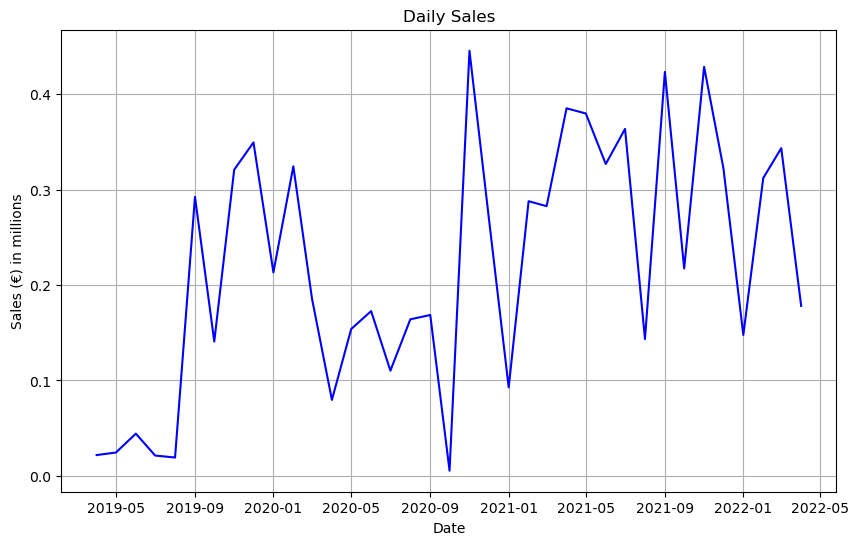

In [93]:
explore_time_series(sales_p12)

**PRODUCT #13**

First few rows of the dataset:


,Japan Production Index M&E LAG11,Sales € LAG2,Germany Production Index M&E LAG12,China Production Index M&E LAG1,France Shipments Index M&E LAG3,Switzerland Production Index Electrical eq. LAG11,Sales €,Global Production Index Machinery eq. LAG3,France Producer Prices Electrical eq. LAG9,Europe Shipments Index M&E LAG3,United States: EUR in LCU LAG7
Full_Date,,,,,,,,,,,
2018-12-01,127.2500,27666.099609,130.8750,212.000,92.8125,117.5625,15655.179688,118.8750,102.2500,112.3125,1.227539
2019-01-01,112.4375,68180.000000,130.1250,220.500,110.5000,112.0625,27198.289062,128.5000,102.3750,127.6875,1.181641
2019-02-01,119.8125,15655.179688,106.6250,241.875,122.4375,106.5625,32638.630859,131.3750,102.5000,131.0000,1.167969
2019-03-01,153.8750,27198.289062,109.3750,175.625,115.9375,101.0625,11890.000000,130.0000,102.2500,132.8750,1.168945
2019-04-01,115.5625,32638.630859,125.9375,175.625,115.1250,98.0625,7488.540039,124.1875,102.5625,131.2500,1.155273



Last few rows of the dataset:


,Japan Production Index M&E LAG11,Sales € LAG2,Germany Production Index M&E LAG12,China Production Index M&E LAG1,France Shipments Index M&E LAG3,Switzerland Production Index Electrical eq. LAG11,Sales €,Global Production Index Machinery eq. LAG3,France Producer Prices Electrical eq. LAG9,Europe Shipments Index M&E LAG3,United States: EUR in LCU LAG7
Full_Date,,,,,,,,,,,
2021-12-01,116.5000,30506.150391,112.2500,269.75,90.6250,111.5000,24868.859375,119.875,104.0000,110.6875,1.198242
2022-01-01,102.5000,8136.919922,112.7500,291.50,118.1875,106.3750,37972.808594,135.625,104.5000,142.7500,1.214844
2022-02-01,112.0625,24868.859375,90.6250,310.75,116.8750,101.2500,33449.250000,130.375,104.6250,132.0000,1.205078
2022-03-01,143.3750,37972.808594,102.5000,236.00,116.3750,96.1875,12149.400391,135.000,104.8125,143.0000,1.182617
2022-04-01,116.1875,33449.250000,123.5625,236.00,134.6250,92.6250,17020.039062,134.625,105.5625,150.0000,1.176758



Number of Features: 11
Features: ['Japan Production Index M&E LAG11', 'Sales € LAG2', 'Germany Production Index M&E LAG12', 'China Production Index M&E LAG1', 'France Shipments Index M&E LAG3', 'Switzerland Production Index Electrical eq. LAG11', 'Sales €', 'Global Production Index Machinery eq. LAG3', 'France Producer Prices Electrical eq. LAG9', 'Europe Shipments Index M&E LAG3', 'United States: EUR in LCU LAG7']

Summary statistics of sales data:


,Japan Production Index M&E LAG11,Sales € LAG2,Germany Production Index M&E LAG12,China Production Index M&E LAG1,France Shipments Index M&E LAG3,Switzerland Production Index Electrical eq. LAG11,Sales €,Global Production Index Machinery eq. LAG3,France Producer Prices Electrical eq. LAG9,Europe Shipments Index M&E LAG3,United States: EUR in LCU LAG7
count,41.00000,41.000000,41.0000,41.00000,41.000000,41.000000,41.000000,41.00000,41.00000,41.000000,41.000000
mean,114.56250,23902.133438,111.3125,243.37500,109.437500,102.250000,22275.873434,122.56250,102.81250,123.687500,1.151367
std,14.46875,16404.106458,11.6875,42.21875,14.664062,9.765625,14888.038664,10.28125,0.79248,14.195312,0.040527
min,82.00000,2550.310059,81.0625,130.50000,64.437500,77.562500,2550.310059,98.68750,102.06250,83.750000,1.085938
25%,105.31250,10118.360352,104.7500,219.62500,103.000000,95.562500,10118.360352,116.62500,102.50000,113.625000,1.118164
50%,115.18750,22497.599609,112.7500,243.87500,111.687500,102.875000,19601.050781,123.62500,102.68750,126.625000,1.146484
75%,123.00000,31216.710938,117.9375,264.00000,118.187500,111.187500,30716.109375,129.37500,103.00000,131.500000,1.182617
max,153.87500,68180.000000,130.8750,321.75000,135.625000,117.562500,65754.546875,143.00000,105.56250,150.000000,1.227539


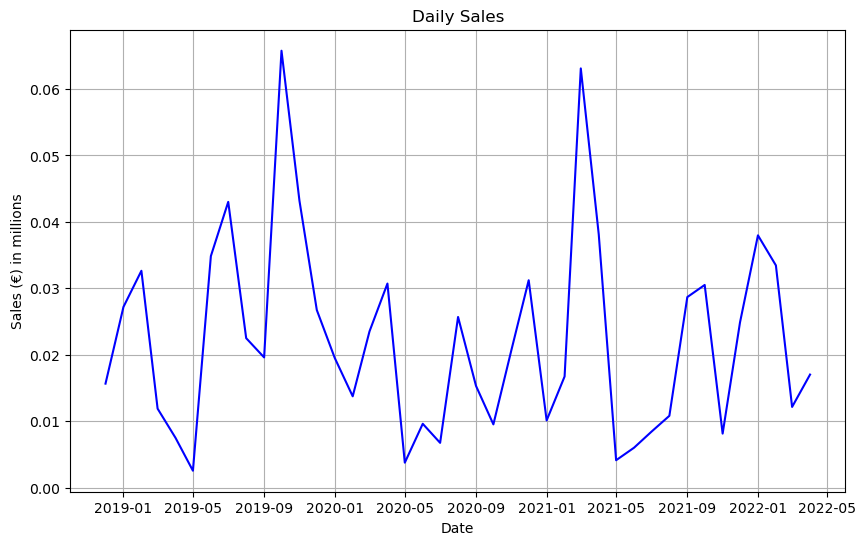

In [94]:
explore_time_series(sales_p13)

**PRODUCT #14**

First few rows of the dataset:


,Global Production Index Electrical eq. LAG7,UK Production Index Electrical eq. LAG1,France Production Index M&E LAG7,Europe Production Index M&E LAG7,US Production Index M&E LAG8,Germany Production Index Electrical eq. LAG3,Sales €,Italy Shipments Index M&E LAG11,Italy Production Index Electrical eq. LAG7,France Producer Prices Electrical eq. LAG12,Italy Production Index M&E LAG11,Sales € LAG2,France Production Index Electrical eq. LAG7
Full_Date,,,,,,,,,,,,,
2018-12-01,117.6875,118.6875,92.2500,110.6250,109.0625,111.3125,0.000000,131.6250,76.75000,101.375,88.9375,5770.000000,83.9375
2019-01-01,119.0000,120.4375,88.5000,114.3125,111.6250,110.8750,1686.400024,86.4375,89.81250,101.375,96.1875,17130.000000,81.8125
2019-02-01,126.3125,105.3750,109.7500,124.1250,110.0000,118.3125,19196.300781,100.5000,89.43750,102.250,103.2500,0.000000,95.1250
2019-03-01,121.9375,107.1875,100.8125,114.0625,112.6875,117.1875,7535.250000,120.2500,90.81250,102.250,116.1250,1686.400024,86.3750
2019-04-01,117.5000,110.6250,68.2500,100.6875,106.5625,89.6250,0.000000,102.8750,46.90625,102.375,101.2500,19196.300781,64.3125



Last few rows of the dataset:


,Global Production Index Electrical eq. LAG7,UK Production Index Electrical eq. LAG1,France Production Index M&E LAG7,Europe Production Index M&E LAG7,US Production Index M&E LAG8,Germany Production Index Electrical eq. LAG3,Sales €,Italy Shipments Index M&E LAG11,Italy Production Index Electrical eq. LAG7,France Producer Prices Electrical eq. LAG12,Italy Production Index M&E LAG11,Sales € LAG2,France Production Index Electrical eq. LAG7
Full_Date,,,,,,,,,,,,,
2021-12-01,133.625,117.8125,93.50000,114.1250,112.1875,103.4375,17427.599609,132.2500,91.62500,103.0625,88.3125,16534.199219,83.0625
2022-01-01,128.500,127.0625,86.43750,112.0625,112.5625,111.6875,2820.000000,92.8750,94.31250,103.1875,89.6250,5951.850098,75.8125
2022-02-01,141.000,121.0625,107.25000,125.1250,112.1875,106.2500,4410.000000,107.8125,95.56250,103.6250,103.6875,17427.599609,94.0625
2022-03-01,134.250,112.3125,95.31250,116.1875,112.8125,110.0625,46100.238281,134.2500,93.75000,104.0000,117.8125,2820.000000,82.0000
2022-04-01,125.750,115.5625,63.84375,98.2500,107.9375,97.7500,1846.199951,116.7500,49.03125,104.5000,109.5000,4410.000000,61.3750



Number of Features: 13
Features: ['Global Production Index Electrical eq. LAG7', 'UK Production Index Electrical eq. LAG1', 'France Production Index M&E LAG7', 'Europe Production Index M&E LAG7', 'US Production Index M&E LAG8', 'Germany Production Index Electrical eq. LAG3', 'Sales €', 'Italy Shipments Index M&E LAG11', 'Italy Production Index Electrical eq. LAG7', 'France Producer Prices Electrical eq. LAG12', 'Italy Production Index M&E LAG11', 'Sales € LAG2', 'France Production Index Electrical eq. LAG7']

Summary statistics of sales data:


,Global Production Index Electrical eq. LAG7,UK Production Index Electrical eq. LAG1,France Production Index M&E LAG7,Europe Production Index M&E LAG7,US Production Index M&E LAG8,Germany Production Index Electrical eq. LAG3,Sales €,Italy Shipments Index M&E LAG11,Italy Production Index Electrical eq. LAG7,France Producer Prices Electrical eq. LAG12,Italy Production Index M&E LAG11,Sales € LAG2,France Production Index Electrical eq. LAG7
count,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.000000,41.00000,41.000000,41.000000
mean,123.312500,117.875000,90.812500,110.937500,106.625000,102.812500,11485.903889,109.437500,79.375000,102.625000,98.68750,10875.015152,80.750000
std,9.546875,11.367188,13.953125,10.960938,5.324219,9.460938,16465.243903,19.359375,16.140625,0.577637,17.90625,15493.806041,11.382812
min,103.500000,77.937500,50.750000,77.562500,90.562500,81.062500,-2851.449951,55.125000,38.968750,101.375000,50.62500,-2851.449951,44.843750
25%,117.500000,112.937500,88.500000,106.500000,104.187500,97.750000,1846.199951,100.437500,75.250000,102.250000,89.62500,2183.850098,76.187500
50%,125.187500,117.812500,94.000000,113.500000,107.687500,105.000000,5951.850098,116.750000,84.125000,102.562500,103.25000,5951.850098,82.437500
75%,129.250000,125.625000,99.625000,117.000000,110.875000,108.062500,14793.000000,122.437500,90.812500,102.875000,109.50000,14793.000000,87.437500
max,145.625000,140.750000,109.750000,129.625000,112.812500,119.875000,76161.437500,135.750000,102.187500,104.500000,118.37500,76161.437500,97.875000


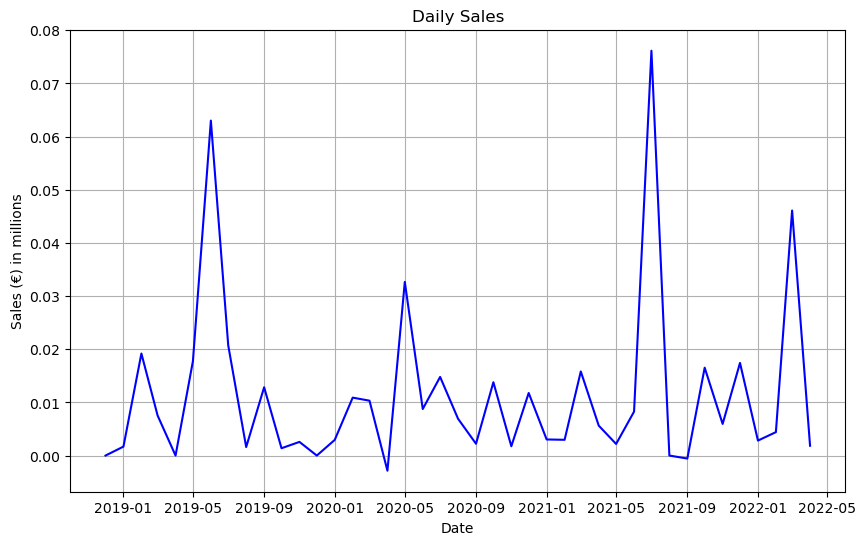

In [95]:
explore_time_series(sales_p14)

**PRODUCT #16**

First few rows of the dataset:


,Switzerland Production Index M&E LAG9,Price of Energy LAG11,US Production Index M&E LAG4,Germany Production Index Electrical eq. LAG11,Sales €,Switzerland Production Index Machinery eq. LAG10,Japan Production Index Electrical eq. LAG5,Italy Production Index M&E LAG7,France Producer Prices Electrical eq. LAG10,France Production Index Electrical eq. LAG1,Europe Shipments Index M&E LAG3,China Producer Prices Electrical eq. LAG12,US Producer Prices Electrical eq. LAG11,Global Production Index Electrical eq. LAG6
Full_Date,,,,,,,,,,,,,,
2018-10-01,112.3125,73.2500,110.0000,106.9375,3.331969e+05,106.0000,108.3125,103.250,101.375,64.3125,136.5000,97.2500,105.6250,128.1250
2018-11-01,107.8125,78.9375,112.6875,121.5000,1.377694e+06,109.3125,107.0625,116.125,101.375,85.0625,120.4375,97.3750,106.0000,117.6875
2018-12-01,103.3125,80.8125,106.5625,98.6250,4.762524e+06,105.3750,118.7500,101.250,102.250,97.8750,112.3125,96.6250,106.1250,119.0000
2019-01-01,98.8125,87.4375,110.8125,110.3750,9.429572e+05,101.4375,116.5000,118.250,102.250,91.1250,127.6875,96.4375,106.4375,126.3125
2019-02-01,98.4375,82.1250,111.0000,107.2500,2.577650e+05,97.5000,103.0000,115.250,102.375,78.0625,131.0000,96.6875,106.7500,121.9375



Last few rows of the dataset:


,Switzerland Production Index M&E LAG9,Price of Energy LAG11,US Production Index M&E LAG4,Germany Production Index Electrical eq. LAG11,Sales €,Switzerland Production Index Machinery eq. LAG10,Japan Production Index Electrical eq. LAG5,Italy Production Index M&E LAG7,France Producer Prices Electrical eq. LAG10,France Production Index Electrical eq. LAG1,Europe Shipments Index M&E LAG3,China Producer Prices Electrical eq. LAG12,US Producer Prices Electrical eq. LAG11,Global Production Index Electrical eq. LAG6
Full_Date,,,,,,,,,,,,,,
2021-12-01,91.4375,63.7500,107.9375,91.2500,271111.375000,86.7500,119.9375,109.50000,103.6250,88.7500,110.6875,91.1250,113.5625,128.50
2022-01-01,88.8750,69.8750,110.1250,93.3125,91021.890625,85.6875,110.6250,111.93750,104.0000,88.3125,142.7500,91.6250,113.3750,141.00
2022-02-01,89.1250,80.3750,109.1875,103.4375,45696.761719,84.6250,85.6875,111.87500,104.5000,80.7500,132.0000,92.0000,113.8125,134.25
2022-03-01,89.3750,80.7500,111.5625,119.8750,98729.906250,87.0625,107.3125,113.56250,104.6250,77.9375,143.0000,92.2500,115.6875,125.75
2022-04-01,89.6250,80.8125,109.6250,105.5000,134071.234375,89.5000,98.8750,61.34375,104.8125,79.0000,150.0000,92.8125,117.2500,141.75



Number of Features: 14
Features: ['Switzerland Production Index M&E LAG9', 'Price of Energy LAG11', 'US Production Index M&E LAG4', 'Germany Production Index Electrical eq. LAG11', 'Sales €', 'Switzerland Production Index Machinery eq. LAG10', 'Japan Production Index Electrical eq. LAG5', 'Italy Production Index M&E LAG7', 'France Producer Prices Electrical eq. LAG10', 'France Production Index Electrical eq. LAG1', 'Europe Shipments Index M&E LAG3', 'China Producer Prices Electrical eq. LAG12', 'US Producer Prices Electrical eq. LAG11', 'Global Production Index Electrical eq. LAG6']

Summary statistics of sales data:


,Switzerland Production Index M&E LAG9,Price of Energy LAG11,US Production Index M&E LAG4,Germany Production Index Electrical eq. LAG11,Sales €,Switzerland Production Index Machinery eq. LAG10,Japan Production Index Electrical eq. LAG5,Italy Production Index M&E LAG7,France Producer Prices Electrical eq. LAG10,France Production Index Electrical eq. LAG1,Europe Shipments Index M&E LAG3,China Producer Prices Electrical eq. LAG12,US Producer Prices Electrical eq. LAG11,Global Production Index Electrical eq. LAG6
count,43.000000,43.00000,43.000000,43.000000,4.300000e+01,43.00000,43.000000,43.000000,43.000000,43.00000,43.00000,43.000000,43.000000,43.00000
mean,97.500000,74.12500,106.812500,103.937500,4.277018e+05,95.56250,105.375000,99.062500,102.687500,80.62500,124.00000,94.250000,110.875000,123.93750
std,8.726562,16.31250,5.238281,10.007812,7.824899e+05,9.43750,11.890625,18.703125,0.719727,11.06250,14.00000,2.060547,2.423828,9.75000
min,77.812500,31.62500,90.562500,81.062500,4.036008e+04,77.93750,78.562500,50.625000,101.375000,44.84375,83.75000,90.312500,105.625000,103.50000
25%,90.875000,68.09375,104.281250,98.656250,1.375541e+05,86.90625,98.781250,92.156250,102.250000,77.06250,115.65625,92.312500,110.250000,117.59375
50%,97.937500,77.06250,107.750000,106.312500,2.245019e+05,98.06250,104.250000,103.687500,102.687500,82.00000,126.62500,94.625000,111.312500,125.62500
75%,103.625000,83.62500,110.843750,109.750000,3.283725e+05,101.50000,112.312500,112.750000,102.937500,88.28125,131.75000,96.375000,111.718750,129.31250
max,115.375000,100.25000,112.812500,121.500000,4.762524e+06,114.75000,134.625000,118.375000,104.812500,97.87500,150.00000,97.375000,117.250000,145.62500


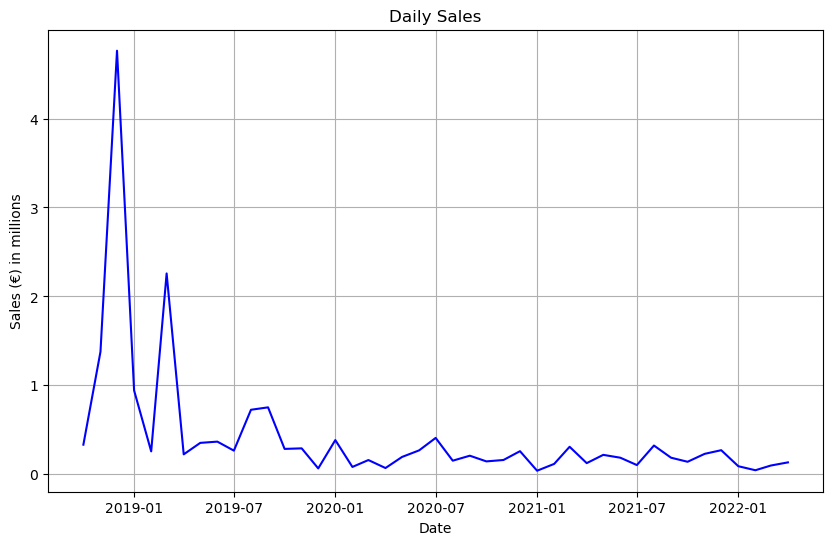

In [96]:
explore_time_series(sales_p16)

**PRODUCT #20**

First few rows of the dataset:


,Switzerland Production Index Electrical eq. LAG1,US Production Index M&E LAG2,Germany Production Index M&E LAG1,Europe Shipments Index M&E LAG1,France Production Index Electrical eq. LAG2,Price of Natural gas index LAG12,Germany Shipments Index M&E LAG1,Japan Production Index M&E LAG1,France Shipments Index M&E LAG7,Sales € LAG4,UK Production Index Electrical eq. LAG3,Sales €,Europe Production Index M&E LAG1,United States: EUR in LCU LAG1,US Producer Prices Electrical eq. LAG11
Full_Date,,,,,,,,,,,,,,,
2019-02-01,116.5000,110.8750,120.5000,131.2500,91.1250,84.8125,141.3750,123.0000,127.1250,4563.140137,118.6875,620.659973,113.8750,1.138672,106.7500
2019-03-01,110.3750,106.2500,104.7500,113.0625,78.0625,71.0000,118.6875,105.5000,104.7500,5798.140137,120.4375,3369.550049,106.4375,1.141602,107.5625
2019-04-01,104.1875,107.5000,109.6250,117.6875,81.9375,71.4375,122.6875,114.4375,92.8125,918.650024,105.3750,3619.629883,110.4375,1.134766,108.0000
2019-05-01,98.0625,109.8125,122.5625,135.8750,80.3125,73.5000,140.1250,141.6250,110.5000,2398.040039,107.1875,938.900024,123.6875,1.129883,108.5625
2019-06-01,95.5625,111.6875,110.6250,121.9375,92.5000,76.5000,127.5000,107.1250,122.4375,620.659973,110.6250,772.940002,111.9375,1.124023,108.7500



Last few rows of the dataset:


,Switzerland Production Index Electrical eq. LAG1,US Production Index M&E LAG2,Germany Production Index M&E LAG1,Europe Shipments Index M&E LAG1,France Production Index Electrical eq. LAG2,Price of Natural gas index LAG12,Germany Shipments Index M&E LAG1,Japan Production Index M&E LAG1,France Shipments Index M&E LAG7,Sales € LAG4,UK Production Index Electrical eq. LAG3,Sales €,Europe Production Index M&E LAG1,United States: EUR in LCU LAG1,US Producer Prices Electrical eq. LAG11
Full_Date,,,,,,,,,,,,,,,
2021-12-01,106.8750,109.1875,108.4375,132.0000,89.5625,59.06250,129.500,114.0000,115.1875,377.220001,116.3750,156.000000,117.3125,1.160156,113.5625
2022-01-01,110.6250,111.5625,115.9375,143.0000,88.7500,63.84375,141.750,121.8125,103.0000,0.000000,130.5000,0.000000,124.0000,1.141602,113.3750
2022-02-01,114.3125,109.6250,118.1250,150.0000,88.3125,73.00000,149.375,127.7500,135.6250,151.490005,117.8125,589.500000,123.0625,1.130859,113.8125
2022-03-01,109.0000,107.0625,94.5625,120.3125,80.7500,97.50000,120.375,110.4375,101.0000,928.799988,127.0625,2885.080078,103.1875,1.131836,115.6875
2022-04-01,103.6875,111.0625,104.0000,131.5000,77.9375,65.62500,129.375,117.8750,90.6250,156.000000,121.0625,6280.629883,113.5000,1.133789,117.2500



Number of Features: 15
Features: ['Switzerland Production Index Electrical eq. LAG1', 'US Production Index M&E LAG2', 'Germany Production Index M&E LAG1', 'Europe Shipments Index M&E LAG1', 'France Production Index Electrical eq. LAG2', 'Price of Natural gas index LAG12', 'Germany Shipments Index M&E LAG1', 'Japan Production Index M&E LAG1', 'France Shipments Index M&E LAG7', 'Sales € LAG4', 'UK Production Index Electrical eq. LAG3', 'Sales €', 'Europe Production Index M&E LAG1', 'United States: EUR in LCU LAG1', 'US Producer Prices Electrical eq. LAG11']

Summary statistics of sales data:


,Switzerland Production Index Electrical eq. LAG1,US Production Index M&E LAG2,Germany Production Index M&E LAG1,Europe Shipments Index M&E LAG1,France Production Index Electrical eq. LAG2,Price of Natural gas index LAG12,Germany Shipments Index M&E LAG1,Japan Production Index M&E LAG1,France Shipments Index M&E LAG7,Sales € LAG4,UK Production Index Electrical eq. LAG3,Sales €,Europe Production Index M&E LAG1,United States: EUR in LCU LAG1,US Producer Prices Electrical eq. LAG11
count,39.000000,39.000000,39.0000,39.00000,39.000000,39.000000,39.000000,39.000000,39.00000,39.000000,39.00000,39.000000,39.000000,39.000000,39.000000
mean,101.000000,106.375000,107.6875,123.56250,80.500000,64.125000,126.375000,112.312500,108.50000,1758.247429,118.06250,1657.663830,111.000000,1.147461,111.375000
std,9.914062,5.277344,10.0625,14.37500,10.945312,17.765625,12.882812,13.257812,14.59375,2280.940341,11.62500,2283.719816,11.195312,0.039459,1.952148
min,77.562500,90.562500,81.0625,83.75000,44.843750,34.000000,93.312500,82.000000,64.43750,0.000000,77.93750,0.000000,77.562500,1.085938,106.750000
25%,92.812500,103.812500,102.9375,115.65625,77.062500,52.281250,119.718750,103.875000,102.00000,330.809998,113.21875,279.654999,106.468750,1.115234,110.656250
50%,102.875000,107.500000,109.0000,126.50000,82.000000,63.468750,128.750000,110.437500,110.50000,842.929993,118.68750,772.940002,113.500000,1.134766,111.375000
75%,109.625000,110.093750,115.3125,131.50000,88.281250,77.000000,135.500000,119.656250,117.84375,2222.869995,125.90625,1907.149963,117.593750,1.181152,111.875000
max,116.500000,112.812500,123.5625,150.00000,94.750000,97.500000,149.375000,143.375000,135.62500,8485.599609,140.75000,8485.599609,129.625000,1.216797,117.250000


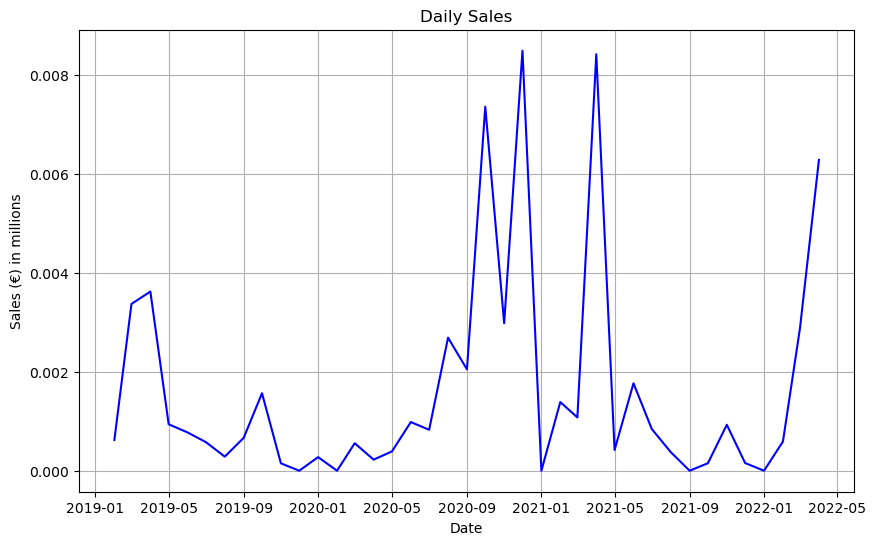

In [97]:
explore_time_series(sales_p20)

**PRODUCT #36**

First few rows of the dataset:


,UK Production Index M&E LAG3,France Production Index M&E LAG3,US Production Index Electrical eq. LAG11,Italy Production Index M&E LAG1,Germany Production Index Electrical eq. LAG11,US Shipments Index M&E LAG4,Sales €,Japan Production Index Electrical eq. LAG3,Europe Shipments Index M&E LAG5,Italy Shipments Index M&E LAG8,Price of Energy LAG5
Full_Date,,,,,,,,,,,
2018-10-01,111.1250,109.7500,110.0000,60.7500,106.9375,126.25,6474.600098,118.750,116.9375,86.4375,88.3750
2018-11-01,106.0625,100.8125,109.6250,105.4375,121.5000,133.75,21617.609375,116.500,122.1250,100.5000,94.6250
2018-12-01,103.6875,68.2500,105.7500,118.3750,98.6250,117.75,13924.519531,103.000,136.5000,120.2500,93.6875
2019-01-01,108.3125,97.6250,106.8125,107.7500,110.3750,128.25,15444.389648,114.500,120.4375,102.8750,93.0000
2019-02-01,113.6875,108.2500,107.9375,88.8125,107.2500,126.00,8051.149902,112.375,112.3125,120.6250,92.0000



Last few rows of the dataset:


,UK Production Index M&E LAG3,France Production Index M&E LAG3,US Production Index Electrical eq. LAG11,Italy Production Index M&E LAG1,Germany Production Index Electrical eq. LAG11,US Shipments Index M&E LAG4,Sales €,Japan Production Index Electrical eq. LAG3,Europe Shipments Index M&E LAG5,Italy Shipments Index M&E LAG8,Price of Energy LAG5
Full_Date,,,,,,,,,,,
2021-12-01,99.3125,63.84375,105.6250,108.1250,91.2500,133.625,48933.500000,85.6875,144.3750,134.250,93.9375
2022-01-01,115.8125,101.87500,109.0000,111.3750,93.3125,141.875,6014.390137,107.3125,128.8750,116.750,98.3125
2022-02-01,99.1250,97.37500,107.4375,94.0000,103.4375,147.500,29869.500000,98.8750,110.6875,127.375,96.3125
2022-03-01,109.8750,94.31250,110.0000,86.8750,119.8750,141.625,2564.850098,104.3750,142.7500,134.875,107.1875
2022-04-01,101.2500,100.56250,110.6250,106.5625,105.5000,134.250,17029.470703,109.0000,132.0000,131.000,123.3750



Number of Features: 11
Features: ['UK Production Index M&E LAG3', 'France Production Index M&E LAG3', 'US Production Index Electrical eq. LAG11', 'Italy Production Index M&E LAG1', 'Germany Production Index Electrical eq. LAG11', 'US Shipments Index M&E LAG4', 'Sales €', 'Japan Production Index Electrical eq. LAG3', 'Europe Shipments Index M&E LAG5', 'Italy Shipments Index M&E LAG8', 'Price of Energy LAG5']

Summary statistics of sales data:


,UK Production Index M&E LAG3,France Production Index M&E LAG3,US Production Index Electrical eq. LAG11,Italy Production Index M&E LAG1,Germany Production Index Electrical eq. LAG11,US Shipments Index M&E LAG4,Sales €,Japan Production Index Electrical eq. LAG3,Europe Shipments Index M&E LAG5,Italy Shipments Index M&E LAG8,Price of Energy LAG5
count,43.00000,43.000000,43.000000,43.00000,43.000000,43.000000,43.000000,43.000000,43.000000,43.00000,43.00000
mean,103.37500,91.562500,108.000000,97.87500,103.937500,126.125000,23223.579658,105.312500,122.687500,110.50000,76.93750
std,11.71875,13.828125,3.892578,18.28125,10.007812,10.015625,42651.285011,11.890625,13.070312,19.43750,19.25000
min,61.06250,50.750000,97.625000,50.62500,81.062500,108.750000,674.000000,78.562500,83.750000,55.12500,31.62500
25%,99.21875,89.468750,107.375000,89.21875,98.656250,117.718750,6244.495117,98.781250,115.281250,100.46875,68.09375
50%,103.68750,94.562500,109.000000,103.68750,106.312500,126.187500,12377.769531,104.250000,125.937500,118.31250,79.06250
75%,110.25000,100.062500,110.375000,110.43750,109.750000,133.437500,21995.049805,112.312500,131.125000,122.84375,90.18750
max,125.18750,109.750000,113.125000,118.37500,121.500000,148.625000,253519.046875,134.625000,147.125000,135.75000,123.37500


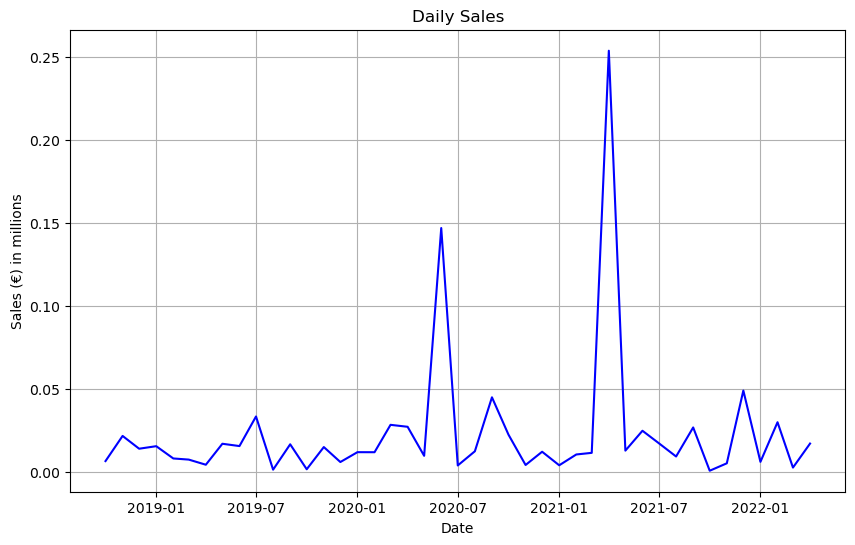

In [98]:
explore_time_series(sales_p36)

<a class="anchor" id="5">
    
# 5. Export Datasets
    
    
</a>

In [99]:
sales_p1.to_csv('sales_p1.csv', index=True)

sales_p3.to_csv('sales_p3.csv', index=True)

sales_p4.to_csv('sales_p4.csv', index=True)

sales_p5.to_csv('sales_p5.csv', index=True)

sales_p6.to_csv('sales_p6.csv', index=True)

sales_p8.to_csv('sales_p8.csv', index=True)

sales_p9.to_csv('sales_p9.csv', index=True)

sales_p11.to_csv('sales_p11.csv', index=True)

sales_p12.to_csv('sales_p12.csv', index=True)

sales_p13.to_csv('sales_p13.csv', index=True)

sales_p14.to_csv('sales_p14.csv', index=True)

sales_p16.to_csv('sales_p16.csv', index=True)

sales_p20.to_csv('sales_p20.csv', index=True)

sales_p36.to_csv('sales_p36.csv', index=True)

